In [1]:
import importlib
import time
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from scipy import ndimage
from scipy import integrate
from scipy import interpolate

In [2]:
from multi_loc import covariance, assimilate, utilities

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/sklearn/utils/__init__.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  from collections import Sequence


In [3]:
%matplotlib inline

In [4]:
def imshow(X, title=None, vmin=None, vmax=None, cmap=None):
    plt.figure()
    im = plt.imshow(X, vmin=vmin, vmax=vmax, cmap=cmap)
    plt.colorbar(im)
    plt.title(title)

In [5]:
importlib.reload(assimilate)
importlib.reload(utilities)

<module 'multi_loc.utilities' from '/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py'>

In [6]:
N_Z = 960
K = 32
I = 12
F = float(15)
b = float(10)
c = float(2.5)
alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)

coarse = 8
N_Xcoar = N_Z//coarse
K_coar = K//coarse

N_eZ = 20
N_eX = 500

In [301]:
weights = np.abs(np.arange(-I, I + 1, dtype=float))
weights = alpha - beta * weights
weights[0] *= 1/2
weights[-1] *= 1/2

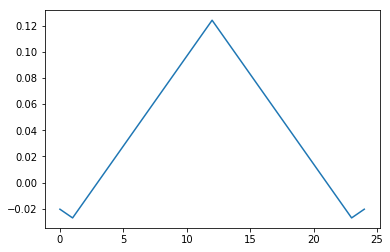

In [302]:
plt.figure()
plt.plot(weights)

In [7]:
def LM3(Z, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    X = window_sum_Z(Z, I=I, alpha=alpha, beta=beta)
    Y = Z - X
    
    T1 = bracket([X], K)
    T2 = b**2 * bracket([Y], 1)
    T3 = c * bracket([Y, X], 1)
    
    dZdt = T1 + T2 + T3 - X - b*Y + F
    return dZdt


def window_sum_Z(Z,*, I, alpha, beta):
    weights = np.abs(np.arange(-I, I + 1, dtype=float))
    weights = alpha - beta * weights
    weights[0] *= 1/2
    weights[-1] *= 1/2
    X = ndimage.convolve1d(Z, weights, mode='wrap', axis=0)
    return X


def bracket(XY, K):
    if len(XY) == 1:
        to_return = bracket_1(XY, K)
    else:
        to_return = bracket_2(XY, K)
    return to_return

        
def bracket_2(XY, K):
    """
    Only works for K=1 for now.
    """
    if K == 1:
        X, Y = XY
        T1 = -1 * np.roll(X, 2, axis=0) * np.roll(Y, 1, axis=0)
        T2 = np.roll(X, 1, axis=0) * np.roll(Y, -1, axis=0)
        return T1 + T2
    else:
        raise Exception('Currently only works for K=1')


def bracket_1(XY, K): 
    X = XY[0]
    if K == 1:
        T1 = -1 * np.roll(X, 2, axis=0) * np.roll(X, 1, axis=0)
        T2 = np.roll(X, 1, axis=0) * np.roll(X, -1, axis=0)
        return T1 + T2
    elif K%2 == 0:
        J = int(K/2)
        weights = np.ones(2 * J + 1)
        weights[0] *= 1/2
        weights[-1] *= 1/2
        weights /= K
    elif K%2 == 1:
        J = int((K - 1)/2)
        weights = np.ones(2 * J + 1)
        weights /= K
    W = ndimage.convolve1d(X, weights, mode='wrap', axis=0)
    T1 = -1 * np.roll(W, 2 * K, axis=0) * np.roll(W, K, axis=0)
    WX = np.roll(W, K, axis=0) * np.roll(X, -K, axis=0)
    T2 = ndimage.convolve1d(WX, weights, mode='wrap', axis=0)
    return T1 + T2

In [8]:
def return_LM3_data(Z0, t, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    N_Z = Z0.size
    def this_LM3(Z, t):
        dZdt = LM3(Z, K=K, I=I, F=F, b=b, c=c, alpha=alpha, beta=beta)
        return dZdt
    Z = integrate.odeint(this_LM3, Z0, t)
    Z = Z.T
    return Z

# Random initialization for X and Y

In [9]:
X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
X_interp = np.concatenate([X_interp, [X_interp[0]]])
x = np.arange(N_Z)
x_interp = x[::K]
x_interp = np.concatenate([x_interp, [x[-1] + 1]])
f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
X0 = f_X(x)

Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)

Z0 = X0 + X0*Y0/X0.max()

Text(0.5,1,'Initial Z')

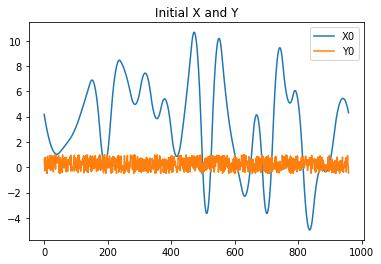

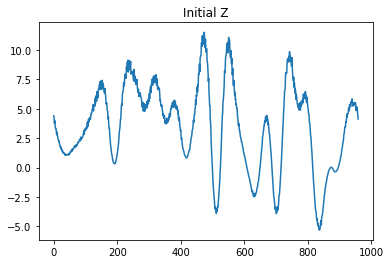

In [10]:
plt.figure()
plt.plot(X0)
plt.plot(Y0)
plt.legend(['X0', 'Y0'])
plt.title('Initial X and Y')

plt.figure()
plt.plot(Z0)
plt.title('Initial Z')

In [11]:
t = np.linspace(0, 20, 100)

In [12]:
Z = return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)

In [13]:
theta_Z = np.linspace(0, 2 * np.pi, N_Z + 1)

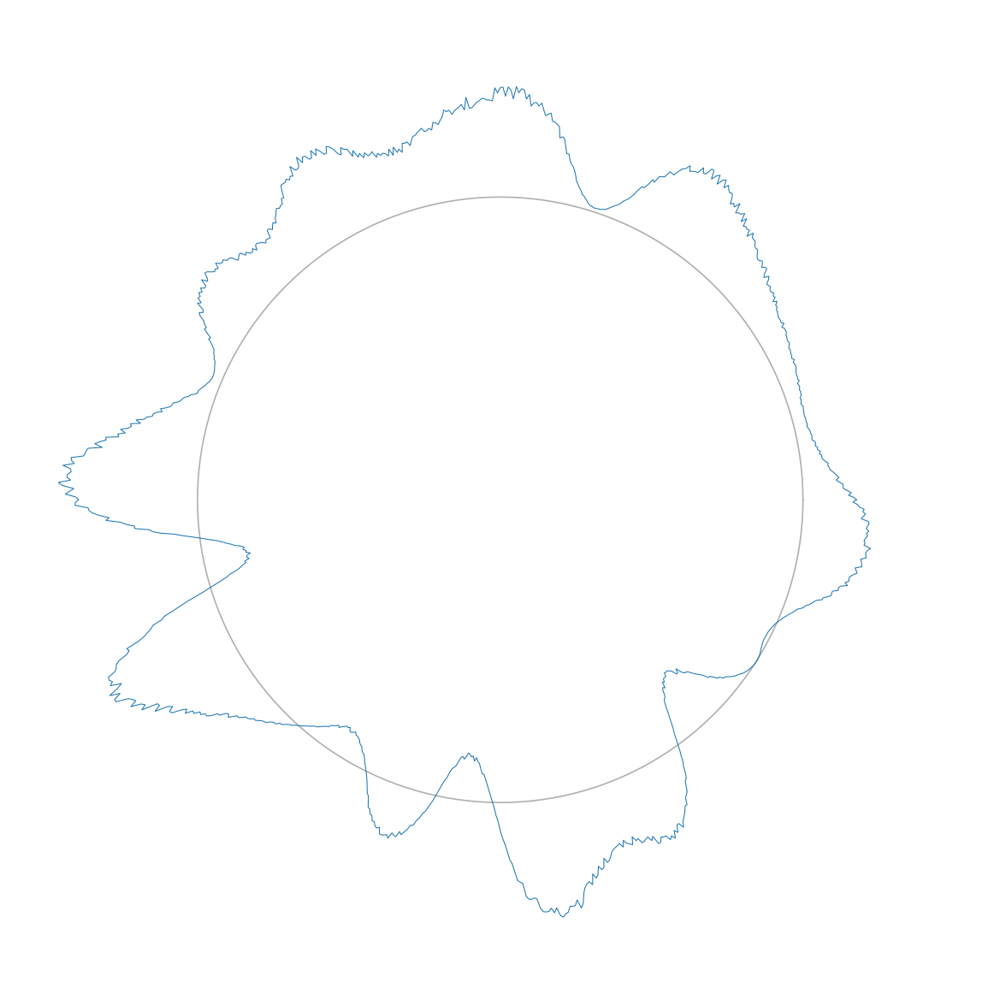

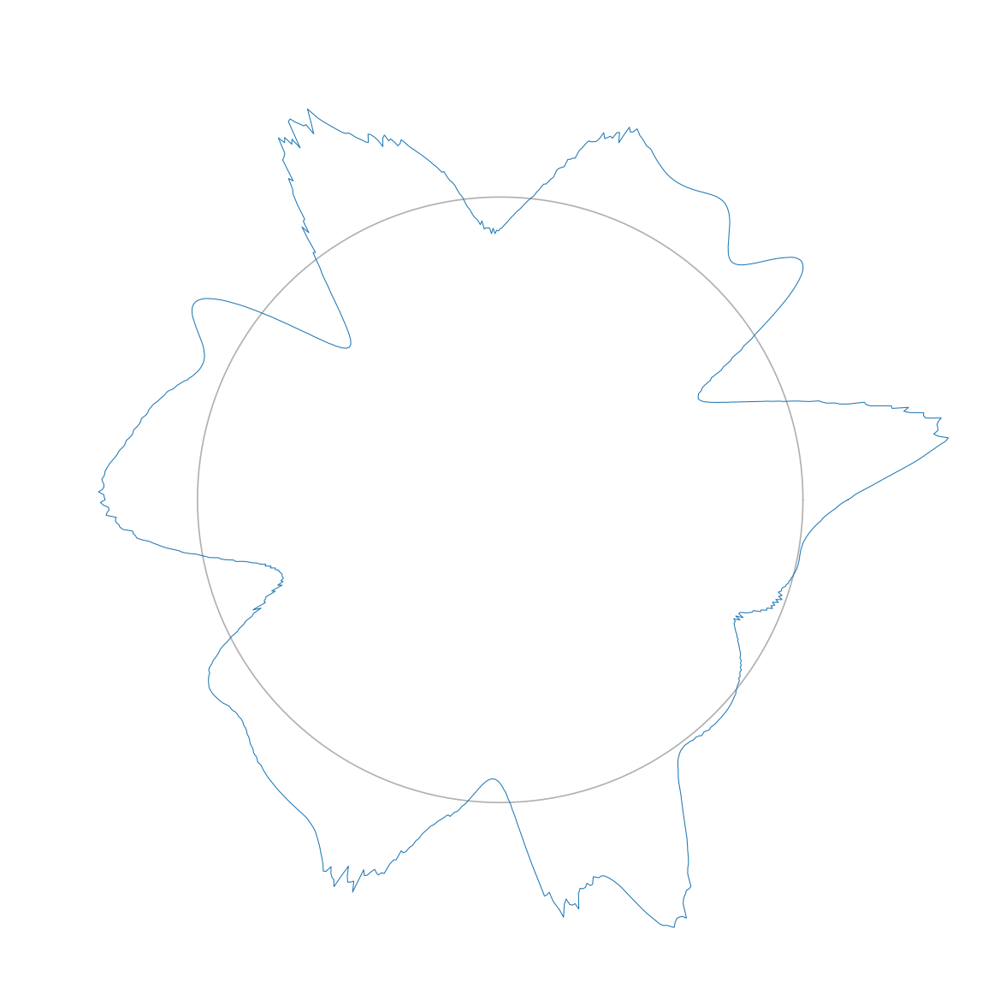

In [14]:
for ii in [0, -1]:
    Z_to_plot = Z[:, ii]
    Z_to_plot = np.concatenate([Z_to_plot, 
                                [Z_to_plot[0]]])
    
    plt.figure(figsize=(10,10), dpi=150)
    axes = plt.subplot(111, polar=True)
    plt.polar(theta_Z, Z_to_plot, linewidth=0.5)
    plt.yticks([0])
    plt.ylim([-25, 15])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

# use end of run as init

In [15]:
Z0 = Z[:, -1]

In [16]:
T = 1000
dt = 0.05
N = int(T/dt + 1)
t = np.linspace(0, T, N)

# long run to generate ensemble

In [9]:
# Z = return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)

# np.save('./Z_long_run.npy', Z)
Z = np.load('./Z_long_run.npy')

In [10]:
X = window_sum_Z(Z, I=I, alpha=alpha, beta=beta)
Y = Z - X

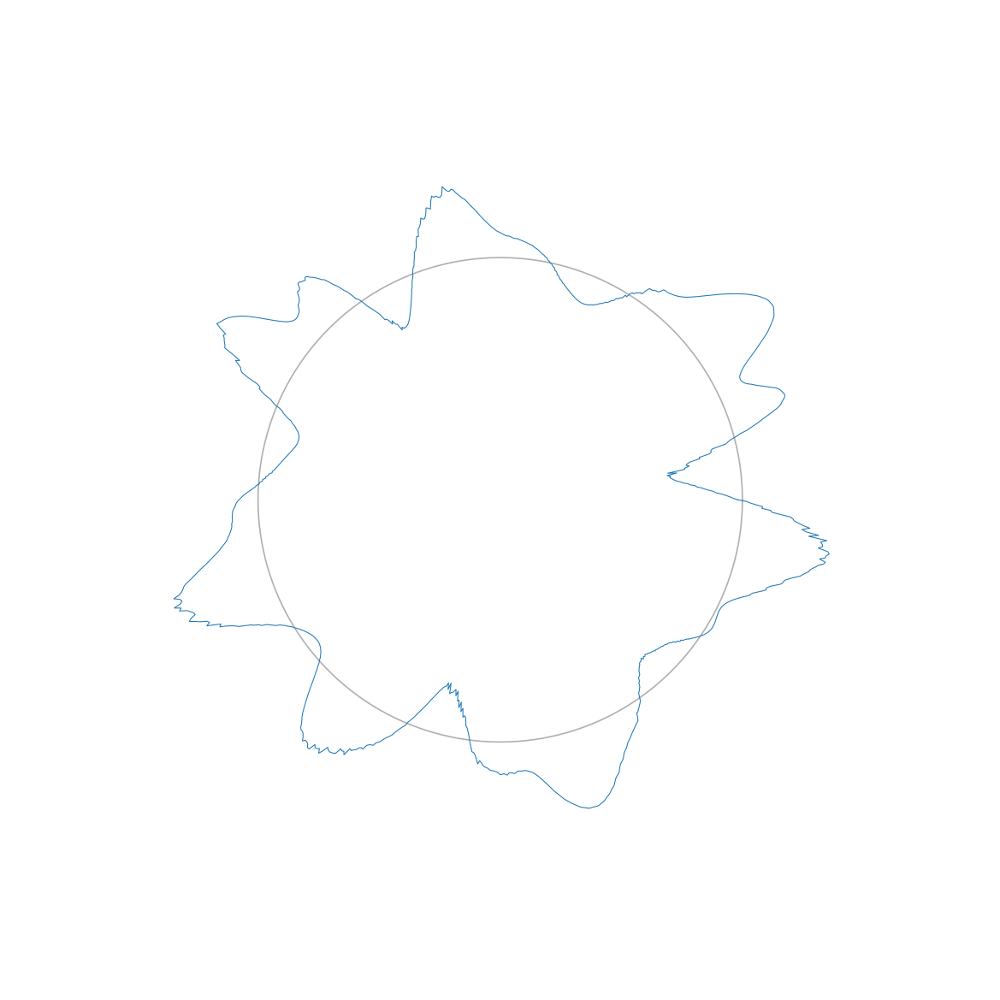

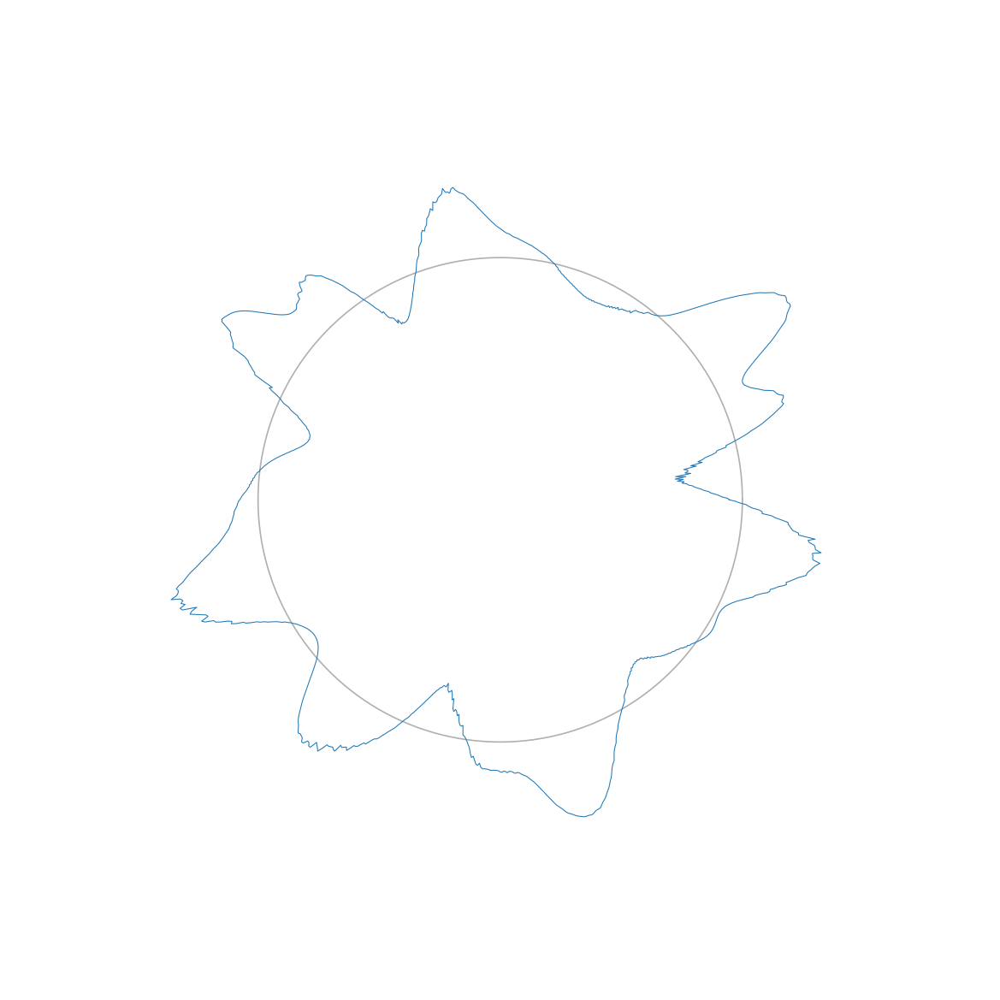

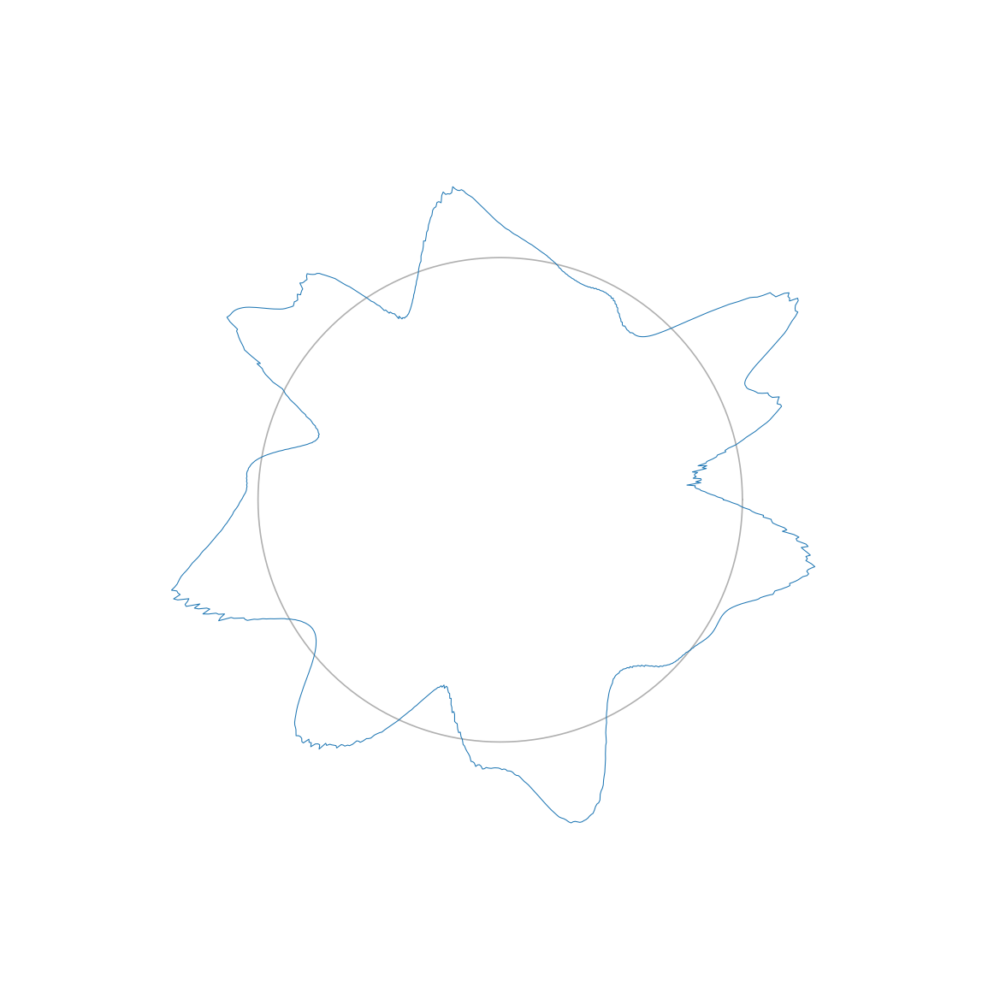

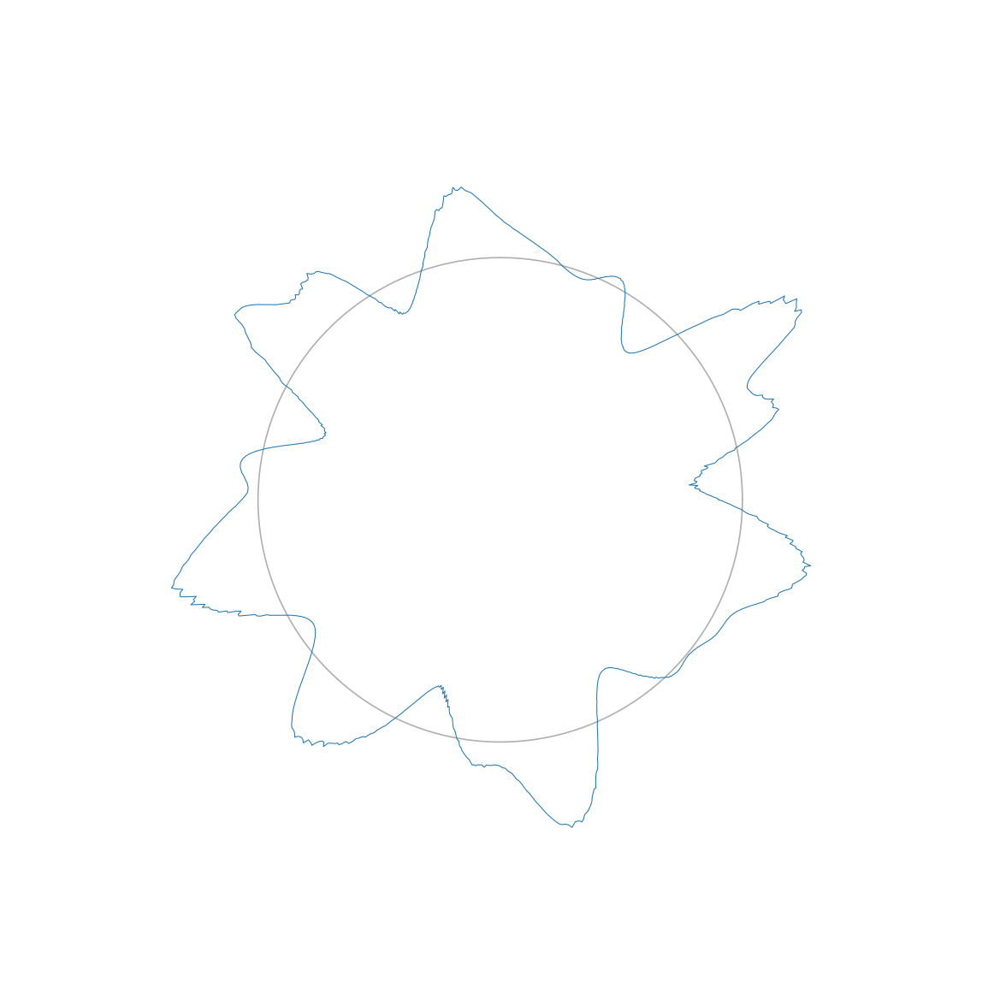

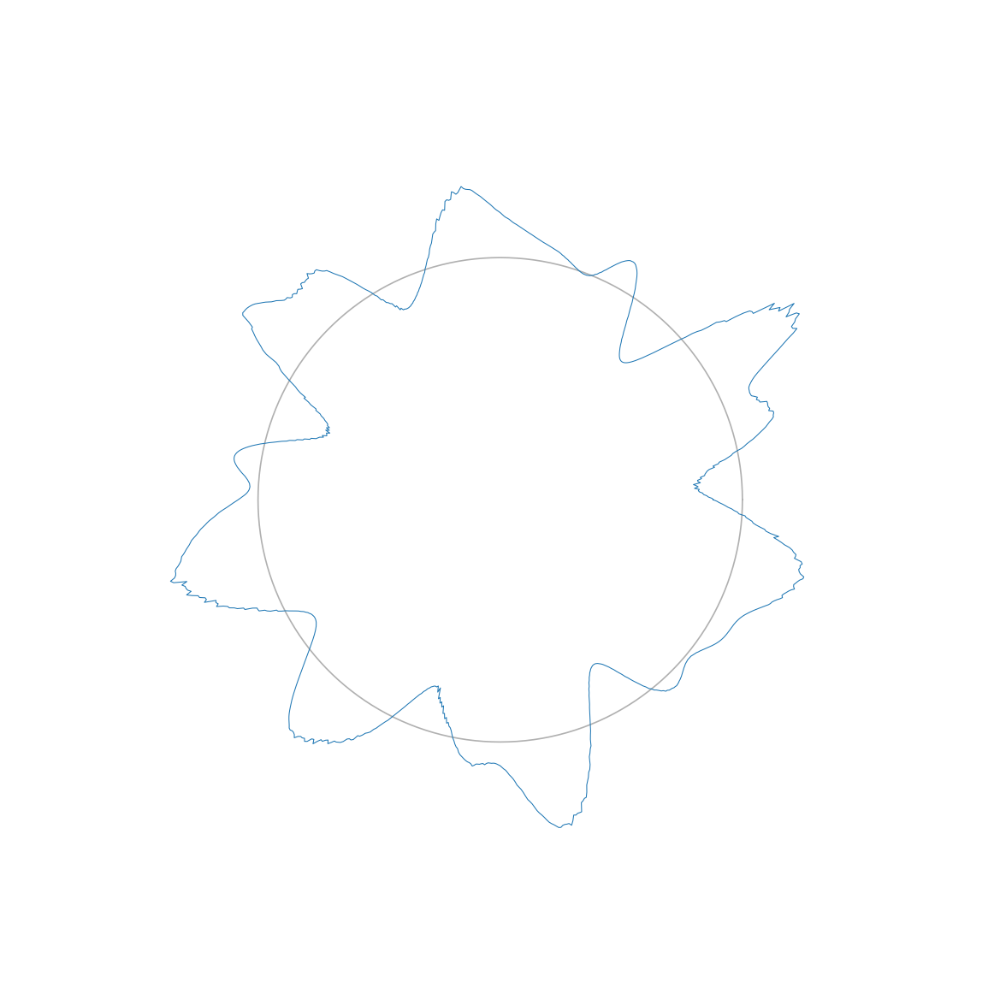

...

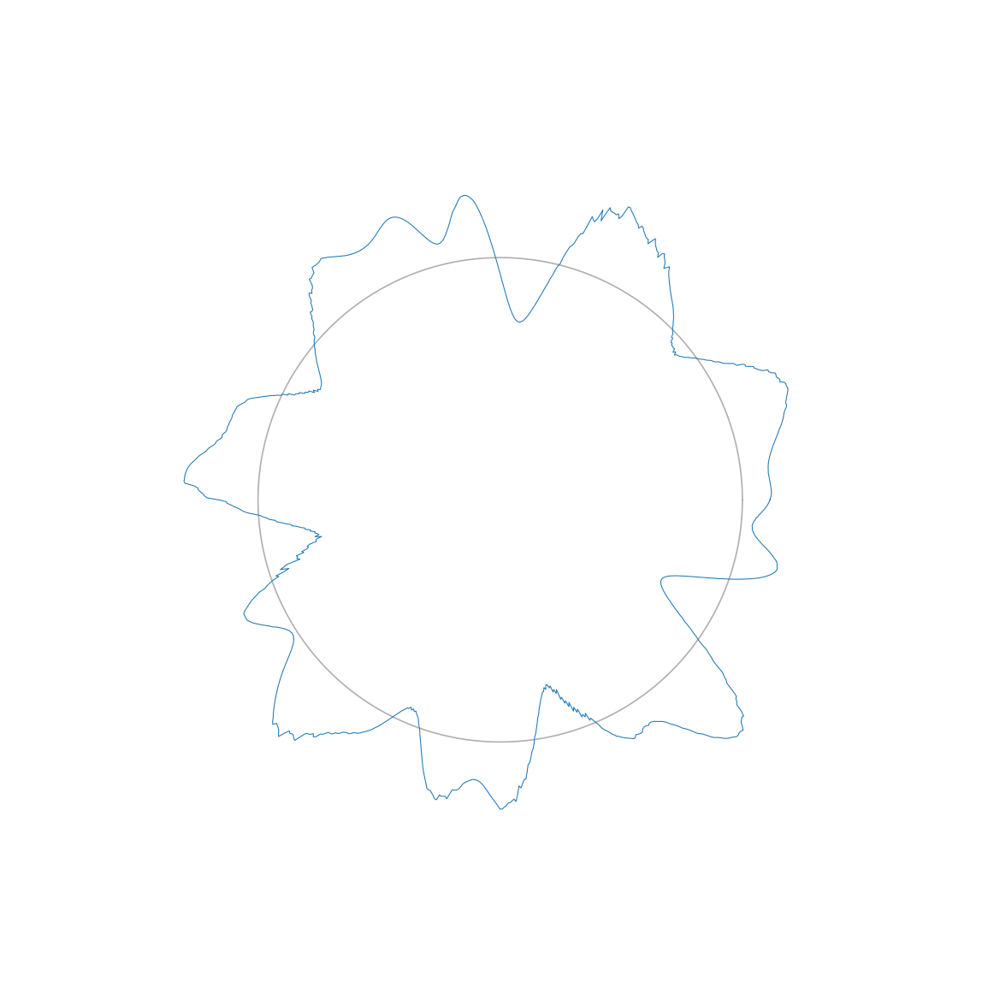

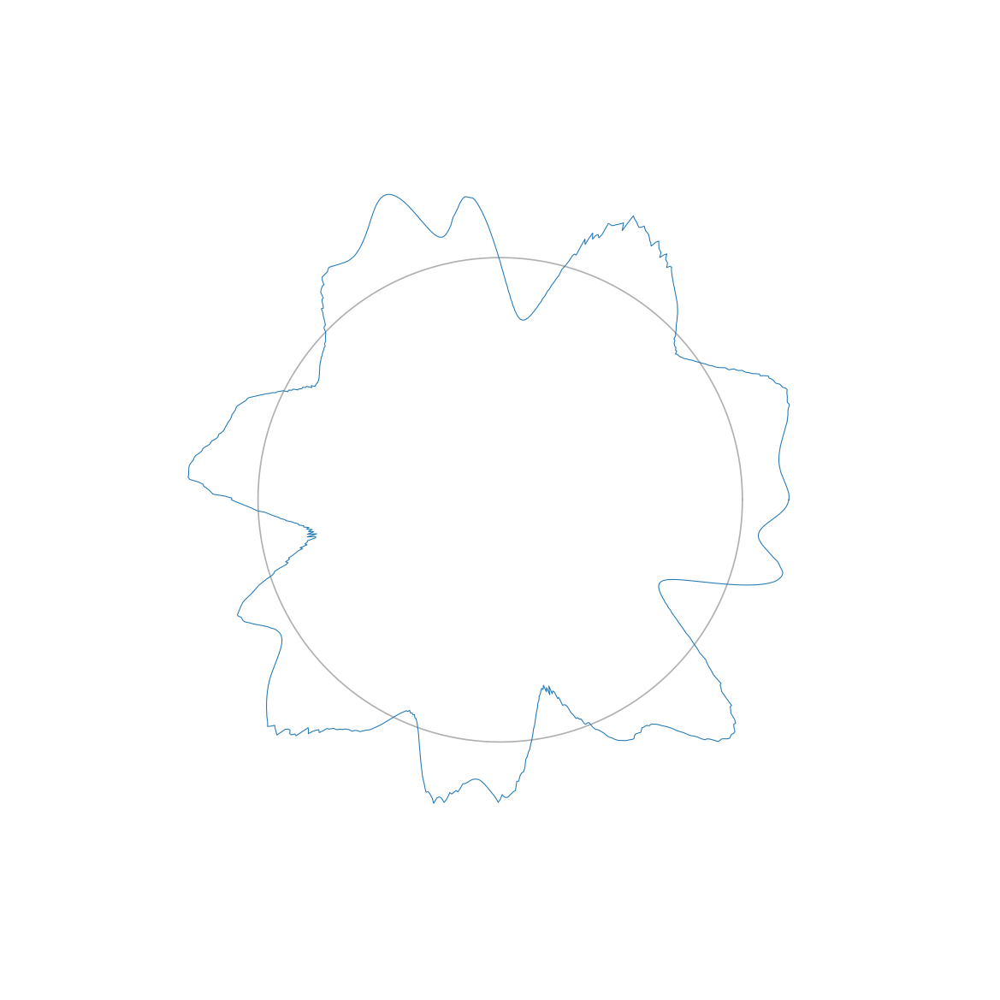

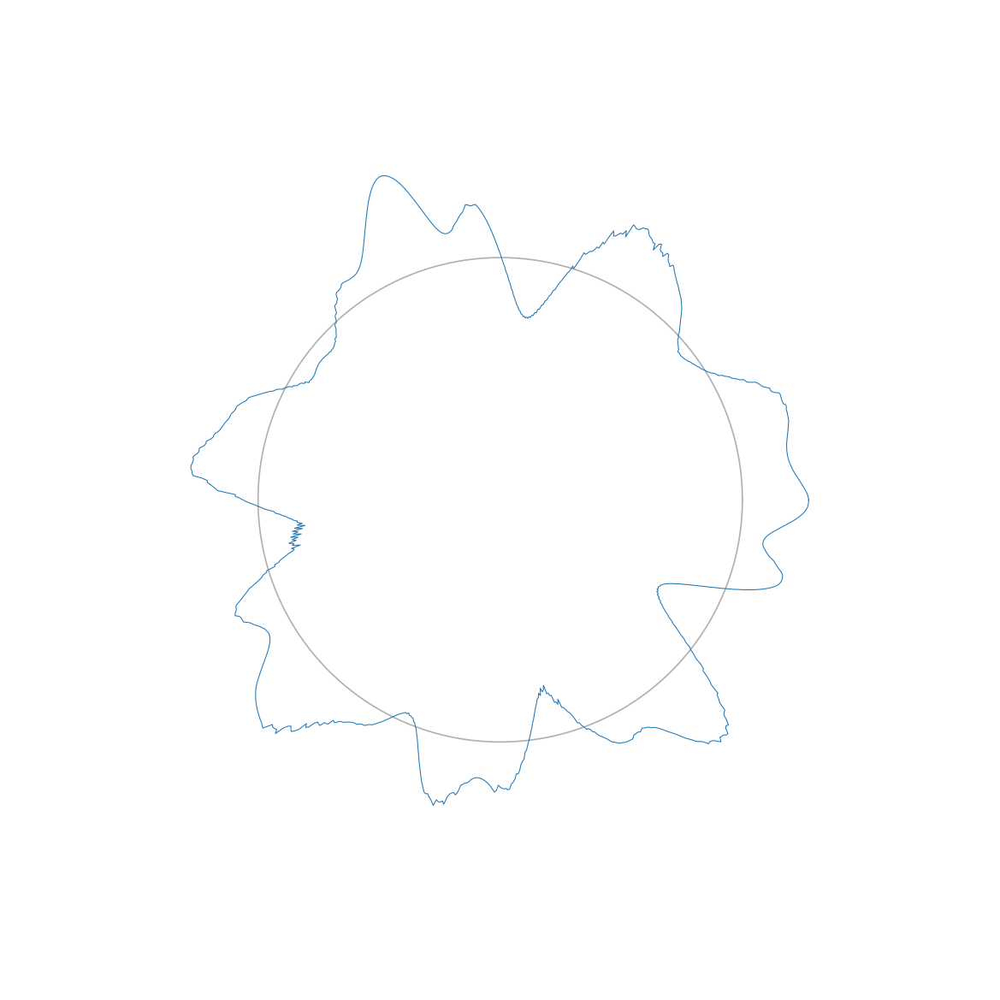

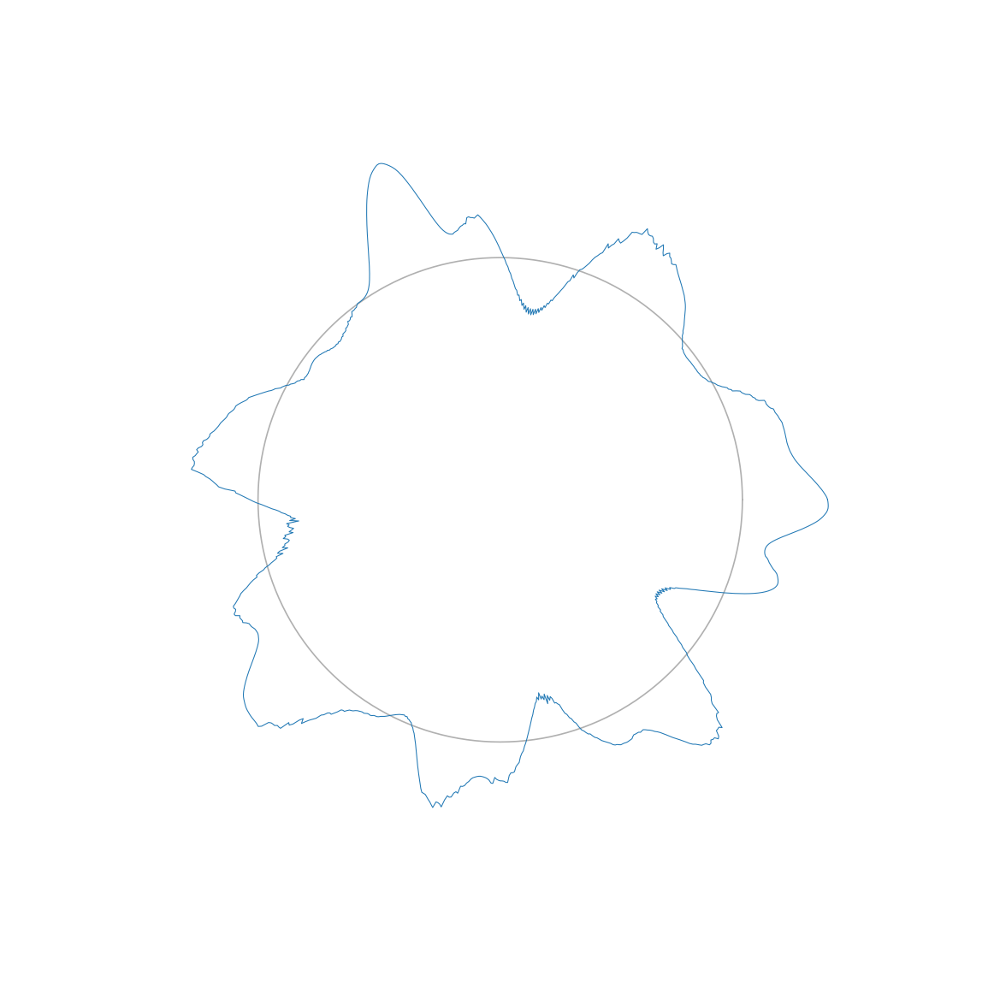

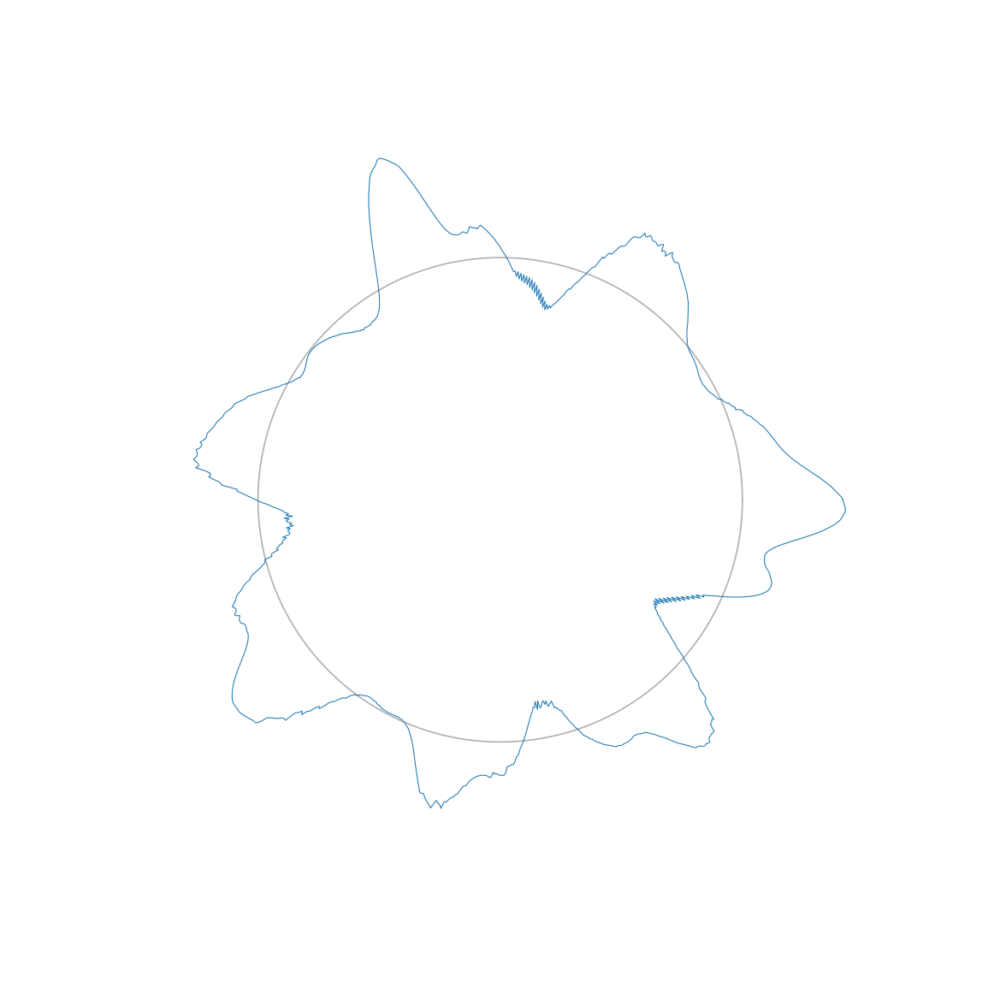

In [19]:
for ii in range(20): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z[:, ii]
    Z_to_plot = np.concatenate([Z_to_plot, 
                                [Z_to_plot[0]]])
    
    plt.figure(figsize=(10,10), dpi=150)
    axes = plt.subplot(111, polar=True)
    plt.polar(theta_Z, Z_to_plot, linewidth=0.5)
    plt.yticks([0])
    plt.ylim([-30, 30])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

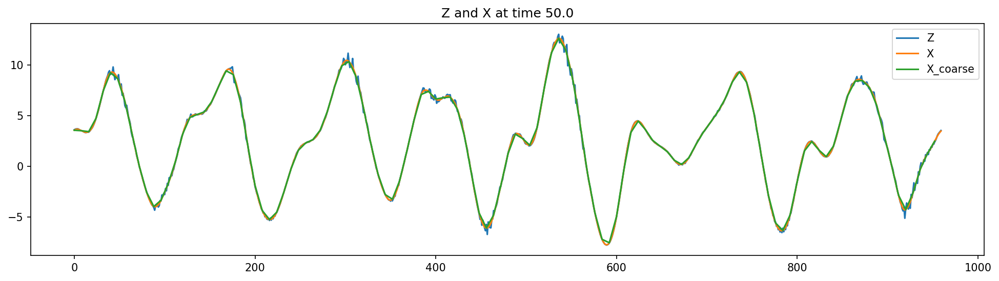

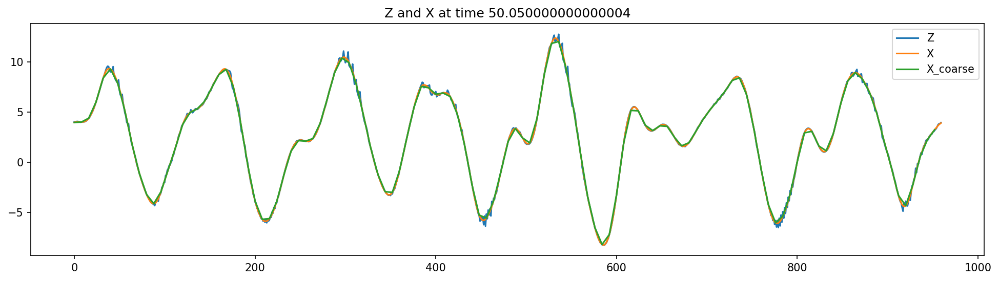

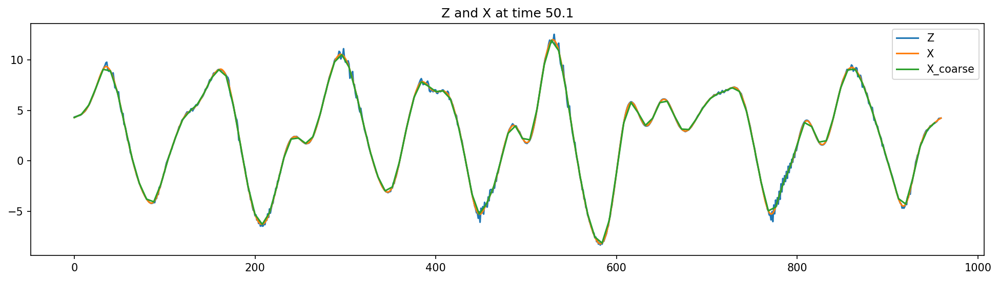

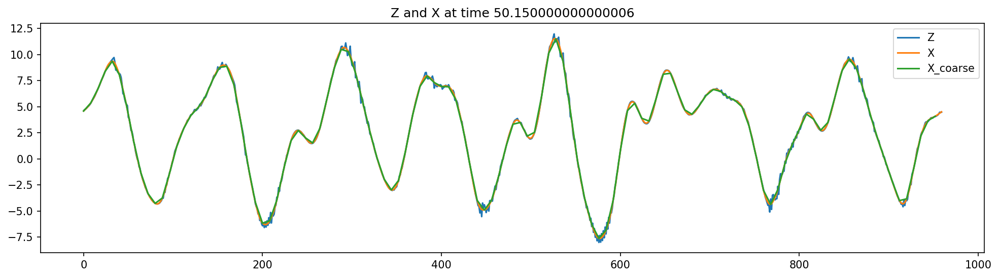

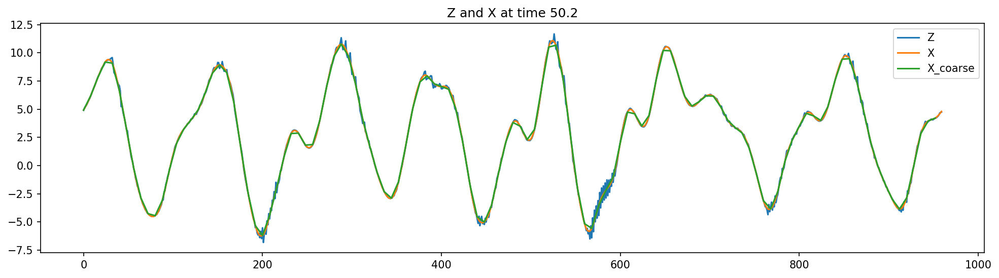

...

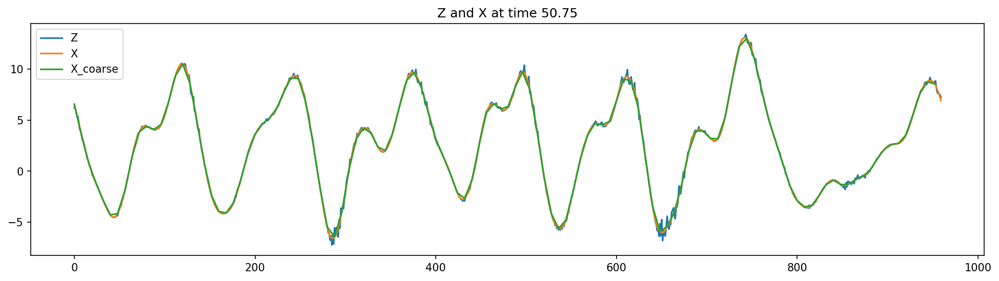

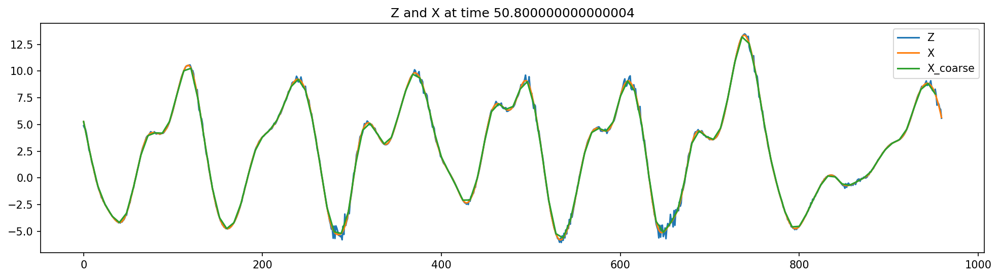

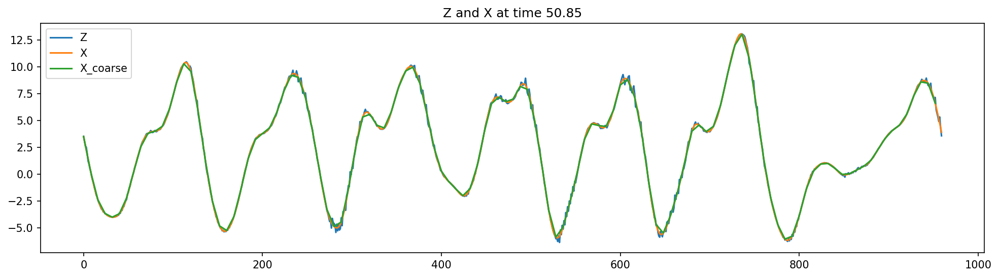

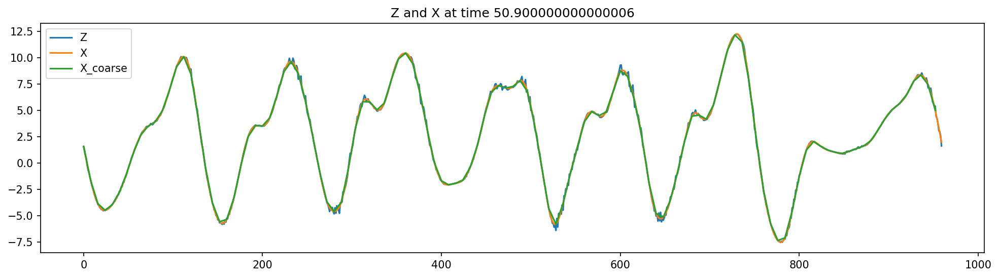

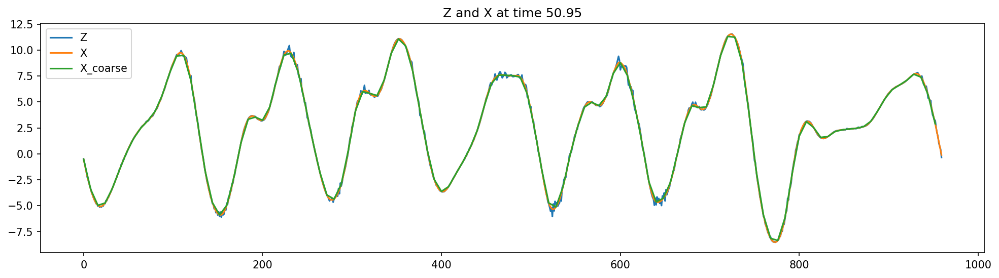

In [20]:
for ii in range(1000, 1020): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z[:, ii]
    X_to_plot = X[:, ii]
    X_coarse_to_plot = X_to_plot[::8]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(x[::8], X_coarse_to_plot)
    plt.title(f'Z and X at time {ii*dt}')
    plt.legend(['Z', 'X', 'X_coarse'])

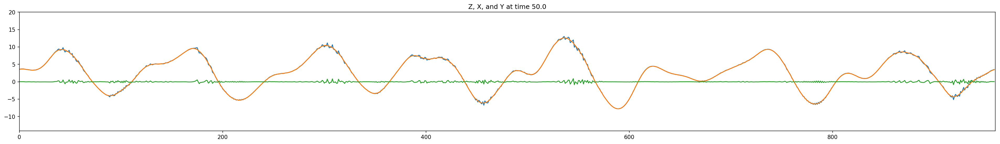

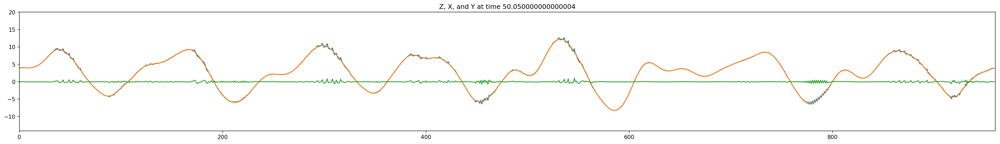

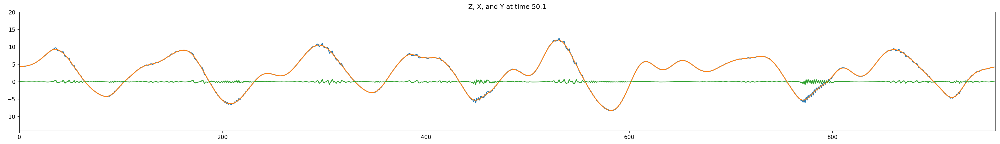

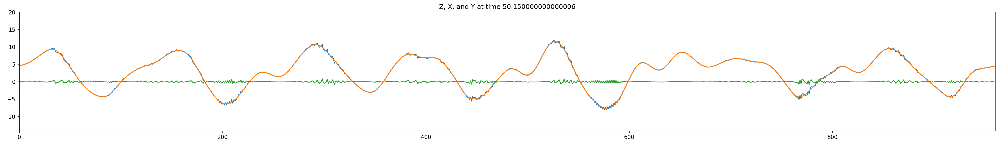

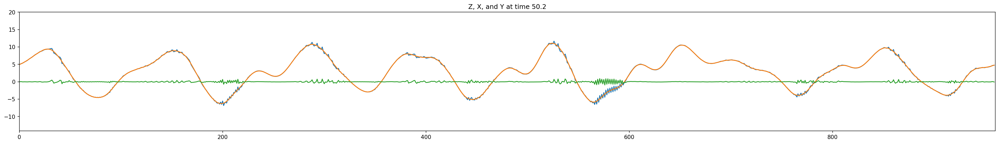

...

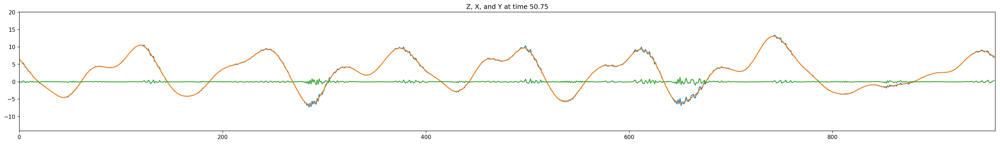

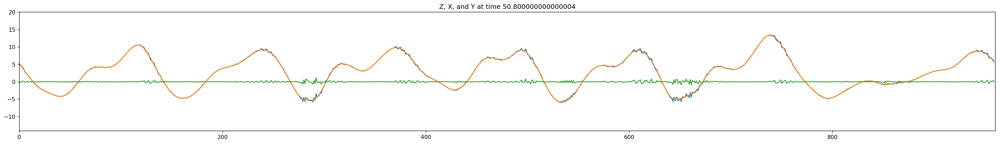

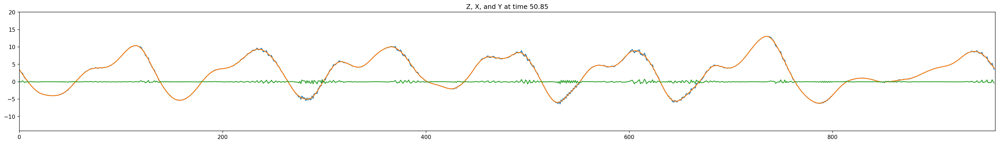

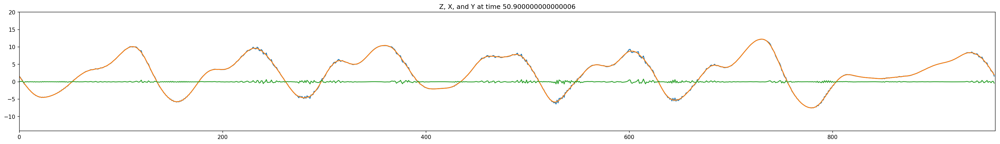

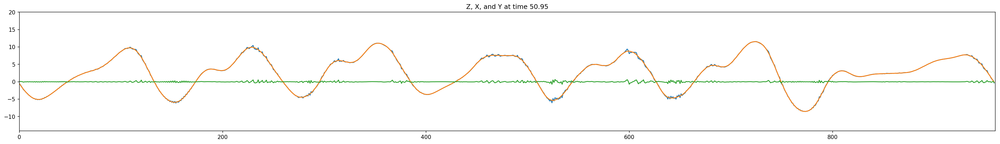

In [21]:
ymax = Z.max()
ymin = Z.min()
for ii in range(1000, 1020): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z[:, ii]
    X_to_plot = X[:, ii]
    Y_to_plot = Y[:, ii]
    figsize = plt.figaspect(1/8) * 2
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(Y_to_plot)
    plt.ylim([ymin, ymax])
    plt.xlim([0, Z_to_plot.size])
    plt.title(f'Z, X, and Y at time {ii*dt}')

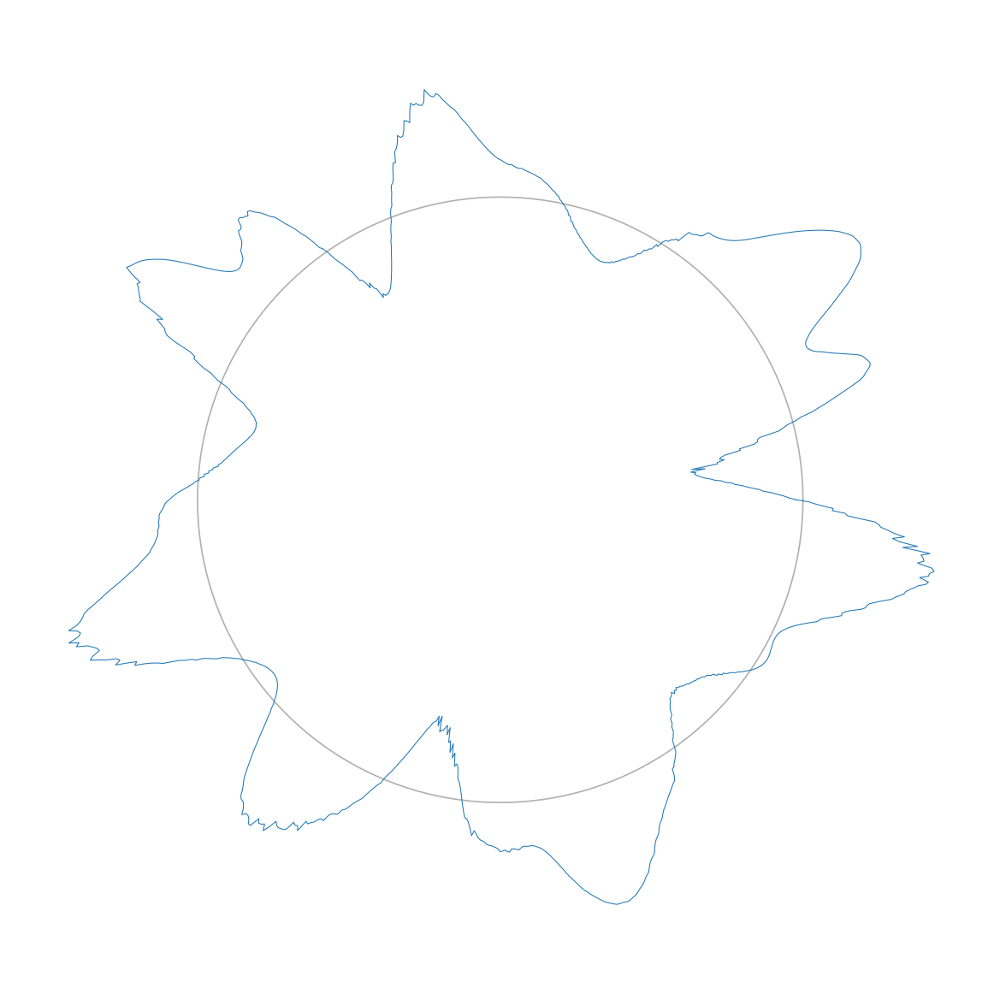

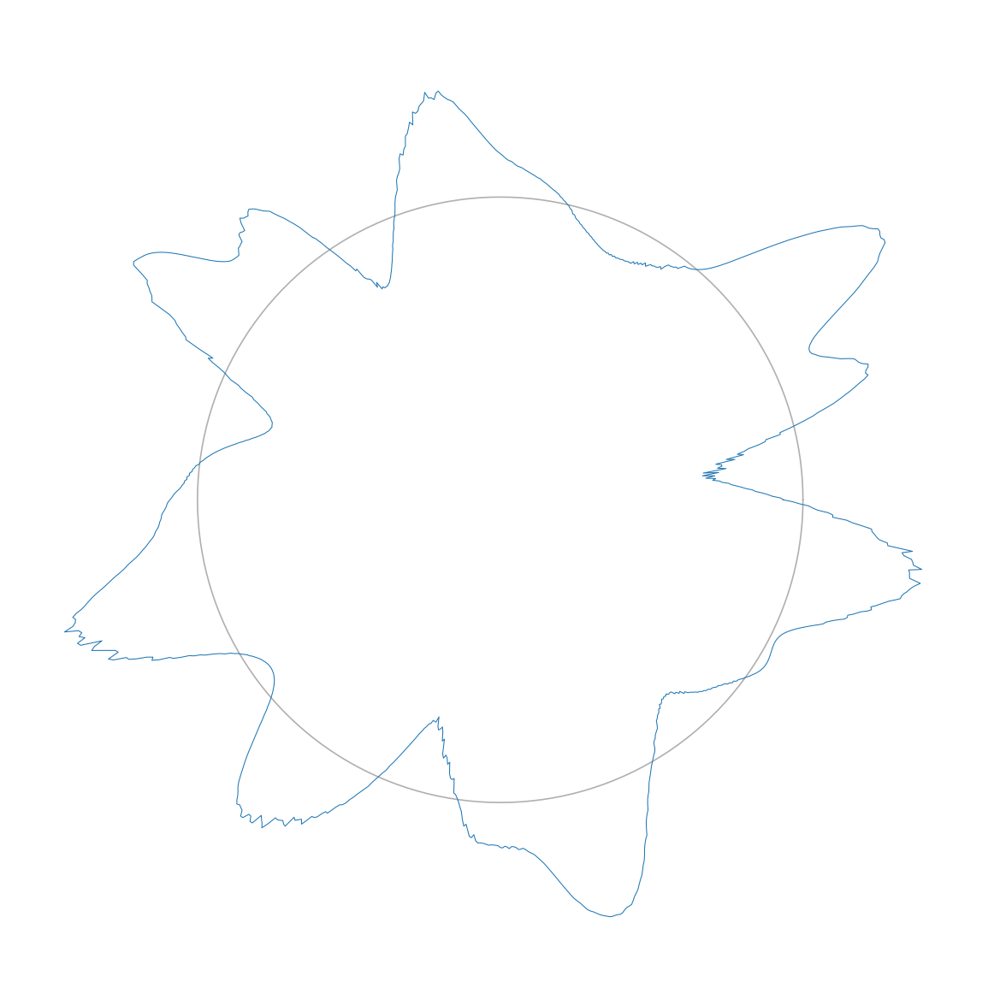

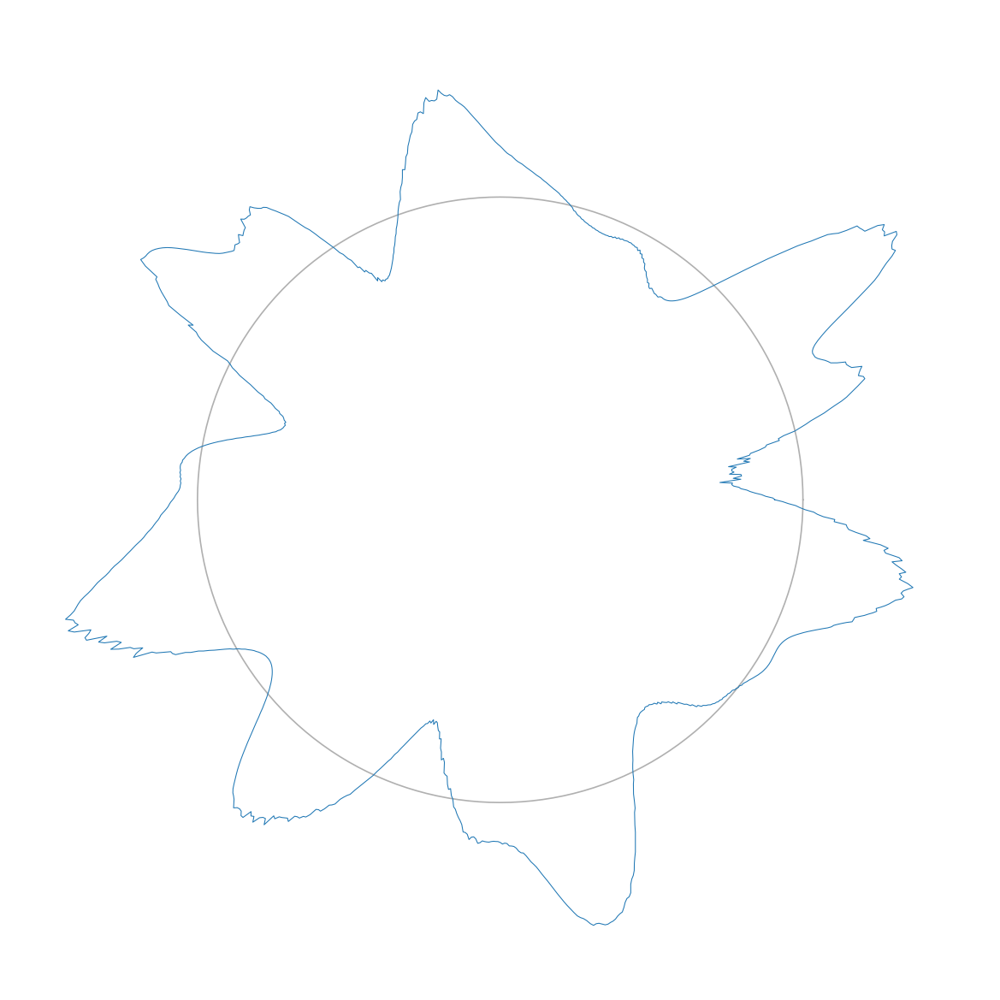

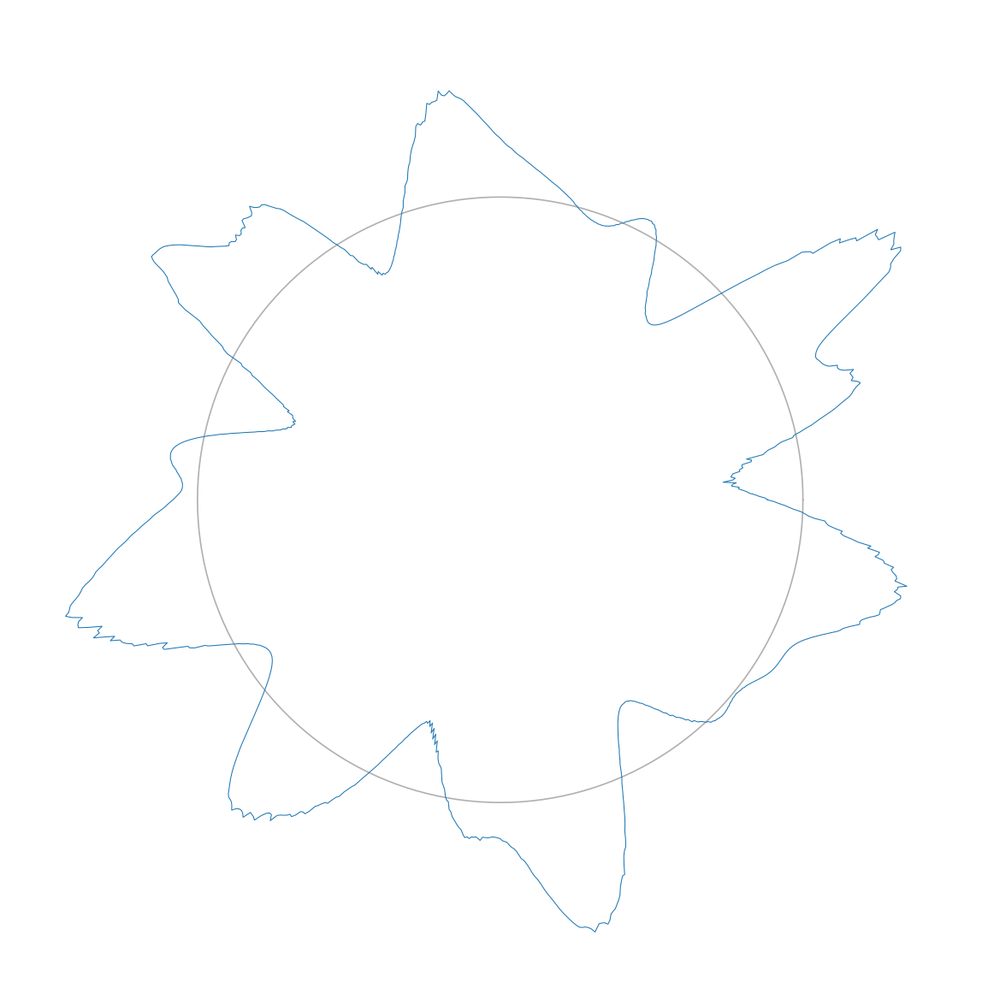

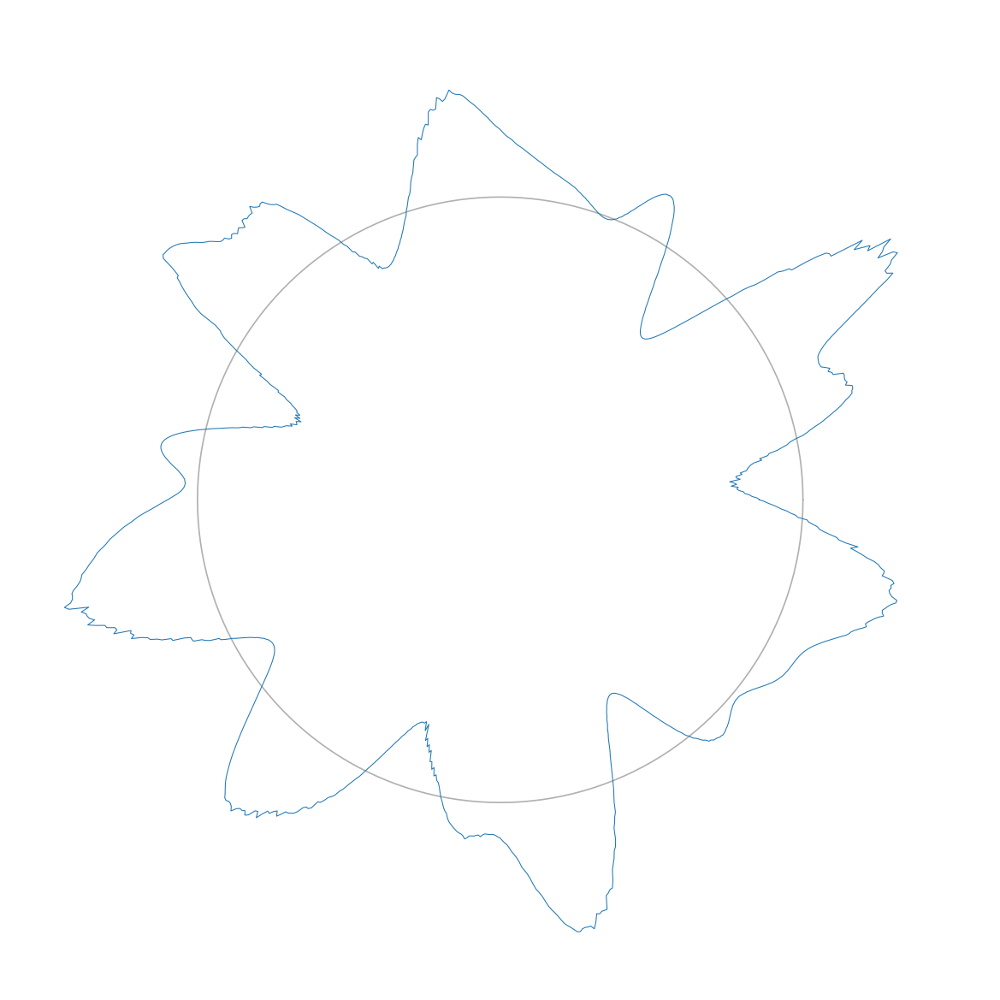

...

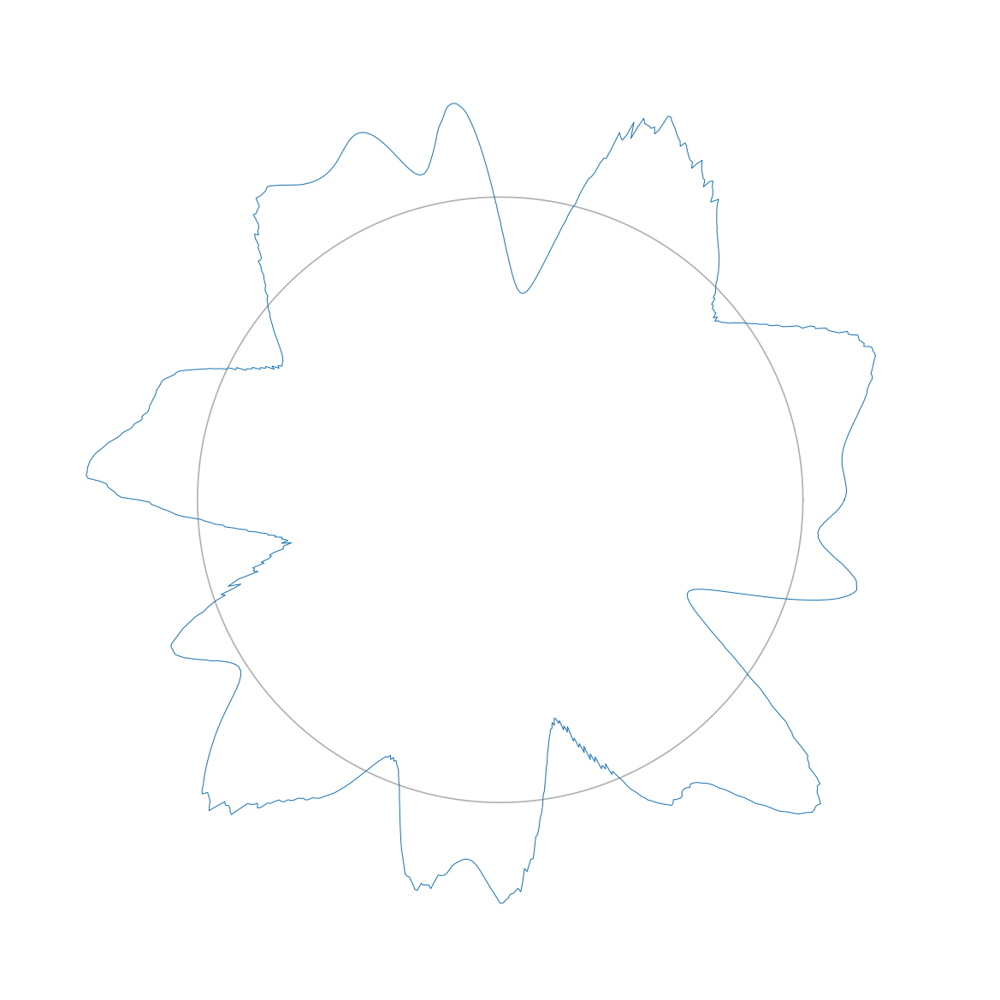

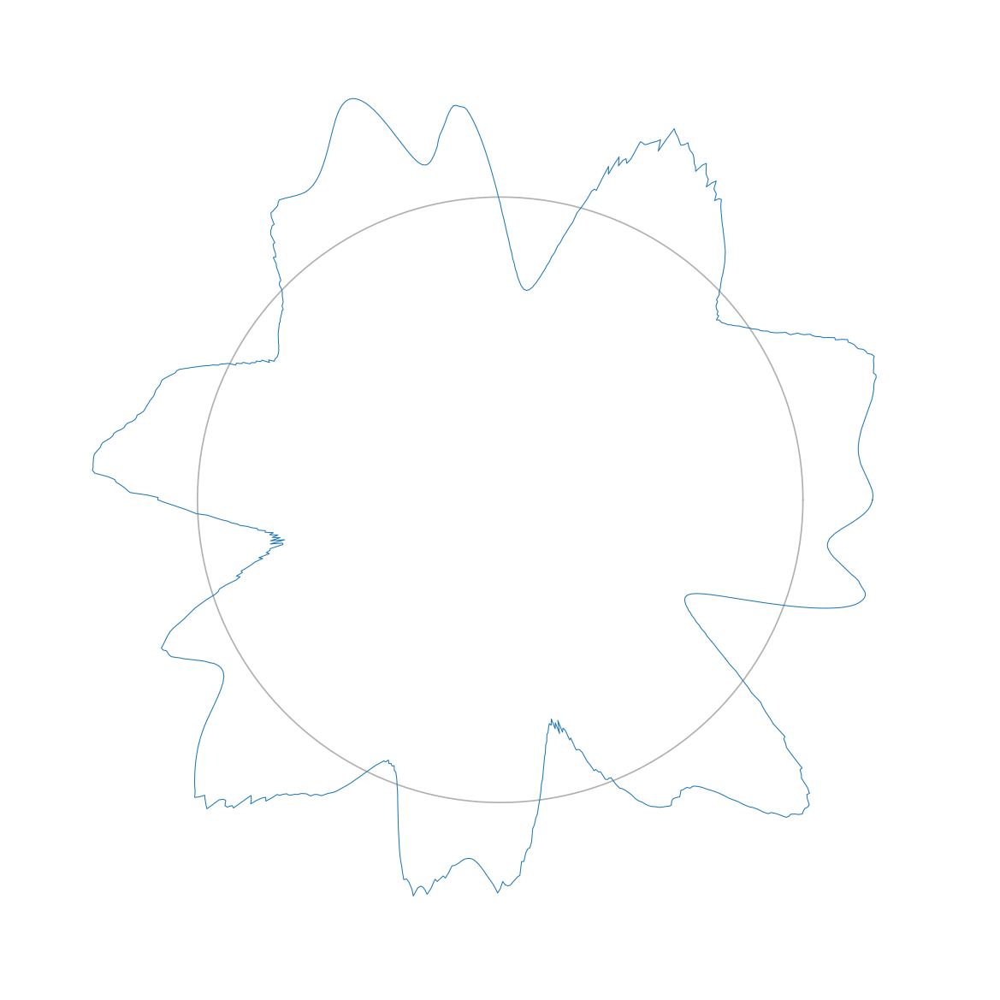

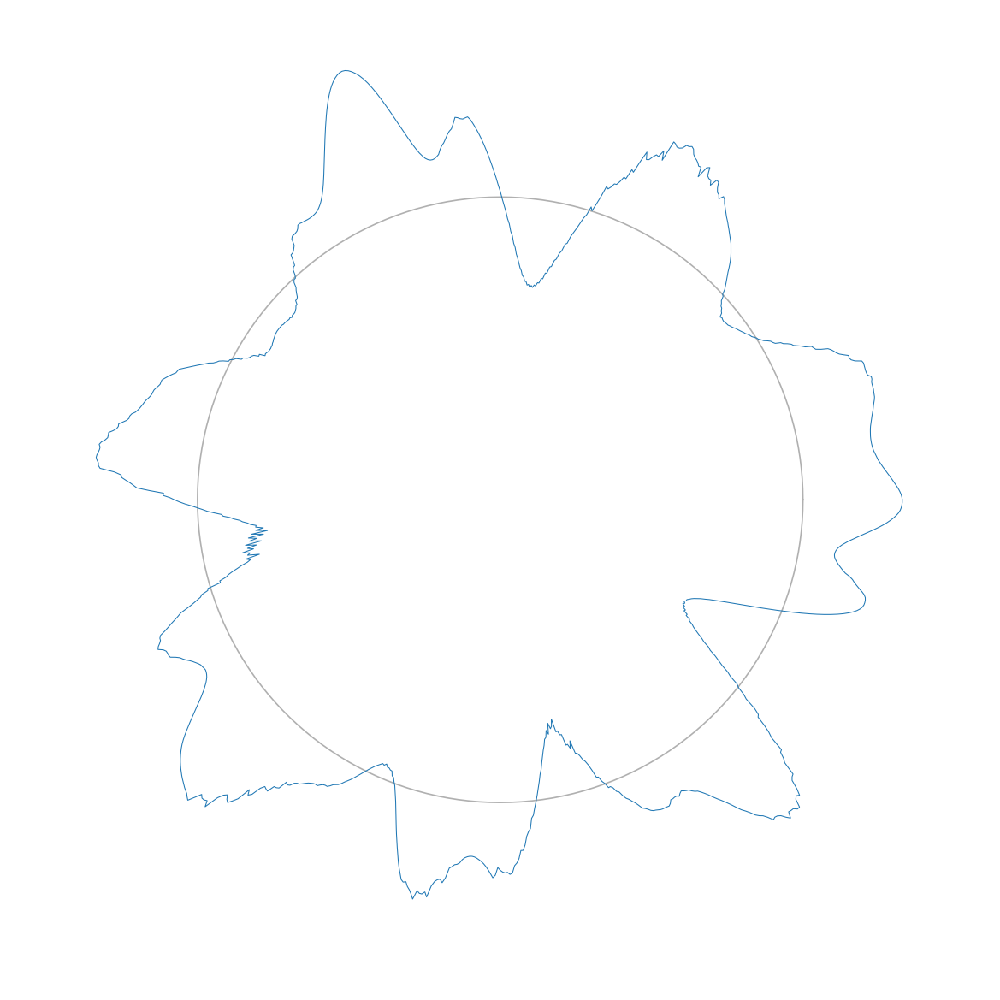

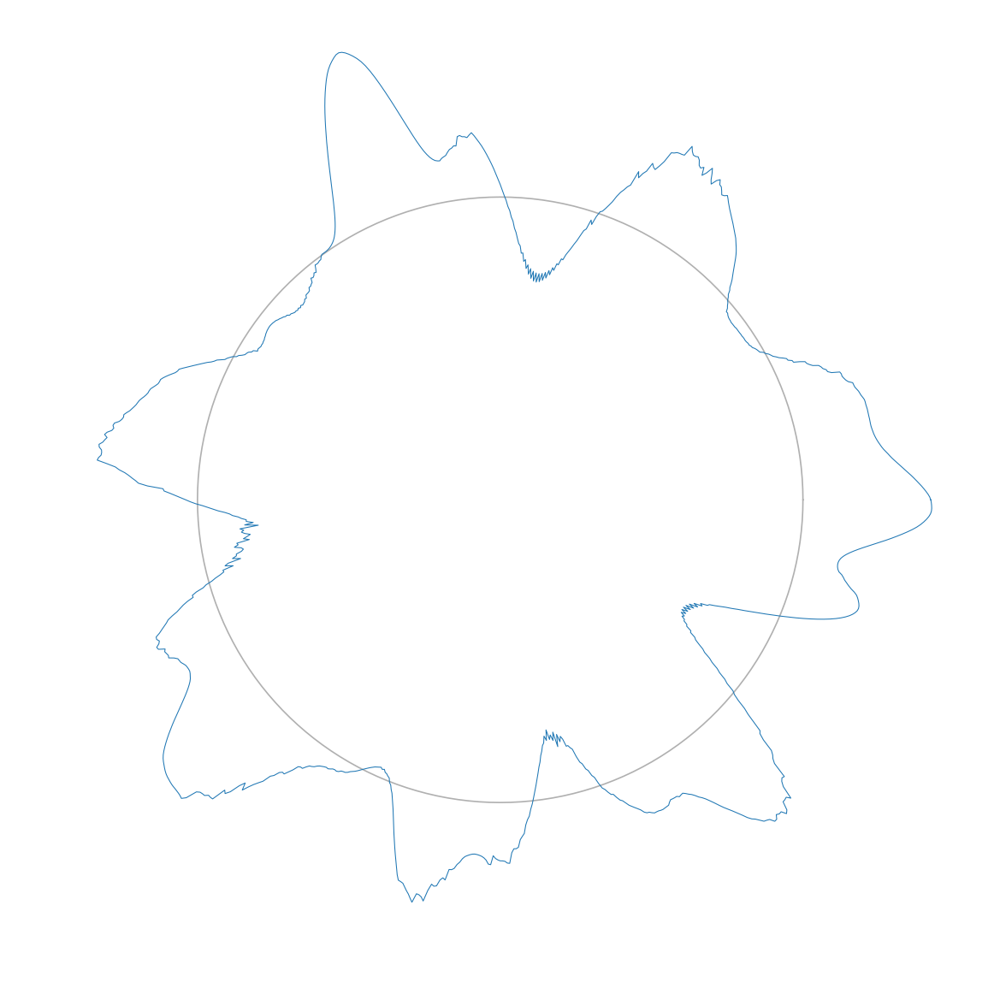

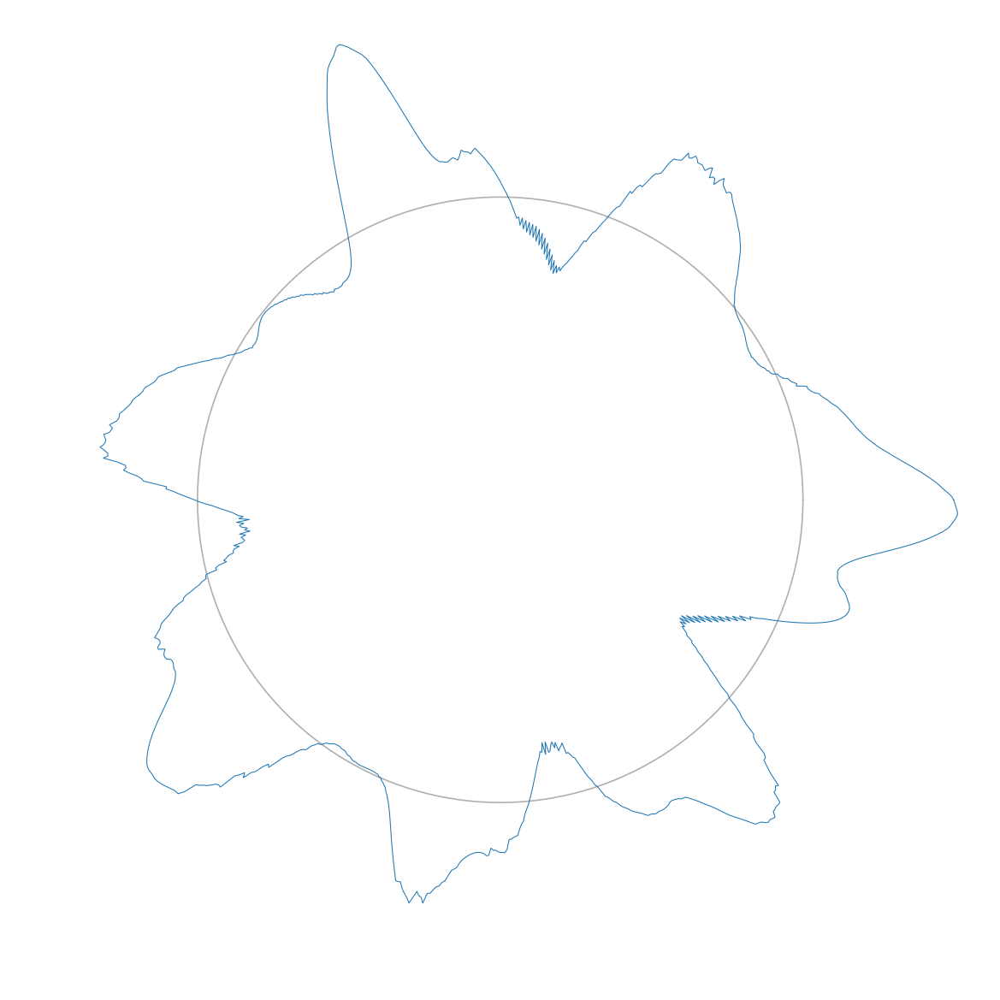

In [22]:
for ii in range(20): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z[:, ii]
    Z_to_plot = np.concatenate([Z_to_plot, 
                                [Z_to_plot[0]]])
    
    plt.figure(figsize=(10,10), dpi=150)
    axes = plt.subplot(111, polar=True)
    plt.polar(theta_Z, Z_to_plot, linewidth=0.5)
    plt.yticks([0])
    plt.ylim([-25, 15])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

In [11]:
def generate_Z_ens(Z_ts, N_eZ):
    """

    """
    N_t = Z_ts.shape[1]
    fine_indices = np.random.choice(N_t, size=N_eZ, replace=False)
    Z_ens = Z_ts[:, fine_indices]
    return Z_ens

In [12]:
def generate_X_ens(Z_ts, *, I, alpha, beta, N_eX, coarse):
    X_ens = generate_Z_ens(Z_ts, N_eX)
    X_ens = window_sum_Z(X_ens, I=I, alpha=alpha, beta=beta)
    X_ens = X_ens[::coarse]
    return X_ens

In [172]:
# Z0_ens = generate_Z_ens(Z, N_eZ)

# np.save('Z0_ens', Z0_ens)
Z0_ens = np.load('Z0_ens.npy')

In [173]:
# X0_ens = generate_X_ens(Z, I=I, alpha=alpha, beta=beta, N_eX=N_eX, coarse=coarse)

# np.save('X0_ens', X0_ens)
X0_ens = np.load('X0_ens.npy')

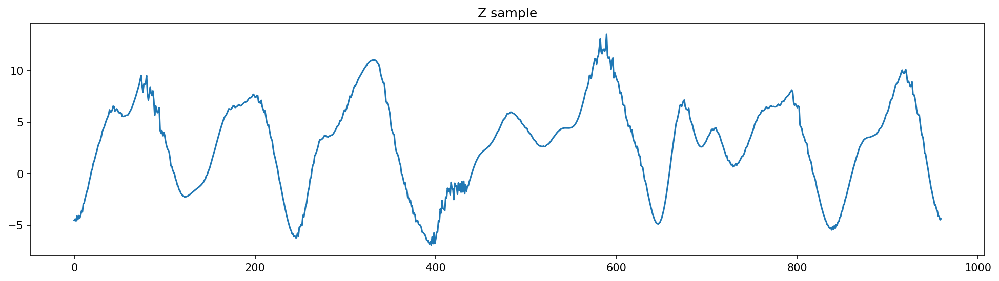

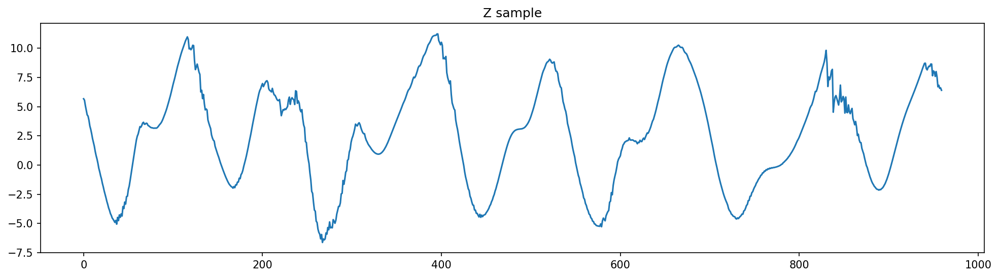

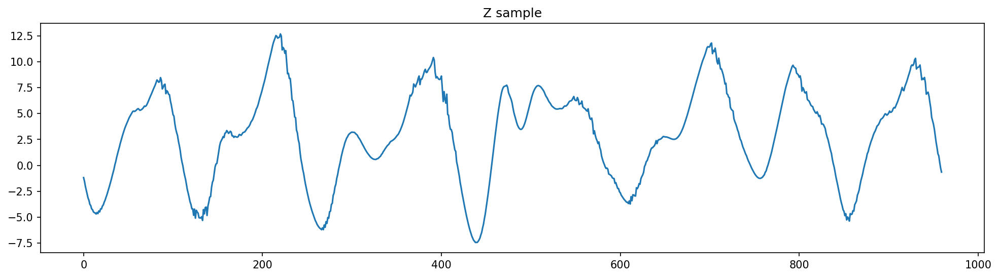

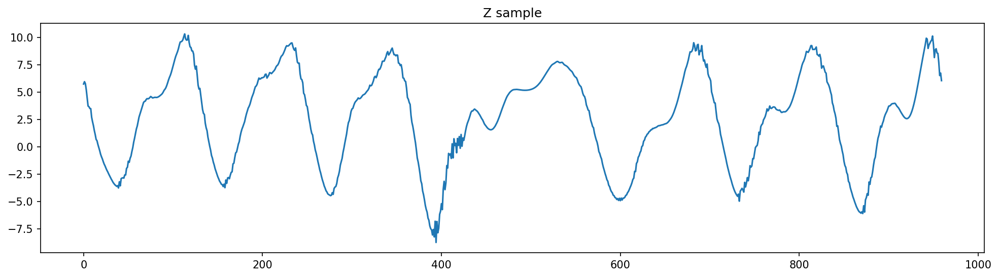

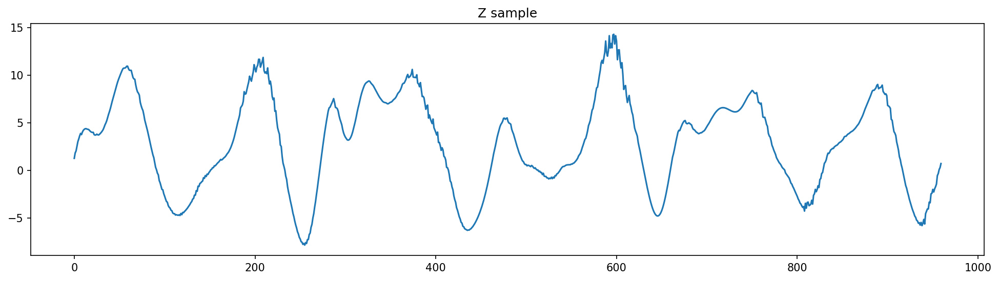

...

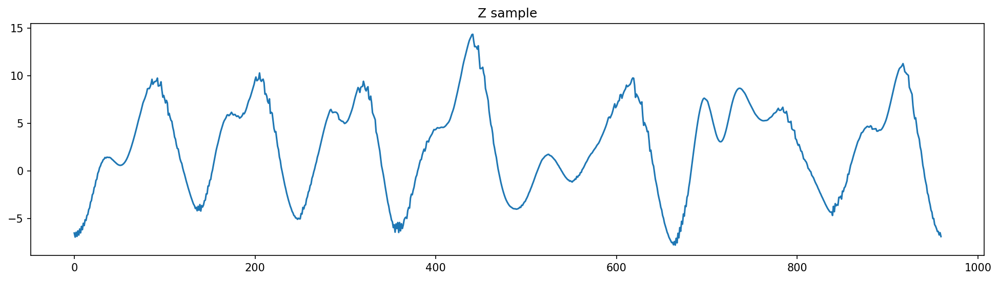

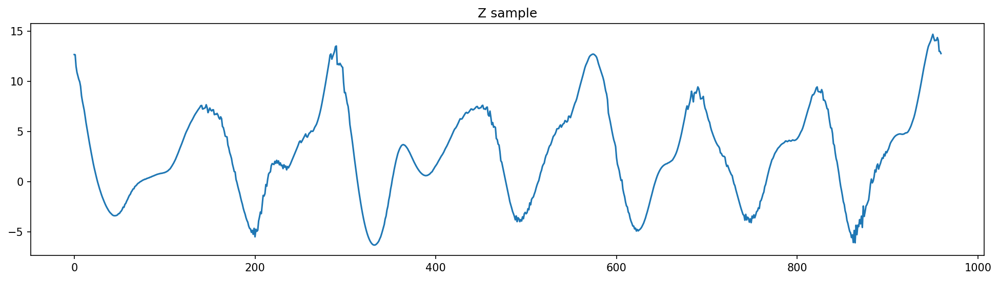

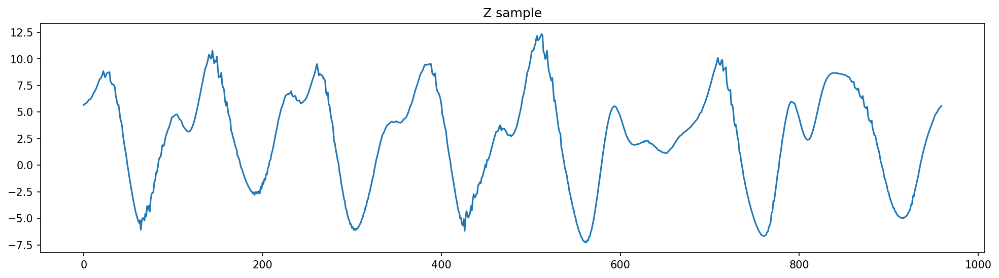

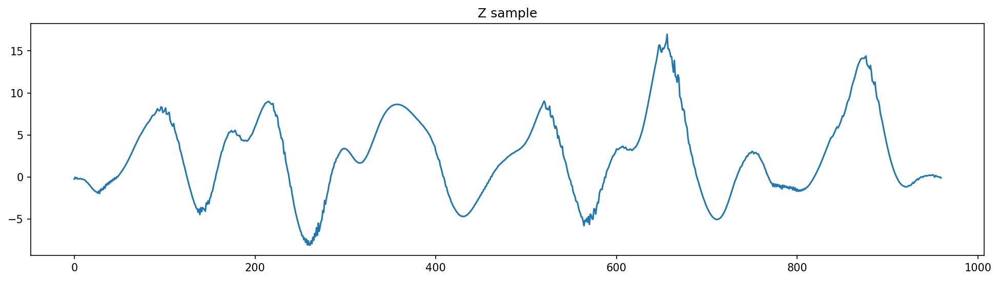

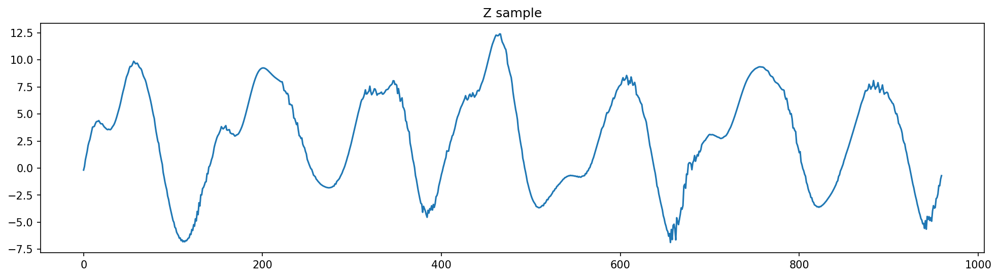

In [27]:
for ii in range(Z0_ens.shape[1]): # range(5): #
#     ii = 5 * ii
    Z_to_plot = Z0_ens[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.title(f'Z sample')

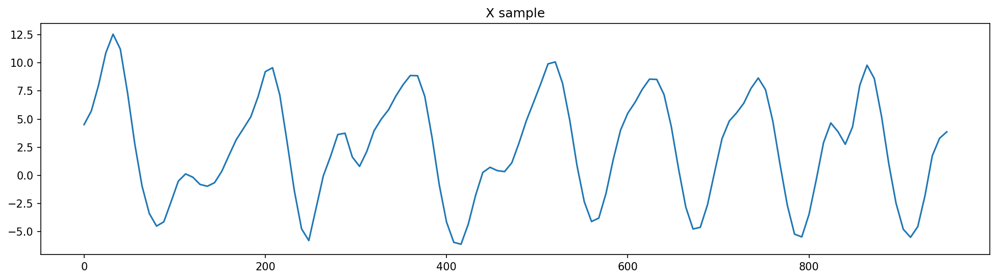

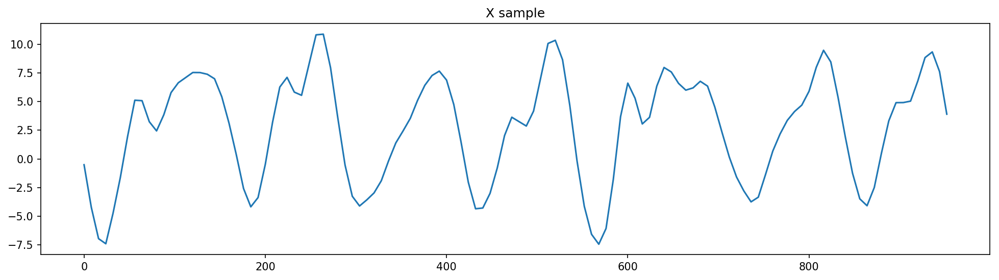

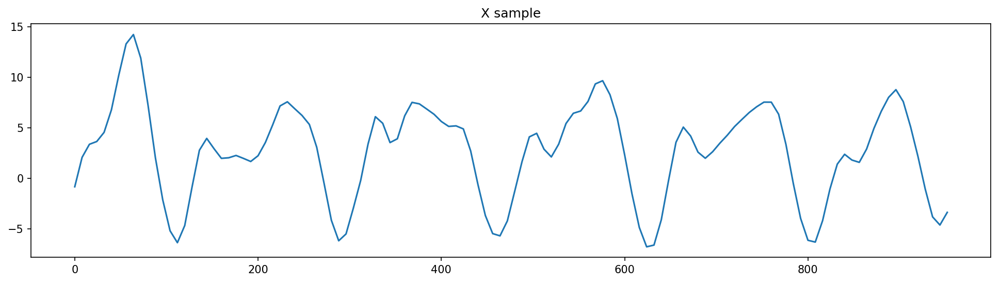

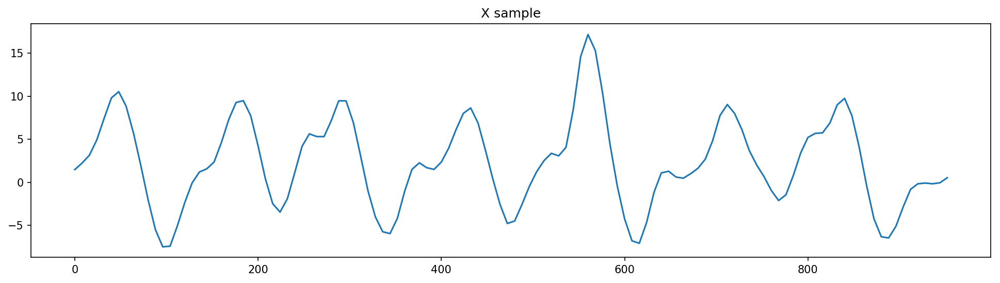

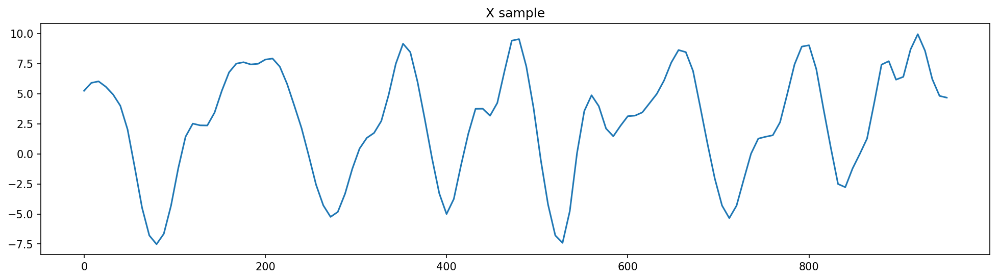

In [28]:
for ii in range(5): #range(XY.shape[0]):
#     ii = 5 * ii
    X_to_plot = X0_ens[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(x[::coarse], X_to_plot)
    plt.title(f'X sample')

In [29]:
Z_ens_mean = Z0_ens.mean(axis=1)
Z_ens_sd = np.std(Z0_ens, axis=1)
X_ens_mean = X0_ens.mean(axis=1)
X_ens_sd = np.std(X0_ens, axis=1)

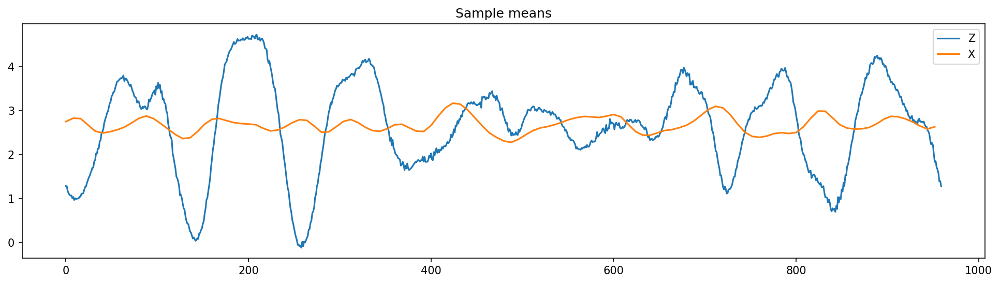

In [30]:
X_to_plot = X_ens_mean
Z_to_plot = Z_ens_mean
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_to_plot)
plt.plot(x[::coarse], X_to_plot)
plt.title(f'Sample means')
plt.legend(['Z', 'X'])

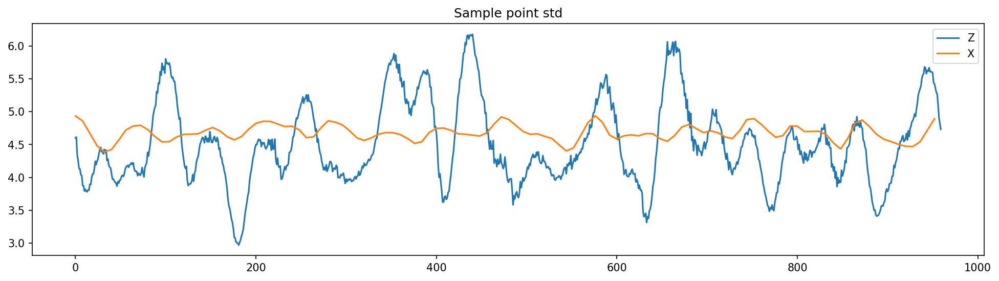

In [31]:
X_to_plot = X_ens_sd
Z_to_plot = Z_ens_sd
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_to_plot)
plt.plot(x[::coarse], X_to_plot)
plt.title(f'Sample point std')
plt.legend(['Z', 'X'])

In [32]:
P_X = np.cov(X0_ens)
P_Z = np.cov(Z0_ens)

C_X = np.corrcoef(X0_ens)
C_Z = np.corrcoef(Z0_ens)

Text(0.5,1,'Correlation Z from small ens')

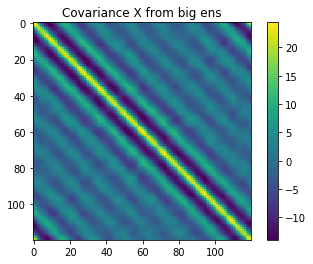

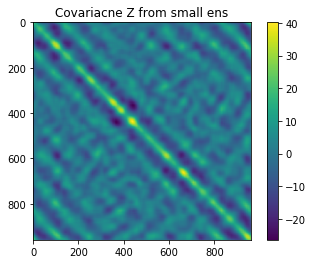

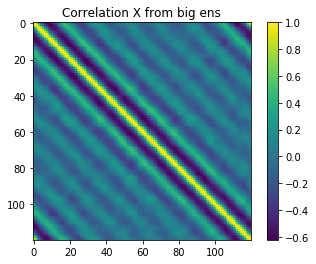

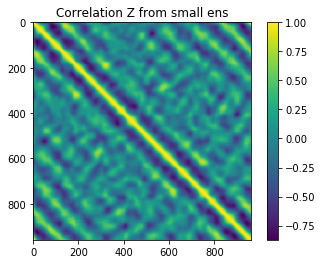

In [33]:
plt.figure()
im = plt.imshow(P_X)
plt.colorbar(im)
plt.title('Covariance X from big ens')

plt.figure()
im = plt.imshow(P_Z)
plt.colorbar(im)
plt.title('Covariacne Z from small ens')


plt.figure()
im = plt.imshow(C_X)
plt.colorbar(im)
plt.title('Correlation X from big ens')

plt.figure()
im = plt.imshow(C_Z)
plt.colorbar(im)
plt.title('Correlation Z from small ens')\

In [34]:
H_subgrid = np.eye(P_X.shape[0])
R_subgrid = 1 * np.eye(P_X.shape[0])
trans_mats = assimilate.transformation_matrices(
    H_subgrid, P=P_X,
    R=R_subgrid, return_Ts=True)

for key, val in trans_mats.items():
    key = key + '_X'
    print(key)
    exec(key + '=val')

P_sqrt_X
P_inv_sqrt_X
R_sqrt_X
R_inv_sqrt_X
U_X
S_X
VT_X
H_X
Tx_X
Tx_inv_X
Ty_X
Ty_inv_X


In [35]:
U_X_interp = np.repeat(U_X, coarse, axis=0)/np.sqrt(coarse)
VT_X_interp = np.repeat(VT_X, coarse, axis=1)/np.sqrt(coarse)

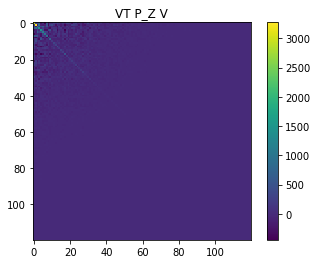

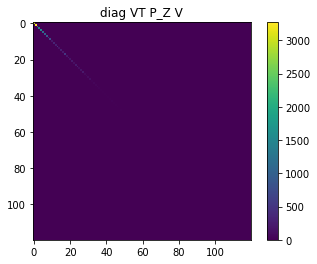

In [36]:
imshow(VT_X_interp @ P_Z @ VT_X_interp.T, title='VT P_Z V')

imshow(np.diag(np.diag(VT_X_interp @ P_Z @ VT_X_interp.T)), title='diag VT P_Z V')

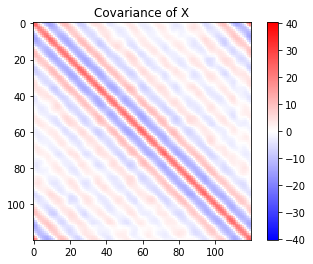

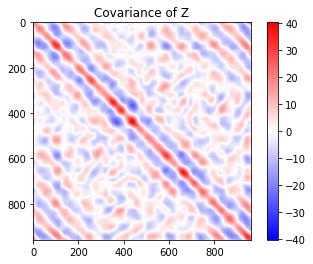

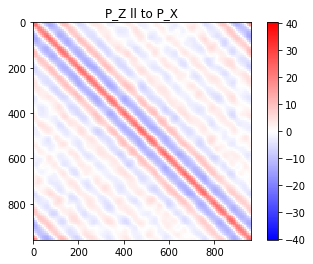

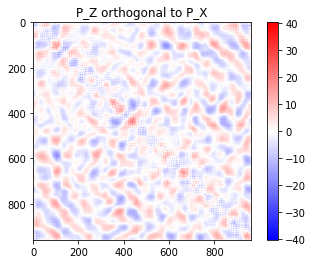

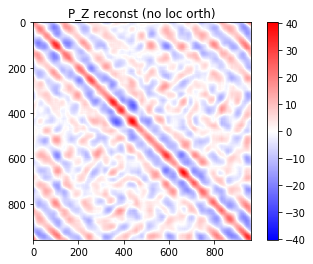

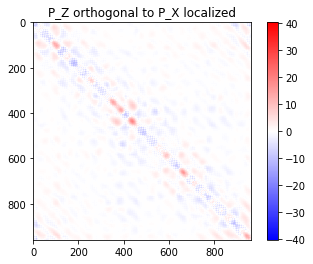

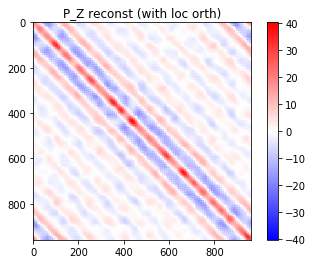

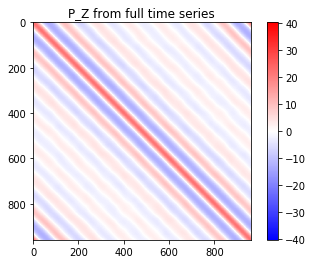

In [37]:
proj0 = VT_X_interp.T @ VT_X_interp

P_Z_ll_X = (VT_X_interp.T
        @ np.diag(np.diag(VT_X_interp @ P_Z @ VT_X_interp.T))
        @ VT_X_interp)
# P_Z_ll_X = proj0 @ P_Z @ proj0

proj = np.eye(N_Z) - proj0

D_inv_sqrt = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))

rho_Z_ll_X = D_inv_sqrt @ P_Z_ll_X @ D_inv_sqrt

P_Z_orth_X = P_Z - P_Z_ll_X

P_Z_orth_X_loc = rho_Z_ll_X * P_Z_orth_X

P_Z_reconst = P_Z_ll_X + P_Z_orth_X

P_Z_reconst_loc = P_Z_ll_X + P_Z_orth_X_loc

P_Z_GT = np.cov(Z)

vmax = np.max(
    [np.abs(P_Z).max(),
     np.abs(P_Z_ll_X).max(),
     np.abs(P_Z_orth_X).max(),
     np.abs(P_Z_reconst).max(),
     np.abs(P_Z_reconst_loc).max(), 
     np.abs(P_Z_GT).max()])
vmax_X = np.abs(P_X).max()

imshow(P_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of X')
imshow(P_Z, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Z')
imshow(P_Z_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z ll to P_X')
# imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
#        title='P_X - P_Z_ll')
imshow(P_Z_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X')
imshow(P_Z_reconst, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (no loc orth)')
imshow(P_Z_orth_X_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X localized')
imshow(P_Z_reconst_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (with loc orth)')
imshow(P_Z_GT, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z from full time series')

# Pushing Z ensemble forwad in time

In [15]:
def return_LM3_ens_data(Z0_ens, t, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    N_Z, N_eZ = Z0_ens.shape
    N_t = t.size
    def this_LM3(Z_1d_ens, t):
        Z_ens = Z_1d_ens.reshape(N_Z, N_eZ)
        dZdt = LM3(Z_ens, K=K, I=I, F=F, b=b, c=c, alpha=alpha, beta=beta)
        return dZdt.ravel()
    Z_ens_1d = integrate.odeint(this_LM3, Z0_ens.ravel(), t)
    Z_ens_1d = Z_ens_1d.T
    Z_ens_ts = Z_ens_1d.reshape(N_Z, N_eZ, N_t)
    return Z_ens_ts

In [22]:
T = 1
dt = 0.05
N_t = int(T/dt + 1)
t = np.linspace(0, T, N_t)

In [17]:
Z_ens_ts = return_LM3_ens_data(Z0_ens, t, K=K, I=I, F=F, b=b, c=c)

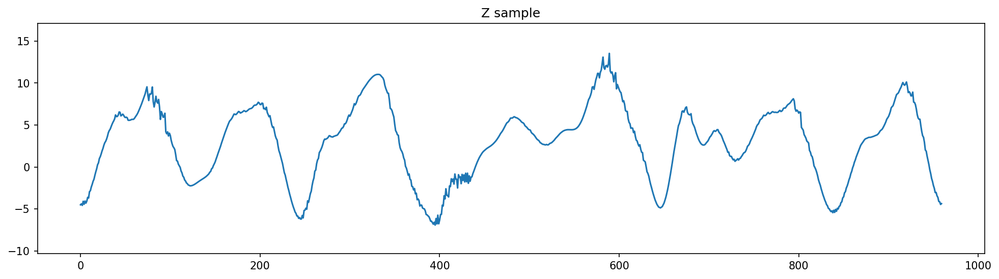

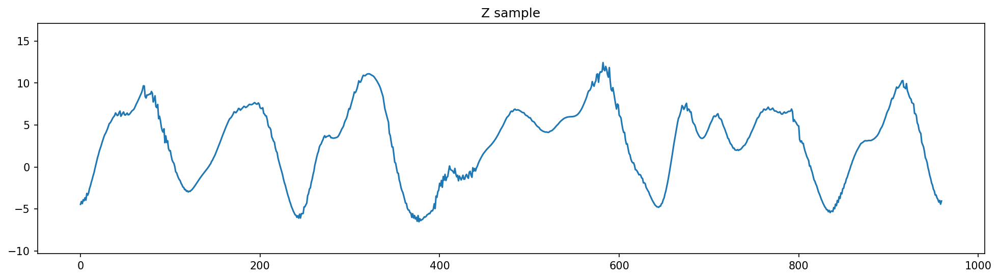

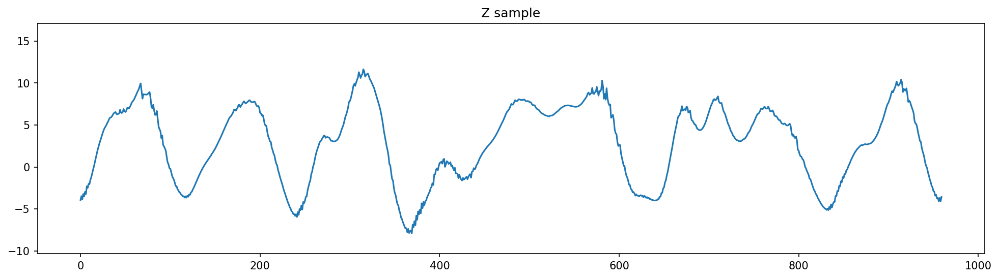

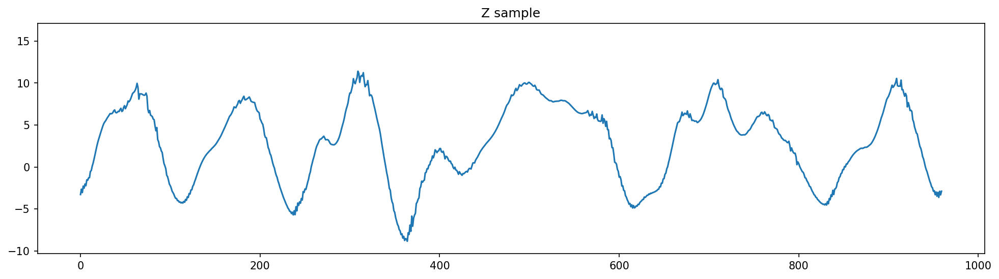

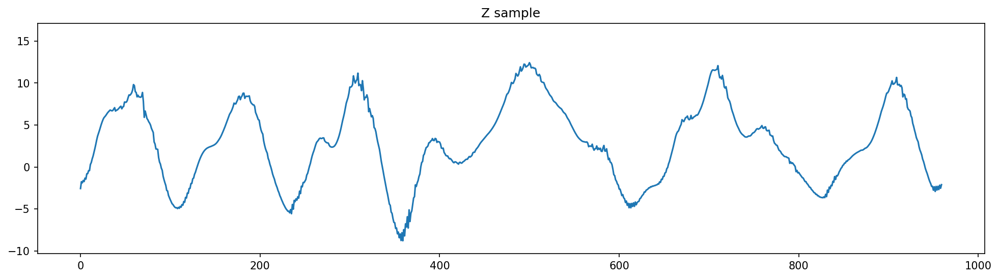

In [41]:
kk = 0
ymax=Z_ens_ts[:, kk, :].max()
ymin=Z_ens_ts[:, kk, :].min()
for ii in range(5): # range(Z0_ens.shape[1]): # 
#     ii = 5 * ii
    Z_to_plot = Z_ens_ts[:, kk, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.ylim([ymin, ymax])
    plt.plot(Z_to_plot)
    plt.title(f'Z sample')

# Pushing X ensemble forward in time with Lorenz model II

In [23]:
def LM2(X, K=32, F=15):
    N_X = X.shape[0]
    T1 = bracket([X], K)
    T2 = -1 * X
    dXdt = T1 + T2 + F
    return dXdt

In [24]:
def return_LM2_data(X0, t, K=32, F=15):
    N_X = X0.size
    def this_LM2(X, t):
        dXdt = LM2(X, K=K, F=F)
        return dXdt
    X = integrate.odeint(this_LM2, X0, t)
    X = X.T
    return X

In [25]:
def return_LM2_ens_data(X0_ens, t, K=32, F=15):
    N_X, N_eX = X0_ens.shape
    N_t = t.size
    def this_LM2(X_1d_ens, t):
        X_ens = X_1d_ens.reshape(N_X, N_eX)
        dXdt = LM2(X_ens, K=K, F=F)
        return dXdt.ravel()
    X_ens_1d = integrate.odeint(this_LM2, X0_ens.ravel(), t)
    X_ens_1d = X_ens_1d.T
    X_ens_ts = X_ens_1d.reshape(N_X, N_eX, N_t)
    return X_ens_ts

In [26]:
def return_LM2_ens_data(X0_ens, t, K=32, F=15):
    N_X, N_eX = X0_ens.shape
    N_t = t.size
    T0 = t[0]
    T = t[-1]
    dt = t[1] - t[0]
    X0_1d_ens = X0_ens.ravel()
    
    def this_LM2(t, X_1d_ens):
        X_ens = X_1d_ens.reshape(N_X, N_eX)
        dXdt = LM2(X_ens, K=K, F=F)
        return dXdt.ravel()
    LM2_ode = integrate.ode(this_LM2)
    LM2_ode.set_integrator('vode', method='adams') # method='bdf') # 
    LM2_ode.set_initial_value(X0_1d_ens, T0)
    t = [T0]
    X_ens_ts = [X0_ens]
    while LM2_ode.successful() and LM2_ode.t <= T:
        LM2_ode.integrate(LM2_ode.t + dt)
        t.append(LM2_ode.t)
        X_ens_ts.append(LM2_ode.y.reshape(N_X, N_eX))
    t = np.array(t)
    X_ens_ts = np.array(X_ens_ts)
    X_ens_ts = np.moveaxis(X_ens_ts, 0, -1)
    return t, X_ens_ts

In [22]:
# T = 1
# dt = 0.05
# N_t = int(T/dt + 1)
# t = np.linspace(0, T, N_t)

In [47]:
# t, X_ens_ts = return_LM2_ens_data(X0_ens, t, K=K_coar, F=F)

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


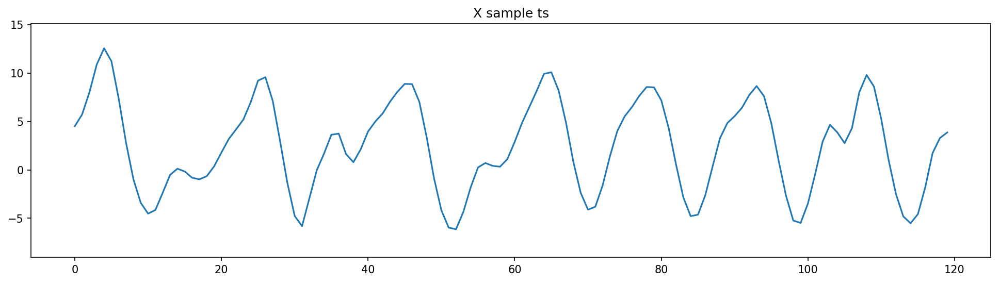

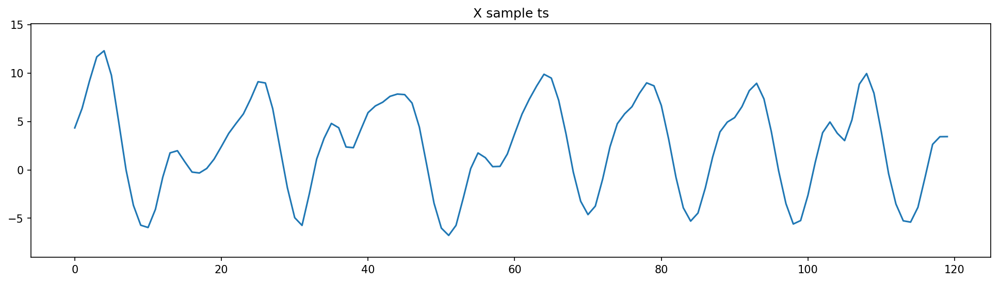

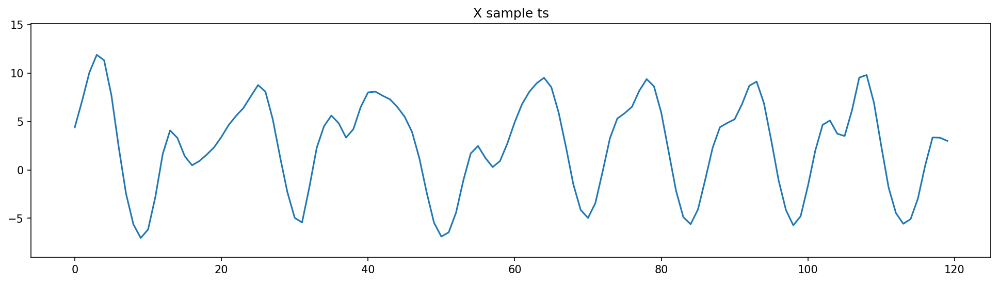

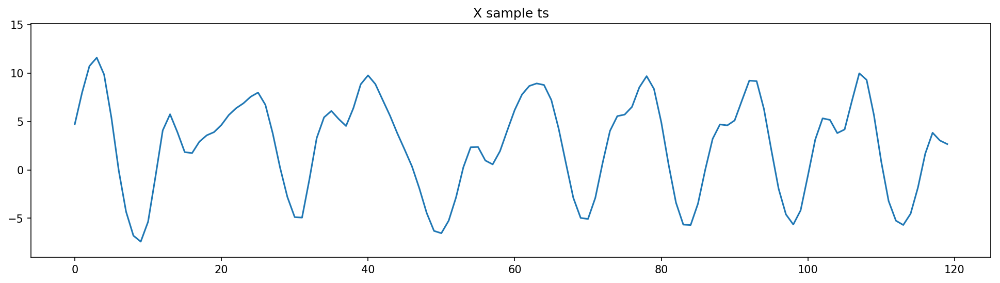

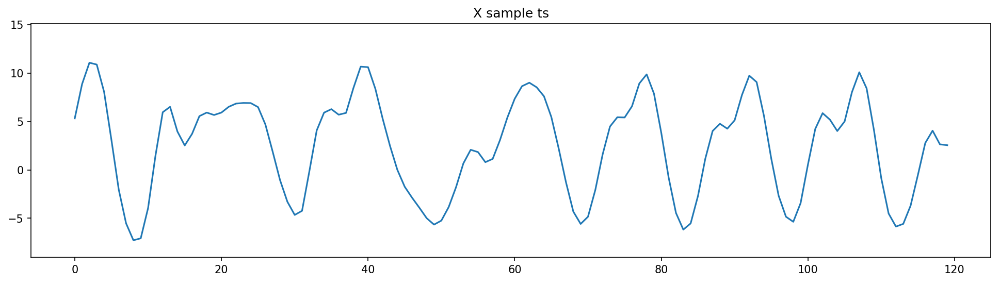

...

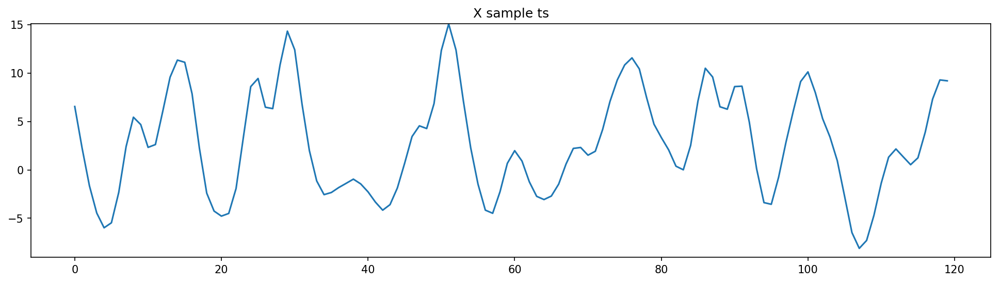

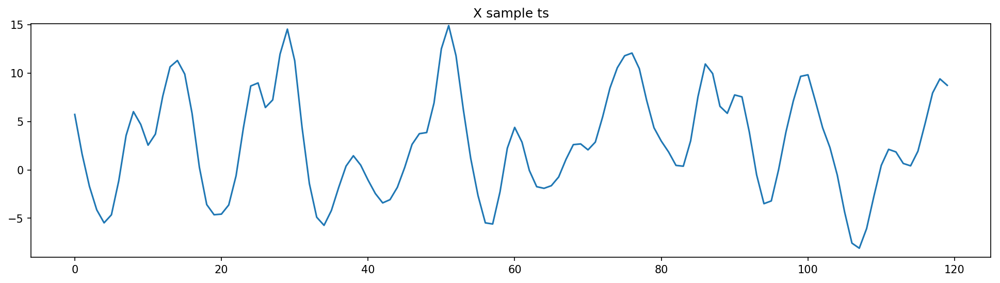

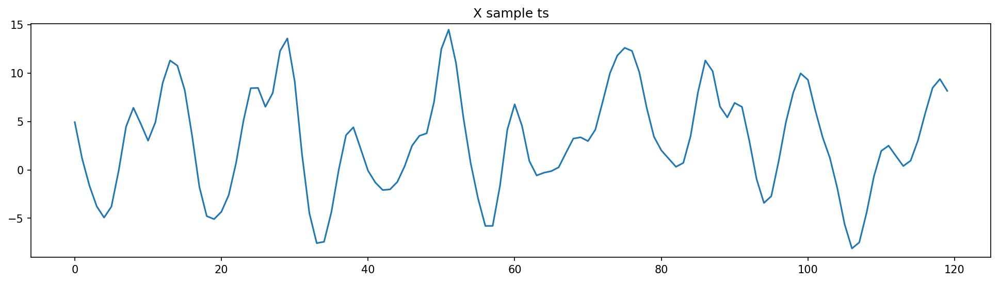

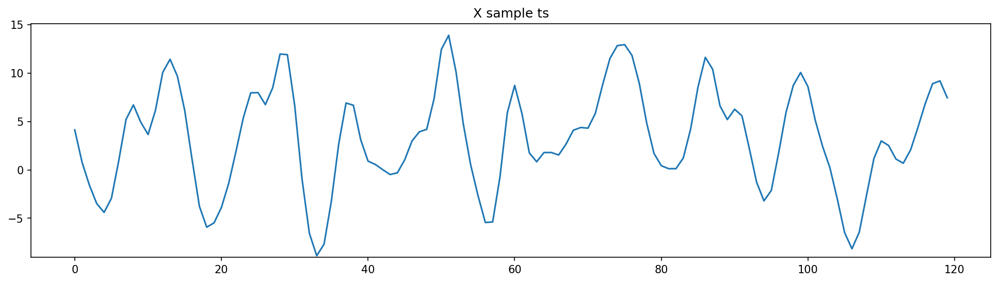

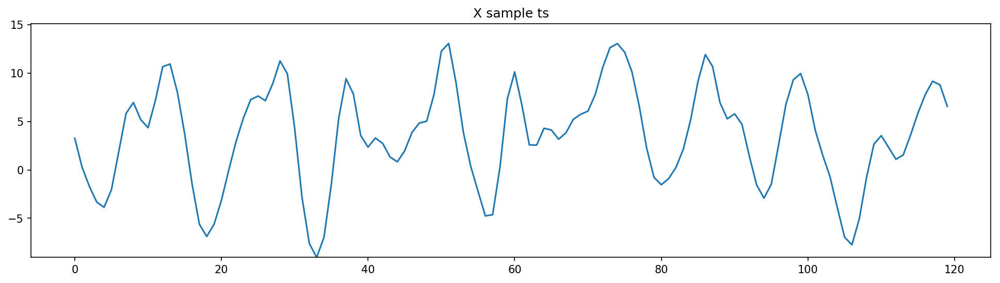

In [48]:
kk = 0
ymax=X_ens_ts[:, kk, :].max()
ymin=X_ens_ts[:, kk, :].min()
for ii in range(X_ens_ts.shape[-1]): # range(5): # 
#     ii = 5 * ii
    X_to_plot = X_ens_ts[:, kk, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.ylim([ymin, ymax])
    plt.plot(X_to_plot)
    plt.title(f'X sample ts')

# Generate Truth run

In [49]:
X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
X_interp = np.concatenate([X_interp, [X_interp[0]]])
x = np.arange(N_Z)
x_interp = x[::K]
x_interp = np.concatenate([x_interp, [x[-1] + 1]])
f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
X0 = f_X(x)

Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)

Z0 = X0 + X0*Y0/X0.max()

t = np.linspace(0, 20, 100)

Z = return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)

# use end of run as init

In [50]:
Z0 = Z[:, -1]

In [23]:
T = 1000
dt = 0.05
N = int(T/dt + 1)
t = np.linspace(0, T, N)

# long run to generate ensemble

In [27]:
# Z_GT = return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)

# np.save('./Z_GT.npy', Z_GT)
Z_GT = np.load('./Z_GT.npy')

In [28]:
# X_GT = window_sum_Z(Z_GT, I=I, alpha=alpha, beta=beta)
# Y_GT = Z_GT - X_GT

# np.save('./X_GT.npy', X_GT)
# np.save('./Y_GT.npy', Y_GT)

X_GT = np.load('./X_GT.npy')
Y_GT = np.load('./Y_GT.npy')

In [54]:
X_GT0 = window_sum_Z(Z_GT[:, 0], I=I, alpha=alpha, beta=beta)
X_GT0 = X_GT0[::coarse]

In [29]:
# X_coarse_GT = return_LM2_data(X_GT0, t, K=K_coar, F=F)

# np.save('./X_coarse_GT.npy', X_coarse_GT)
X_coarse_GT = np.load('./X_coarse_GT.npy')

In [285]:
X_not_Y_GT0 = window_sum_Z(Z_GT[:, 0], I=I, alpha=alpha, beta=beta)
X_not_Y_GT = return_LM2_data(X_not_Y_GT0, t, K=K, F=F)

In [53]:
Z0_ens.shape

(960, 20)

In [54]:
X0_ens.shape == X0_ens[:, 0].shape

False

In [305]:
this = window_sum_Z(Y_GT[:, :10], I=I, alpha=alpha, beta=beta)

In [311]:
def LM3_coar(X, Z, coarse, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    X_Z = window_sum_Z(Z, I=I, alpha=alpha, beta=beta)
    Y = Z - X_Z
    
    K_coar = K//coarse
    
    T1 = bracket([X], K_coar)
    T2 = b**2 * bracket([Y], 1)
    T2 = window_sum_Z(T2, I=I, alpha=alpha, beta=beta)
    T2 = T2[::coarse]
    T3 = c * bracket([Y, X_Z], 1)
    T3 = window_sum_Z(T3, I=I, alpha=alpha, beta=beta)
    T3 = T3[::coarse]
    T4 = -1 * X
    T5 = -b * Y
    T5 = window_sum_Z(T5, I=I, alpha=alpha, beta=beta)
    T5 = T5[::coarse]

    dXdt = T1 + T2 + T3 + T4 + T5 + F
    return dXdt

In [298]:
def return_LM3_coar_data(X0, t, Z, coarse=8, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    K_coar = K//coarse
    def this_LM3_coar(X, t):
        Z_index = int(np.floor(t/dt))
        print(Z_index)
        dXdt = LM3_coar(X, Z[:, Z_index], coarse=coarse, K=K, I=I, F=F, b=b, c=c, alpha=alpha, beta=beta)
        return dXdt
    X = integrate.odeint(this_LM3_coar, X0, t)
    X = X.T
    return X


def return_LM3_coar_ens_data(X0_ens, t, Z0_ens_ts, coarse=8, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    K_coar = K//coarse
    
    N_t = t.size
    N_Xc, N_eXc = X0_ens.shape
    N_Z, N_eZ = Z0_ens.shape
    N_eXpZ = N_eXc // N_eZ
    N_ZpX = N_Z // N_Xc
    
    X_ens = np.ones([N_Xc, N_eXc, N_t])
    
    for ens_count in range(N_eZ):
        def this_LM3_coar(X_ens_ravel, t):
            Z_index = int(np.floor(t/dt))
            X_ens = X_ens_ravel.reshape(N_Xc, N_eXpZ)
            dXdt = LM3_coar(X_ens,
                            Z0_ens_ts[:, ens_count, Z_index][:, None],
                            coarse=coarse,
                            K=K, I=I, F=F,
                            b=b, c=c,
                            alpha=alpha, beta=beta)
            return dXdt.ravel()
        this_slice = slice(ens_count*N_eXpZ, (ens_count+1)*N_eXpZ)
        aX_ens = integrate.odeint(this_LM3_coar, X0_ens[:, this_slice].ravel(), t)
        aX_ens = aX_ens.T
        aX_ens = aX_ens.reshape(N_Xc, N_eXpZ, N_t)
        X_ens[:, this_slice, :] = aX_ens
    return X_ens

In [312]:
this_t = t[:100]
X_LM3_coar = return_LM3_coar_data(
    X_coarse_GT[:, 0], this_t, Z_GT, coarse=coarse, K=K, I=I, F=F, b=b, c=c, alpha=alpha, beta=beta)

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
1
1
1
1
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
1
1
1
1
1
1
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
2
2
2
2
3
3
3
3
2
2
2
2
2
2
2
3
3
3
3
2
2
3
3
2
2
2
2
3
3
3
3
2
2
2
2
3
3
3
3
3
3
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4


# Assimilate first obs

In [83]:
Z_obs = Z_GT[::every_Z_obs, 0]
this = np.random.multivariate_normal(Z_obs, R, N_eZ).T

In [84]:
this.shape

(120, 20)

In [78]:
H_subgrid = np.eye(N_Z//coarse)
R_subgrid = 1 * np.eye(N_Z//coarse)
every_Z_obs = 8
H = np.eye(N_Z)[::every_Z_obs]
R = 1 * np.eye(N_Z//every_Z_obs)

In [222]:
[this_loc] = covariance.generate_circulant(N_Z, 1, rho0=50,
                                         correlation_fun=covariance.fft_sqd_exp_1d, return_eig=False,
                                         return_Corr=True)

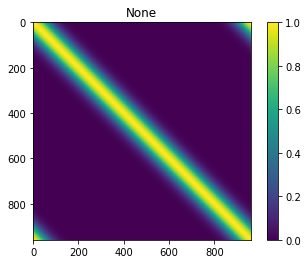

In [223]:
imshow(this_loc)

In [274]:
def loc_enkf(X_ens_input, Z_ens_input, Z_obs_input, H, R, a=None, rho=None):
    X_ens = X_ens_input.copy()
    Z_ens = Z_ens_input.copy()
    Z_obs = Z_obs_input.copy()
    N_Z, N_eZ = Z_ens.shape
    P_X = np.cov(X_ens) 
    
    trans_mats = assimilate.transformation_matrices(
        H_subgrid, P=P_X,
        R=R_subgrid, return_Ts=True)
    VT_X = trans_mats['VT']
    x = np.arange(N_Z)
    x_coarse = x[::coarse]
    x_coarse = np.concatenate([x_coarse, [x_coarse[-1] + coarse]])
    VT_X = np.concatenate([VT_X, VT_X[:, 0][:, None]], axis=1)
    f = interpolate.interp1d(x_coarse, VT_X, axis=-1)
    VT_X_interp = f(x)/np.sqrt(coarse)
    #     VT_X_interp = np.repeat(VT_X, coarse, axis=1)/np.sqrt(coarse)
    
    # update Z
    P_Z = np.cov(Z_ens)
#     if a is not None:
#         P_Z *= (1 + a)
#         imshow(P_Z)
#         mu_Z = np.mean(Z_ens, axis=-1)
#         Z_ens -= mu_Z[:, None]
#         Z_ens *= np.sqrt(1 + a)
#         Z_ens += mu_Z[:, None]
#     if rho is not None:
#         P_Z *= rho
    P_Z_ll_X = (VT_X_interp.T
            @ np.diag(np.diag(VT_X_interp @ P_Z @ VT_X_interp.T))
            @ VT_X_interp)
    D_inv_sqrt = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))
    rho_Z_ll_X = D_inv_sqrt @ P_Z_ll_X @ D_inv_sqrt
    P_Z_orth_X = P_Z - P_Z_ll_X
    P_Z_orth_X_loc = rho_Z_ll_X * P_Z_orth_X
    P_Z_orth_X_loc *= 0
    P_Z_loc = P_Z_ll_X + P_Z_orth_X_loc
#     K = P_Z_loc @ H.T @ np.linalg.inv(H @ P_Z_loc @ H.T + R)
#     K = P_Z @ H.T @ np.linalg.inv(H @ P_Z @ H.T + R)
    
    imshow(P_Z)
    imshow(P_Z_loc)
    
    
    temp1 = (R + H.dot(P_Z_loc.dot(H.T))).T
    temp2 = H.dot(P_Z_loc.T)
    K = np.linalg.solve(temp1, temp2).T
    Z_obs_ens = np.random.multivariate_normal(Z_obs, R, N_eZ).T

    
    Z_ens = Z_ens + K @ (Z_obs_ens - H @ Z_ens)
    
    # update X
    K = P_X @ np.linalg.inv(P_X + R)
    X_obs_ens = np.random.multivariate_normal(Z_obs, R, N_eX).T
    X_ens = X_ens + K @ (X_obs_ens - X_ens)   
    
    
    X_to_return = X_ens.copy()
    Z_to_return = Z_ens.copy()
    return X_to_return, Z_to_return

(120, 120)


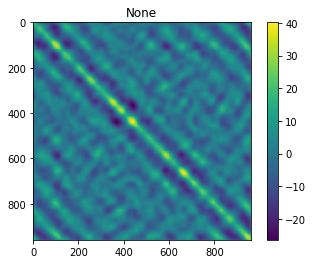

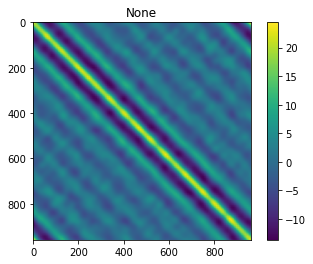

In [275]:
H_subgrid = np.eye(N_Z//coarse)
R_subgrid = 1 * np.eye(N_Z//coarse)
every_Z_obs = coarse
H = np.eye(N_Z)[::every_Z_obs]
R = .1 * np.eye(N_Z//every_Z_obs)

Z_obs = np.random.multivariate_normal(Z_GT[::every_Z_obs, 0], R)


X_ens_a, Z_ens_a = loc_enkf(X0_ens, Z0_ens, Z_obs, H, R, a=1, rho=this_loc)

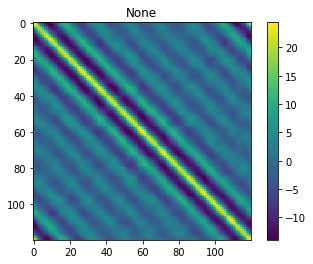

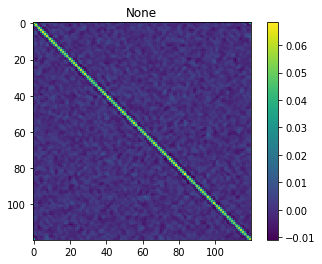

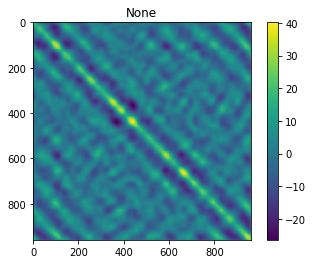

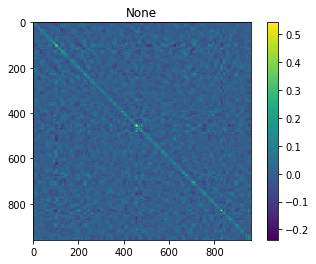

In [276]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f)
imshow(P_X_a)
imshow(P_Z_f)
imshow(P_Z_a)

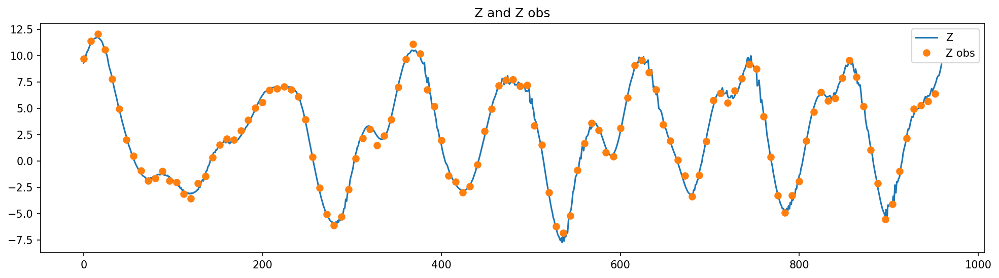

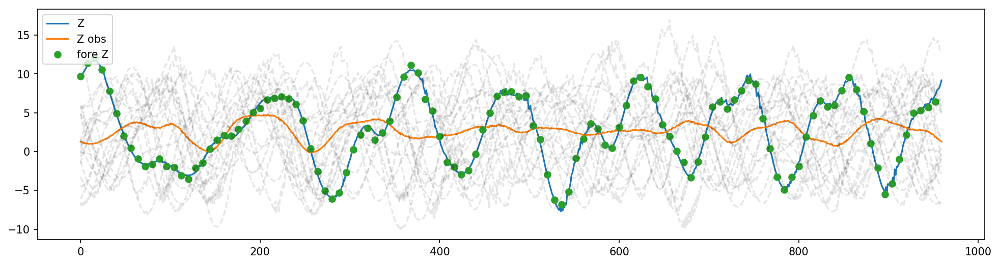

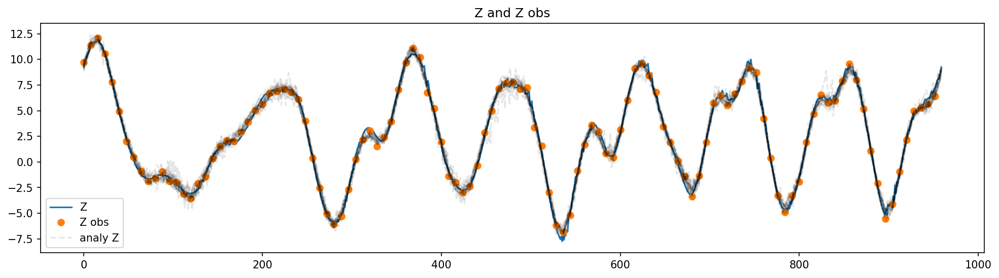

In [277]:
x = np.arange(N_Z)
x_coarse = x[::coarse]
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.title(f'Z and Z obs')
plt.legend(['Z', 'Z obs'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(np.mean(Z0_ens, axis=-1))
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(Z0_ens, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(Z_ens_a, 'k--', alpha=.1)
plt.title(f'Z and Z obs')
plt.legend(['Z', 'Z obs', 'analy Z'])

(0, 100)

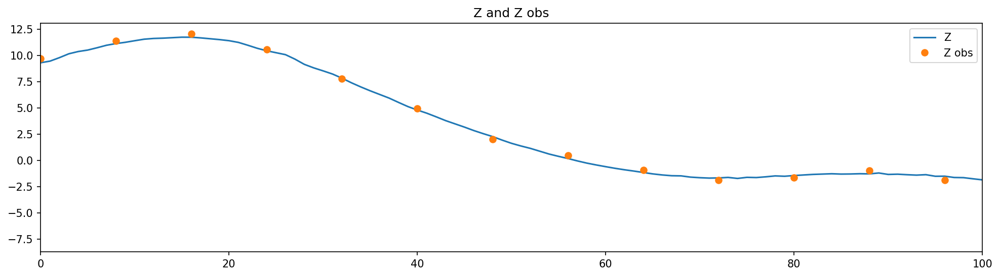

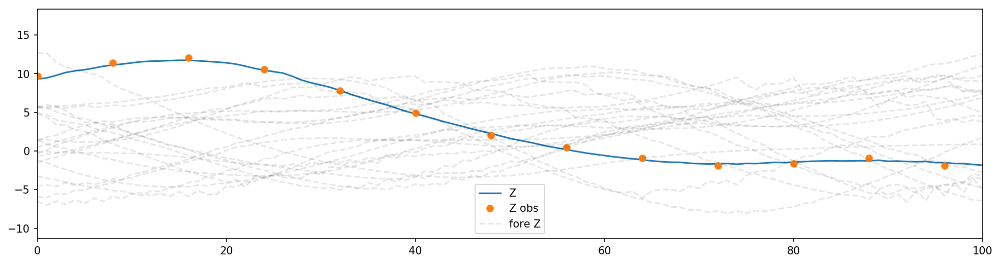

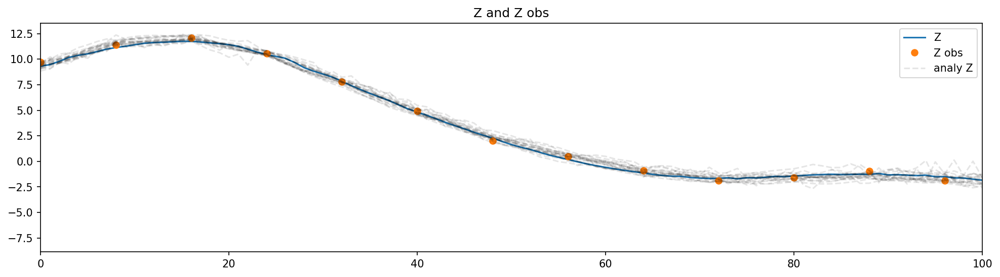

In [278]:
xmin = 0
xmax = 100

x = np.arange(N_Z)
x_coarse = x[::coarse]
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.title(f'Z and Z obs')
plt.legend(['Z', 'Z obs'])
plt.xlim([xmin, xmax])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(Z0_ens, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore Z'])
plt.xlim([xmin, xmax])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(Z_ens_a, 'k--', alpha=.1)
plt.title(f'Z and Z obs')
plt.legend(['Z', 'Z obs', 'analy Z'])
plt.xlim([xmin, xmax])

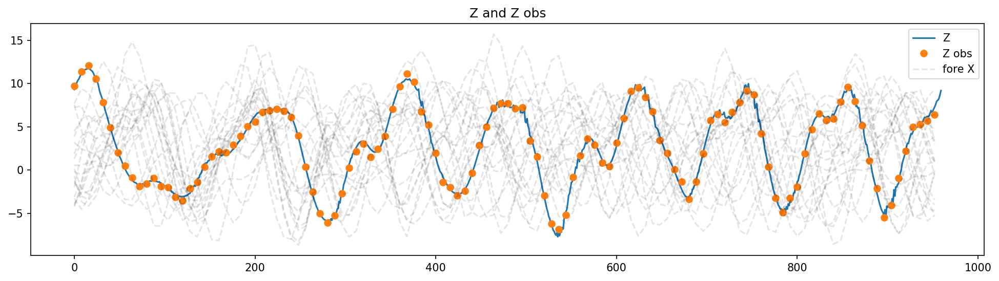

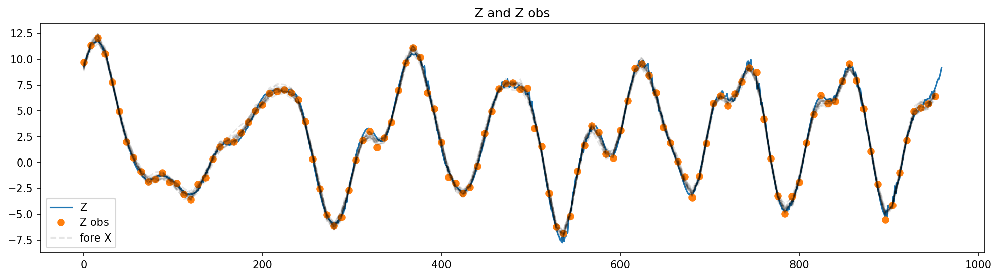

In [279]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(x_coarse, X0_ens[:, ::25], 'k--', alpha=.1)
plt.title(f'Z and Z obs')
plt.legend(['Z', 'Z obs', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(x_coarse, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.title(f'Z and Z obs')
plt.legend(['Z', 'Z obs', 'fore X'])

In [69]:
X_coar_ens_ts = return_LM3_coar_ens_data(
    X0_ens, t[0: 20], Z_ens_ts, coarse=coarse, K=K, I=I, F=F, b=b, c=c, alpha=alpha, beta=beta)

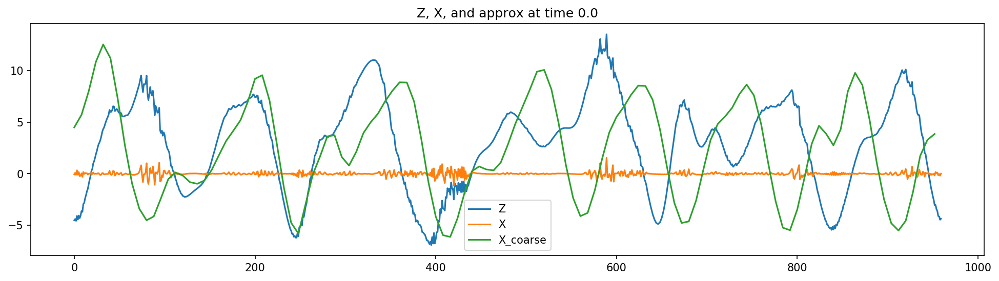

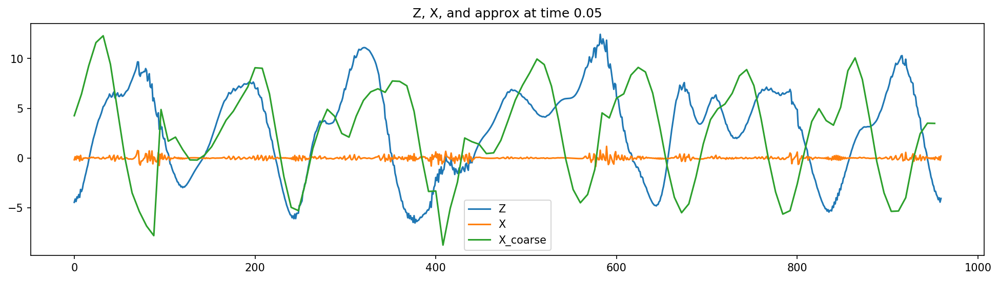

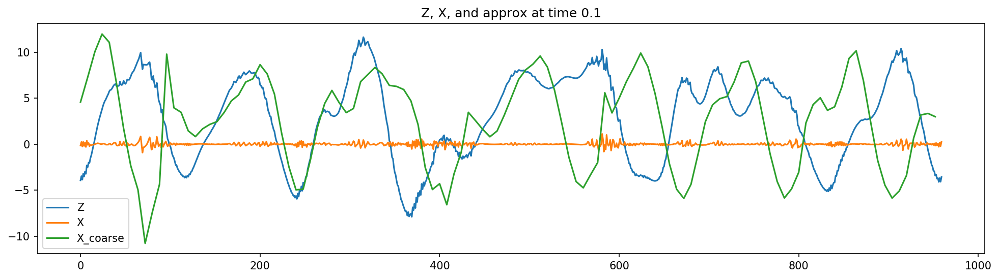

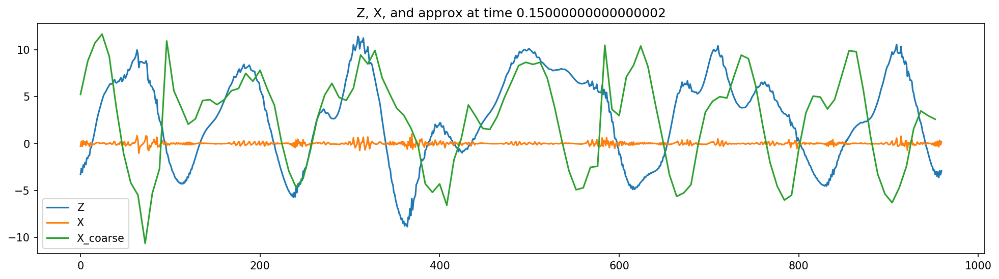

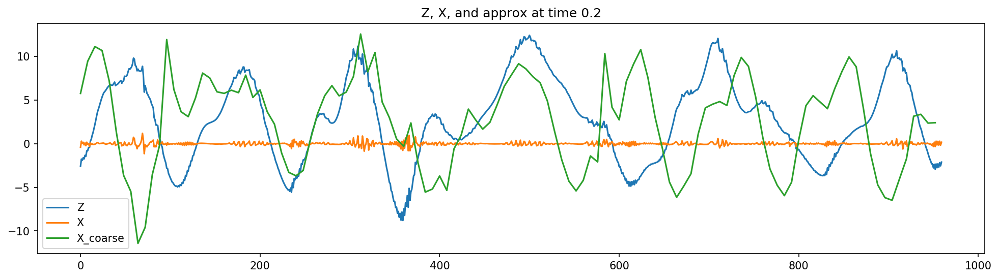

...

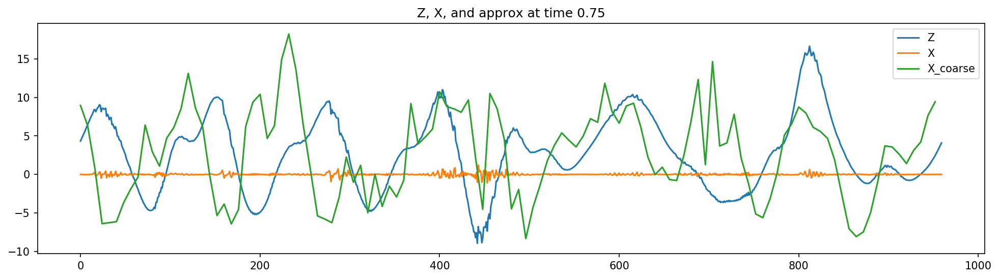

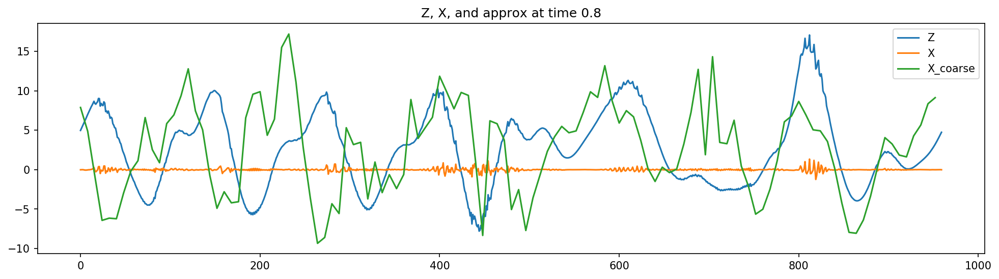

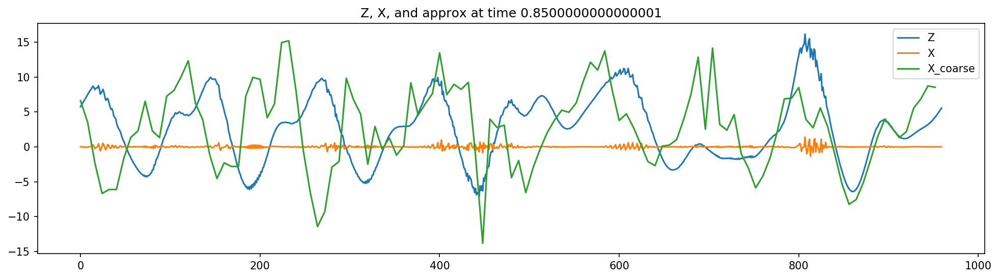

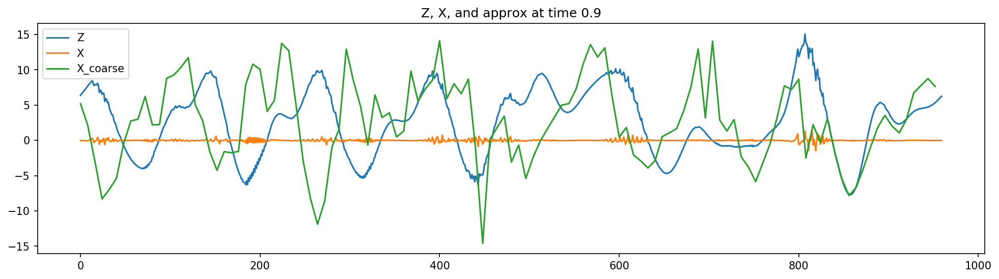

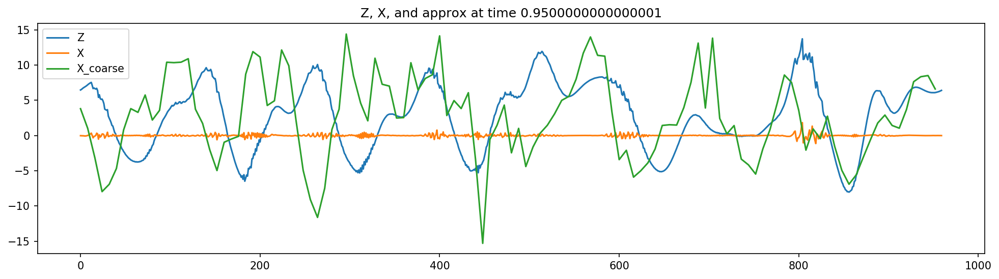

In [71]:
num_steps = 20
ens_num = 0
z_ens_num = int(np.floor(ens_num/(N_eX/N_eZ)))
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    X_to_plot = X_coar_ens_ts[:, ens_num, ii]
    Z_to_plot = Z_ens_ts[:, z_ens_num, ii]
    Y_to_plot = window_sum_Z(Z_to_plot, I=I, alpha=alpha, beta=beta)
    Y_to_plot = Z_to_plot - Y_to_plot
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(Y_to_plot)
    plt.plot(np.arange(0, N_Z, coarse), X_to_plot)
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X_coarse', 'X_LM3_coar'])

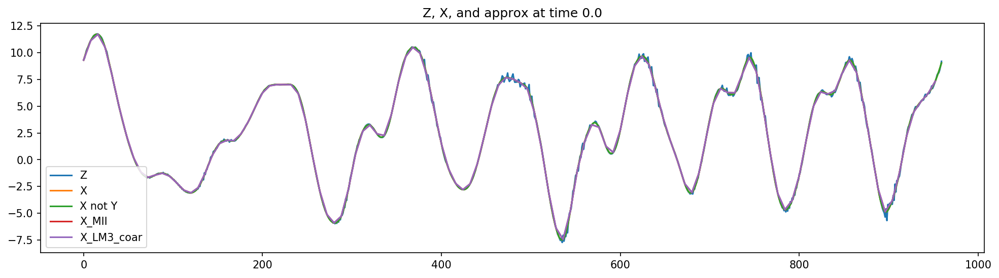

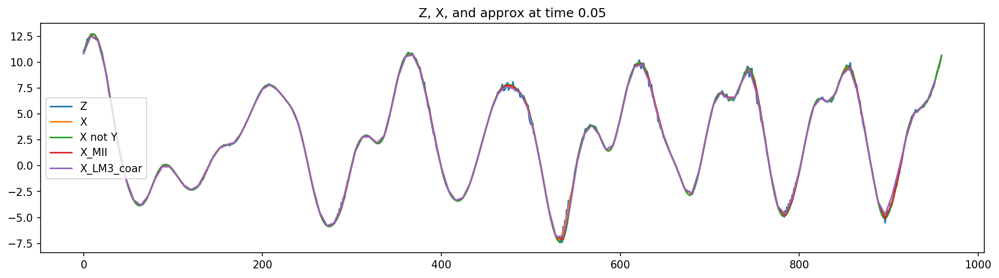

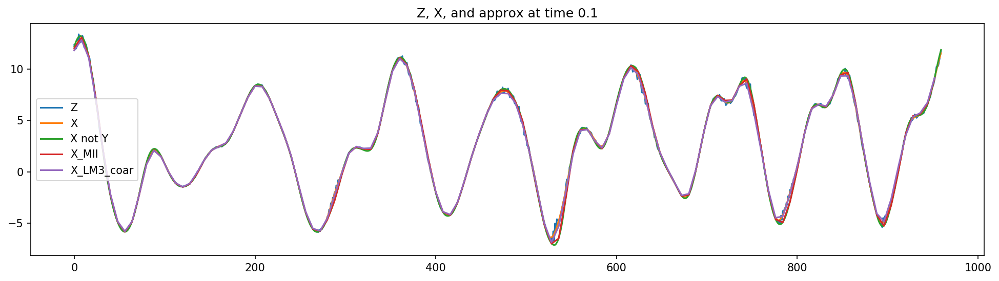

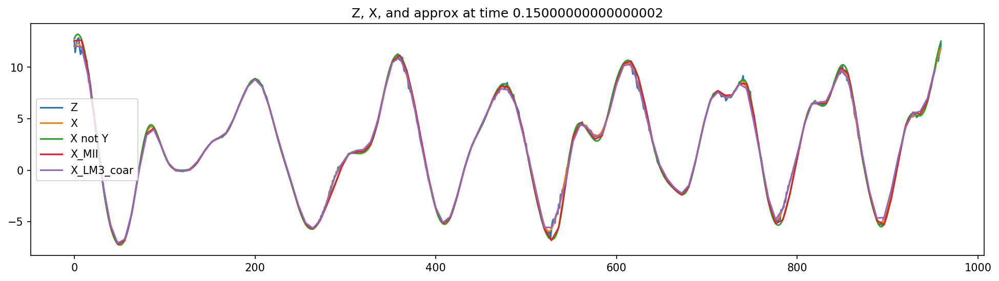

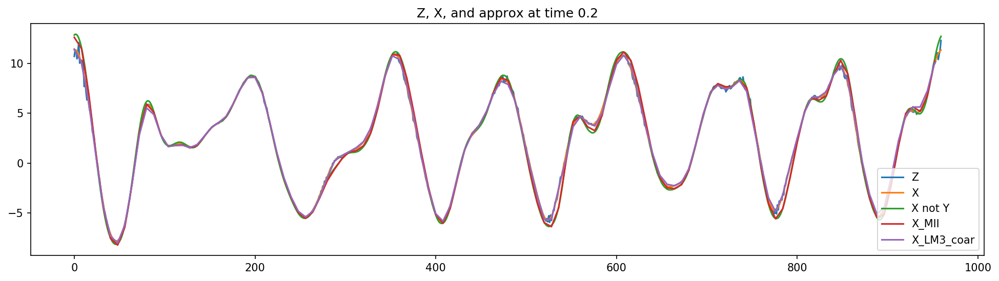

...

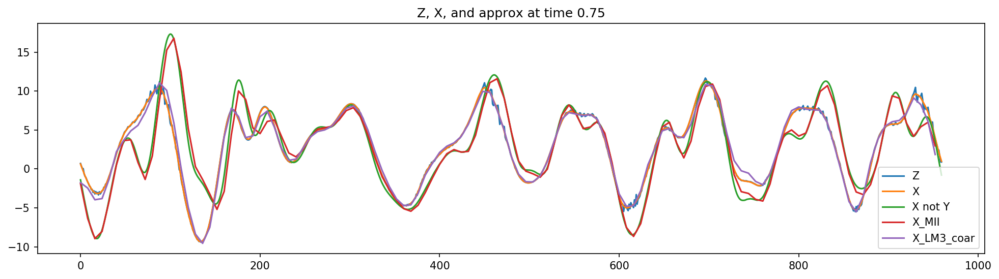

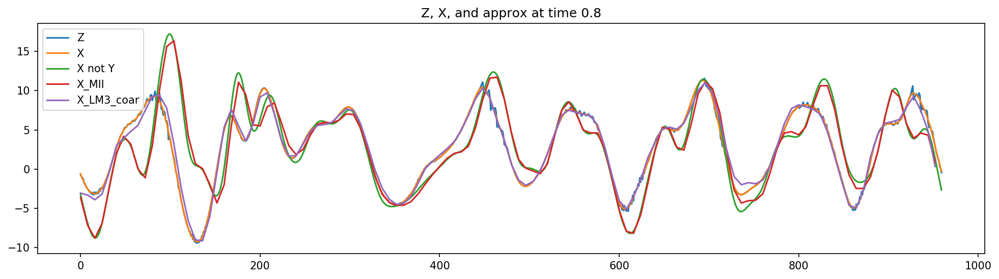

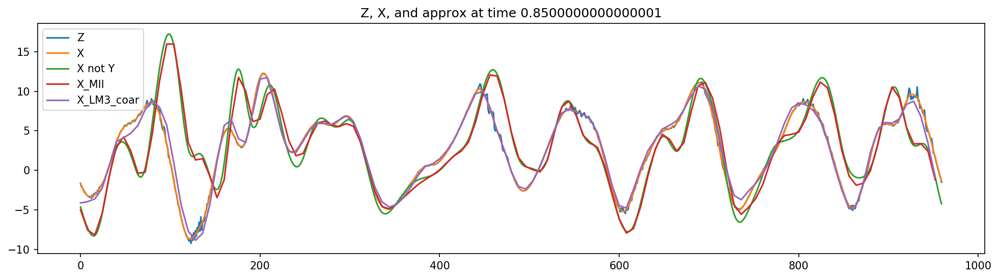

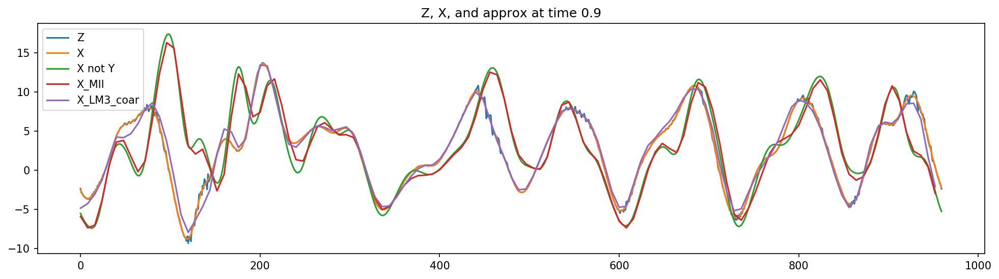

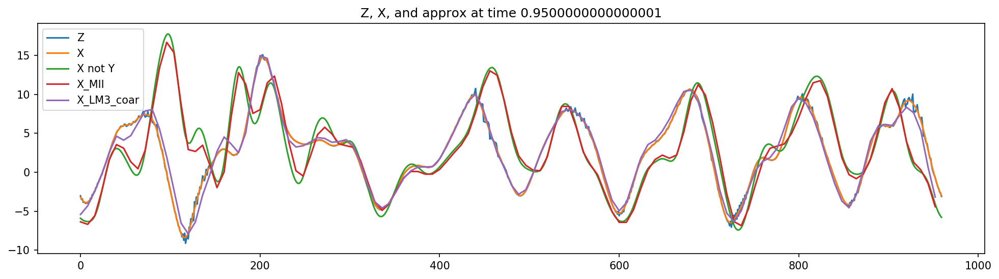

In [313]:
num_steps = 20
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z_GT[:, ii]
    X_to_plot = X_GT[:, ii]
    X_coarse_to_plot = X_coarse_GT[:, ii]
    X_LM3_coar_to_plot = X_LM3_coar[:, ii]
    X_not_Y_to_plot = X_not_Y_GT[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(X_not_Y_to_plot)
        
    plt.plot(x[::8], X_coarse_to_plot)
    plt.plot(x[::8], X_LM3_coar_to_plot)
    
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X not Y', 'X_MII', 'X_LM3_coar'])

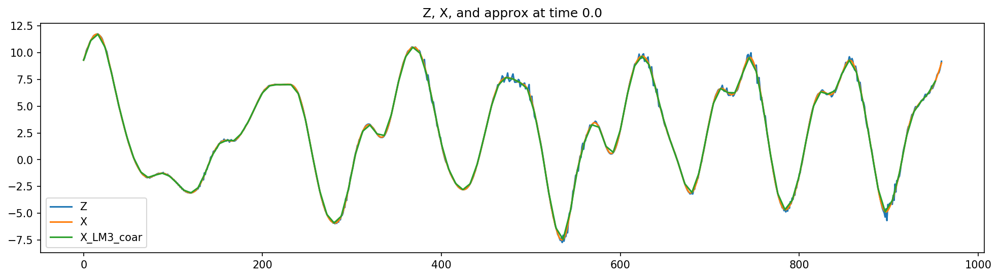

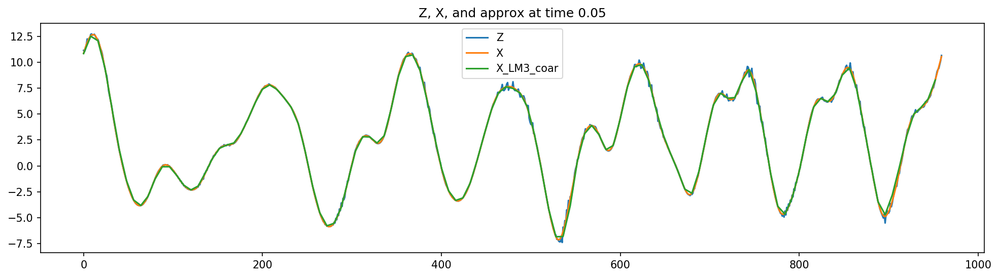

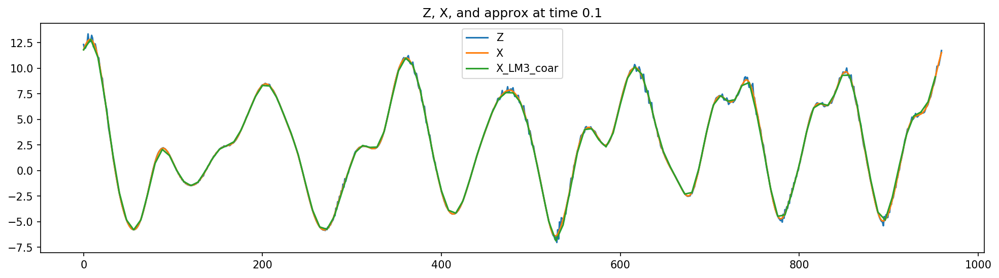

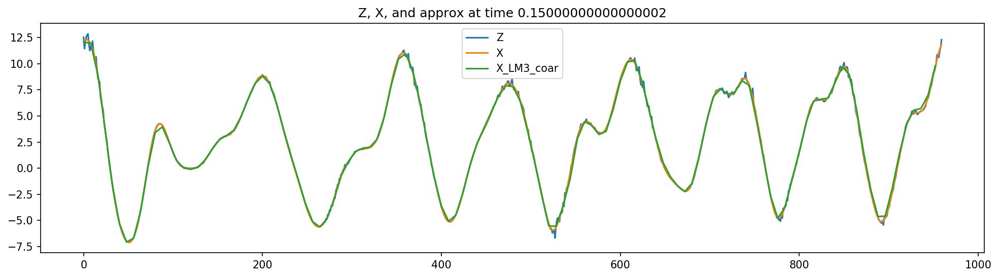

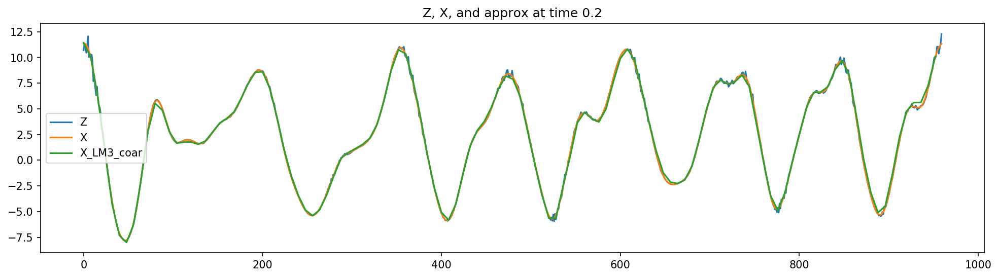

...

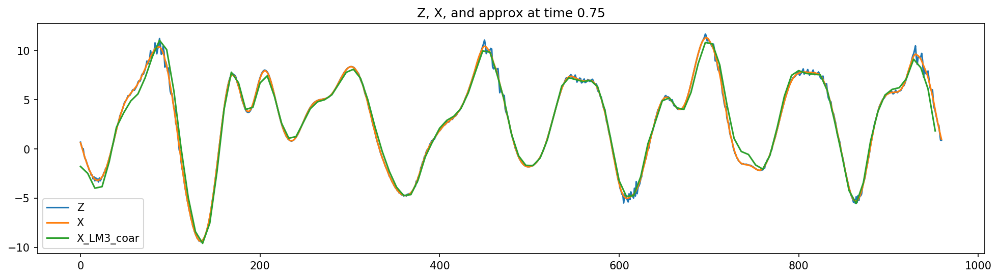

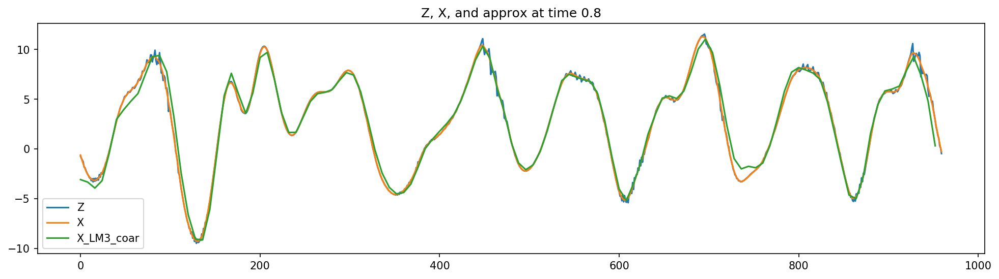

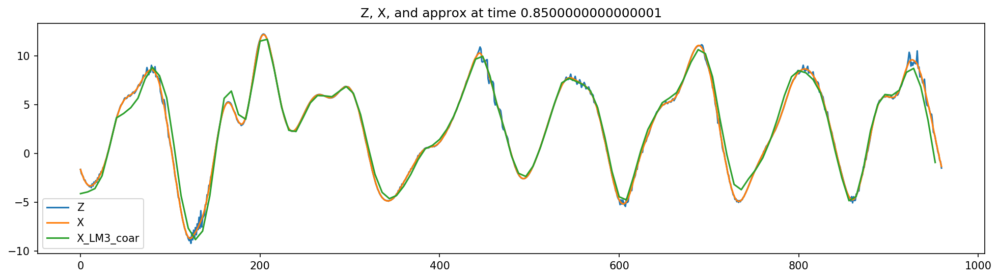

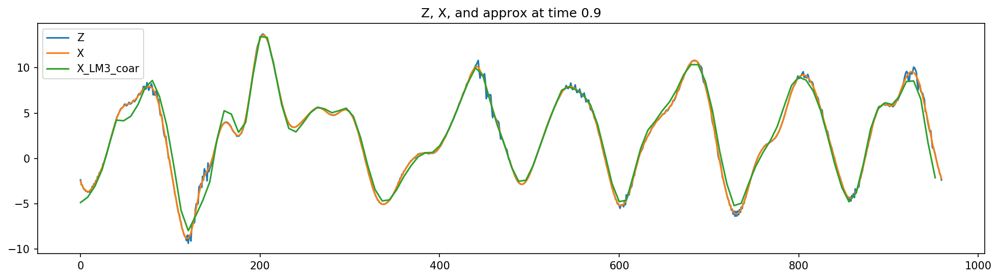

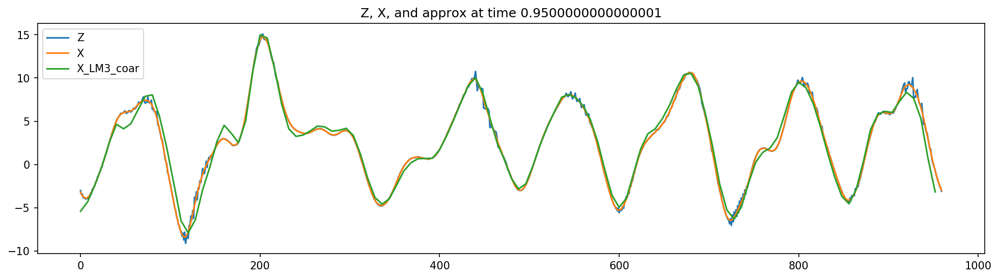

In [314]:
num_steps = 20
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z_GT[:, ii]
    X_to_plot = X_GT[:, ii]
    X_LM3_coar_to_plot = X_LM3_coar[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(x[::8], X_LM3_coar_to_plot)
    
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X_LM3_coar'])

In [315]:
def LM3_return_terms(Z, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    X = window_sum_Z(Z, I=I, alpha=alpha, beta=beta)
    Y = Z - X
    
    BXXK = bracket([X], K)
    BYY = b**2 * bracket([Y], 1)
    BYX = c * bracket([Y, X], 1)
    nX = -1 * X
    nY = -b * Y
    
    dZdt = BXXK + BYY + BYX + nX + nY + F
    return dZdt, BXXK, BYY, BYX, nX, nY, F

In [316]:
dZdt, BXXK, BYY, BYX, nX, nY, F = LM3_return_terms(Z_GT, K=K, I=I, F=F, b=b, c=c)

In [317]:
BXXK.shape

(960, 20001)

In [318]:
dZdt.shape

(960, 20001)

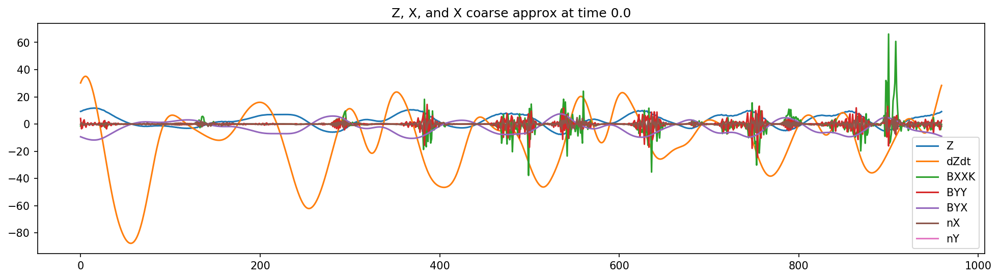

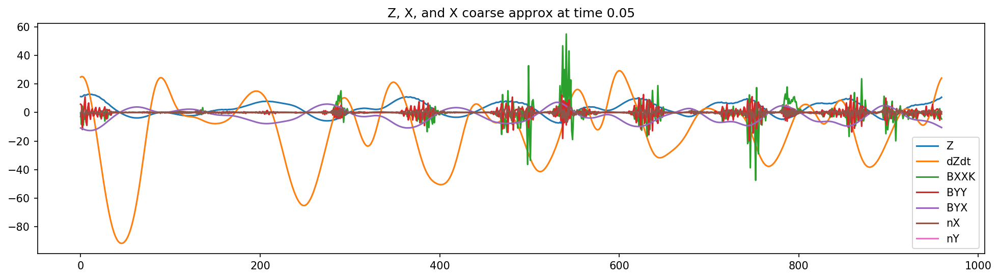

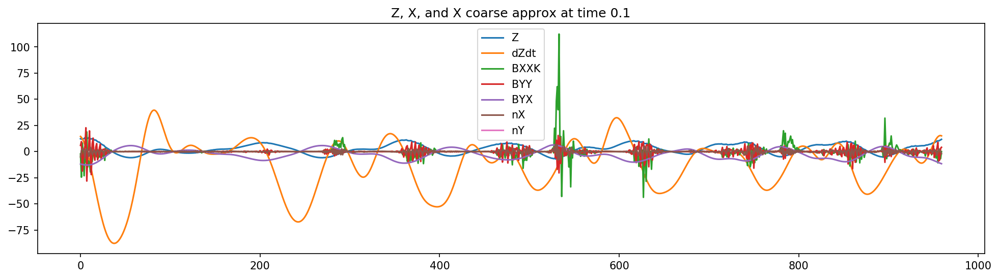

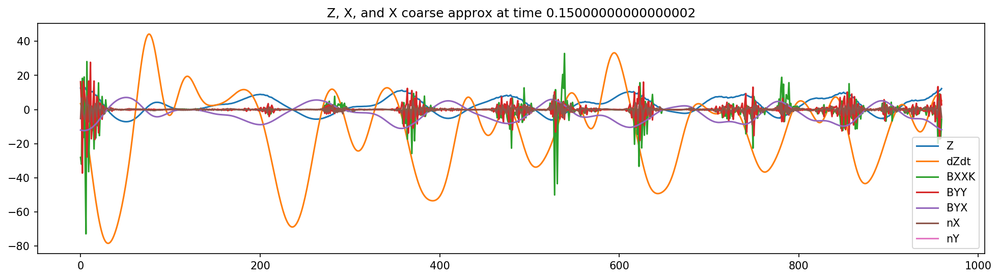

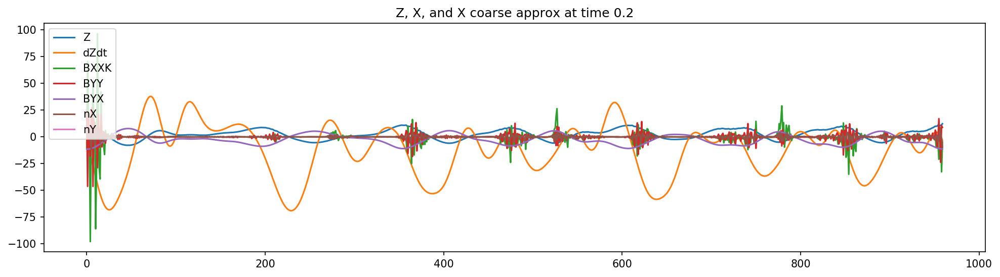

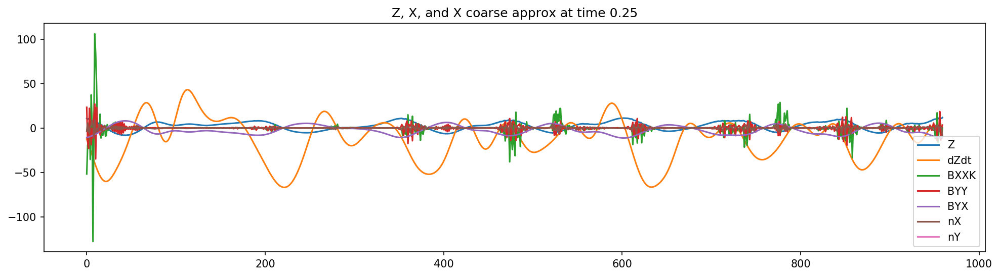

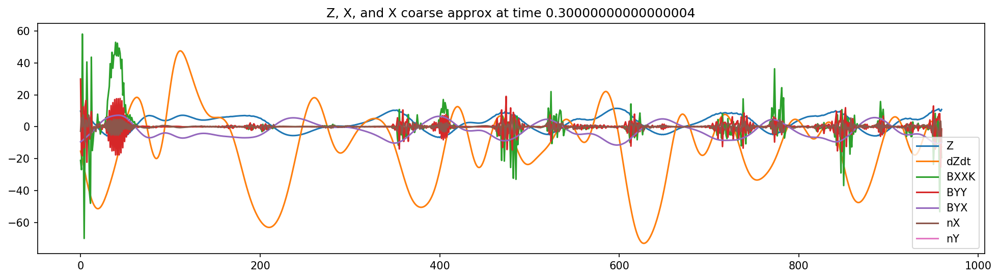

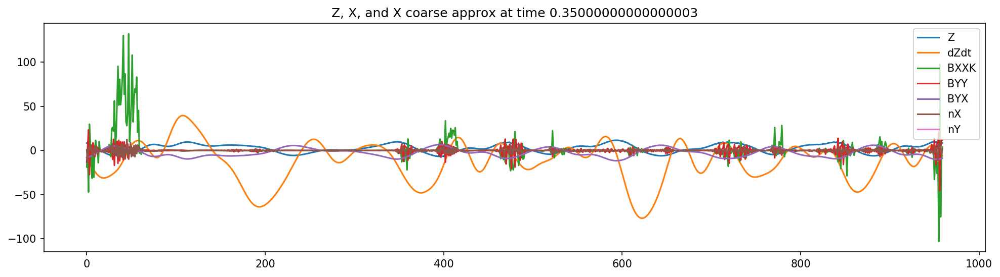

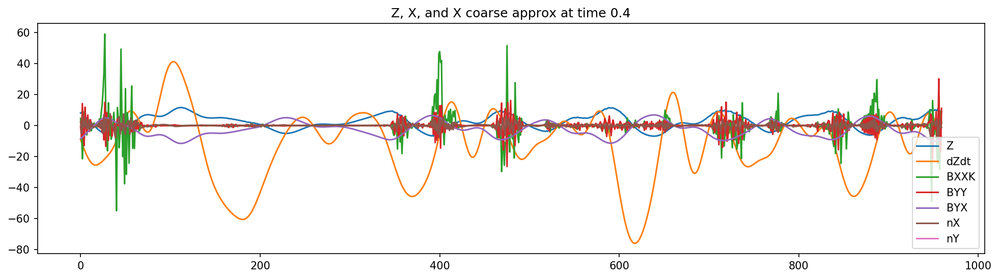

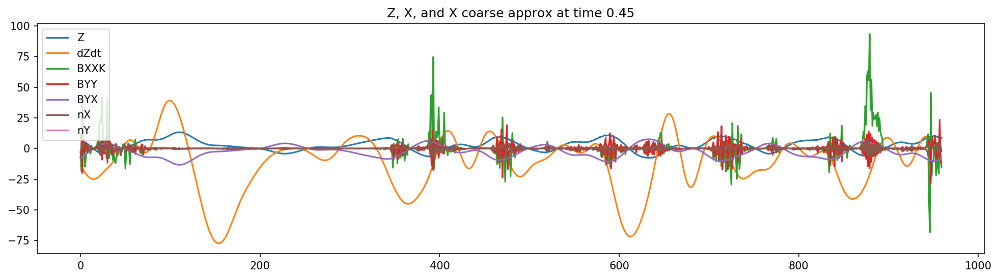

In [319]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_GT[:, ii])
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F)
    plt.title(f'Z, X, and X coarse approx at time {t[ii]}')
    plt.legend(['Z', 'dZdt', 'BXXK', 'BYY', 'BYX', 'nX', 'nY', F])

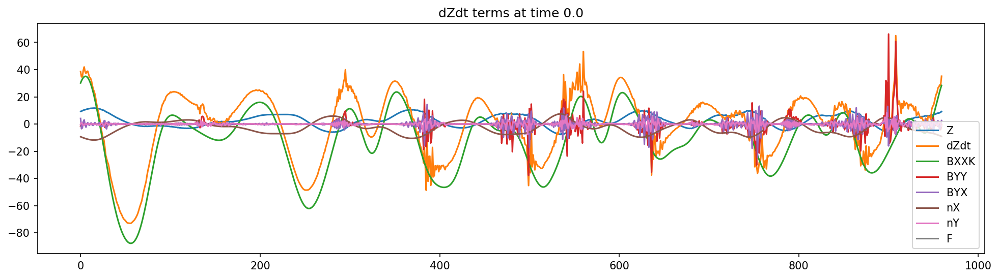

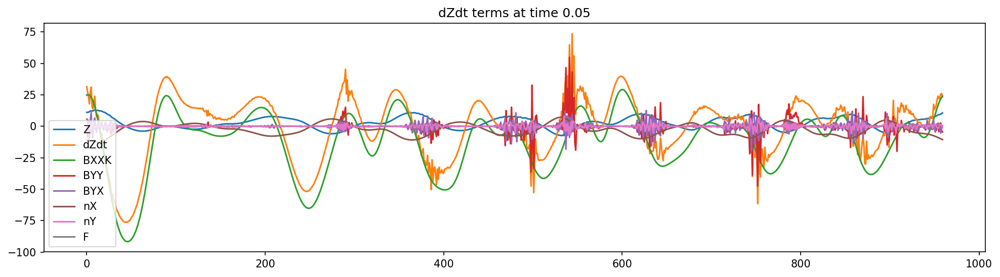

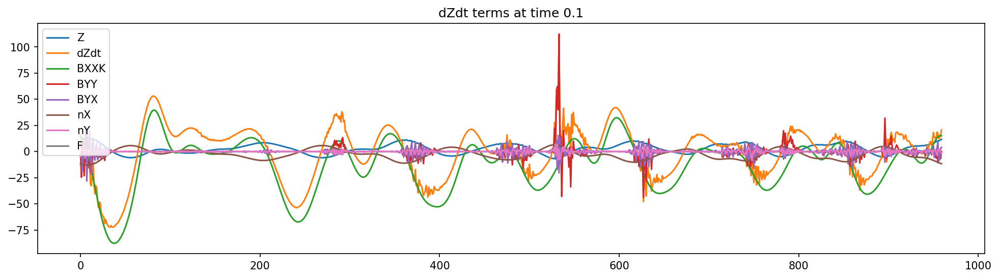

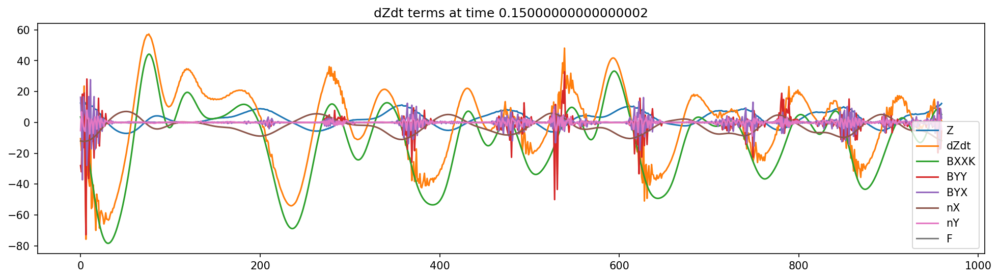

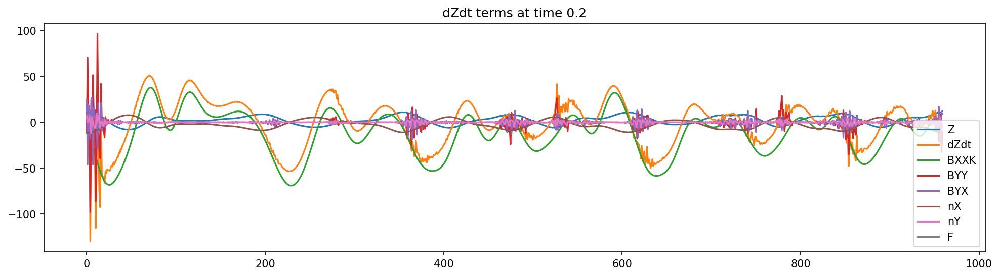

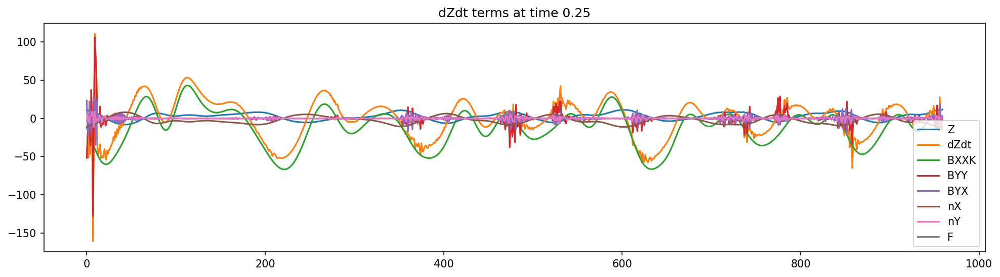

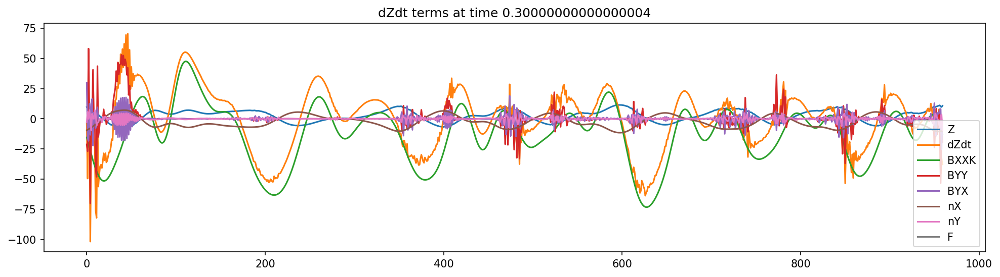

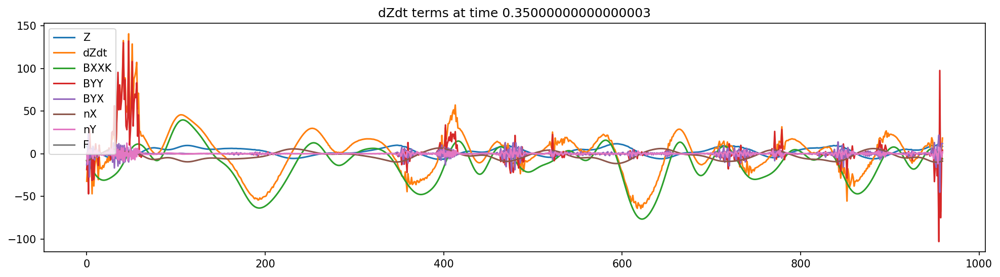

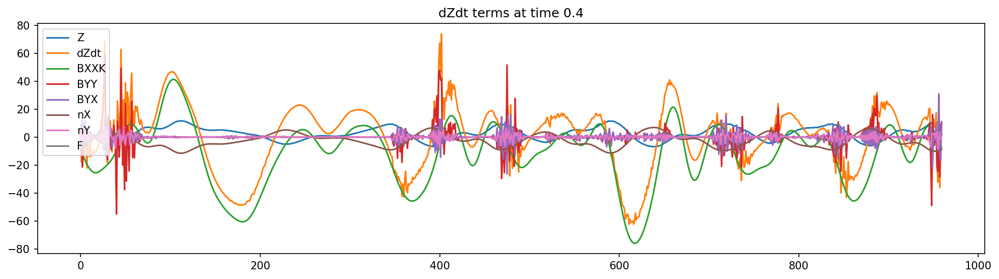

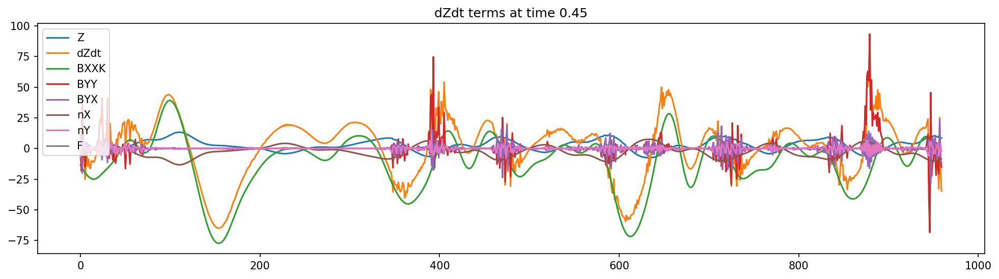

In [320]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_GT[:, ii])
    plt.plot(dZdt[:, ii])
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F)
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['Z', 'dZdt', 'BXXK', 'BYY', 'BYX', 'nX', 'nY', 'F'])

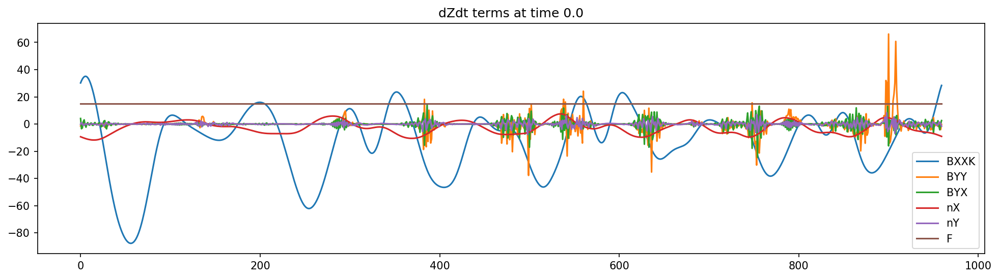

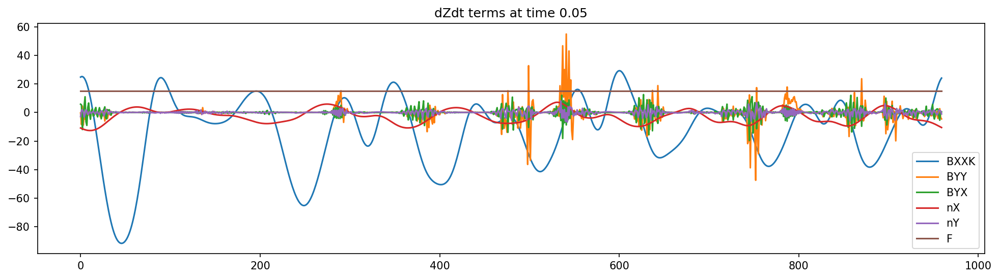

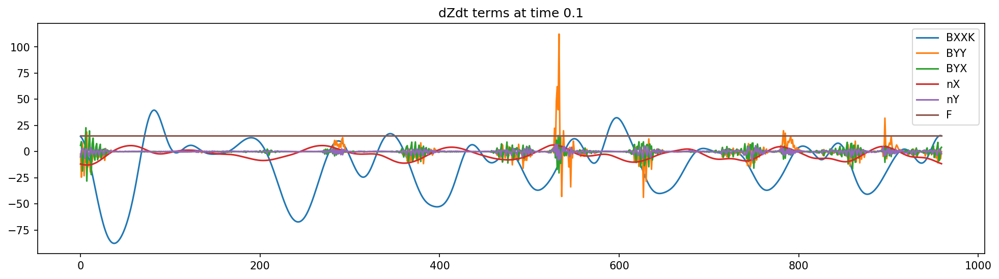

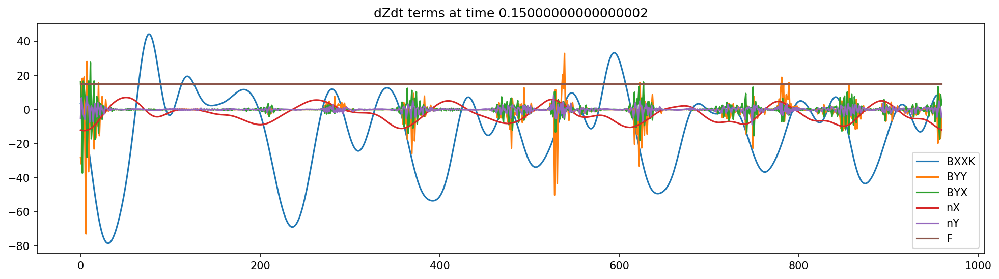

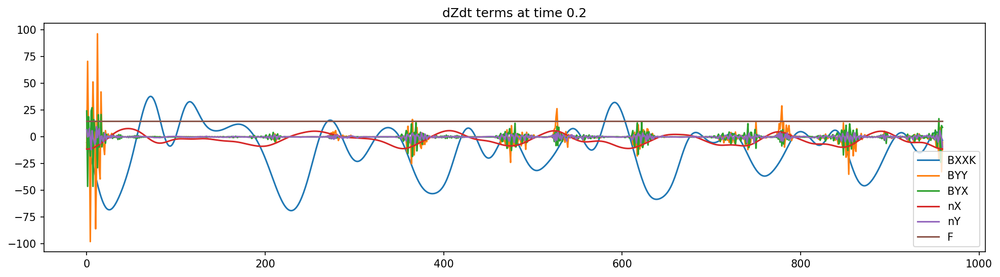

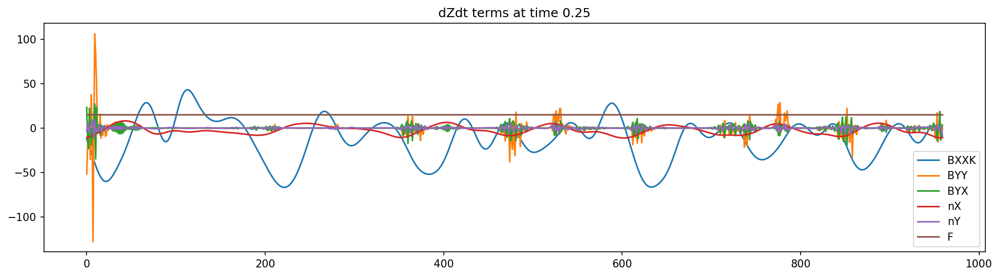

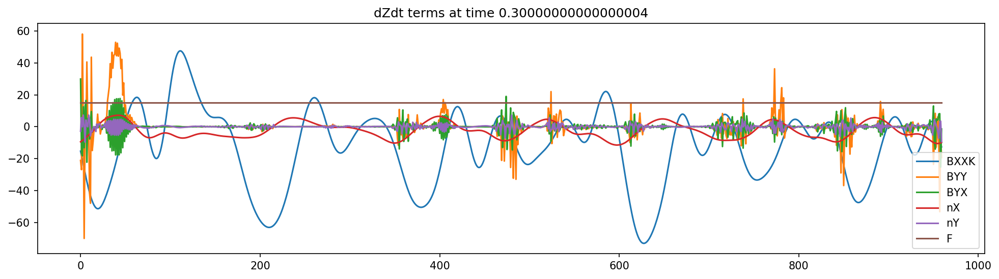

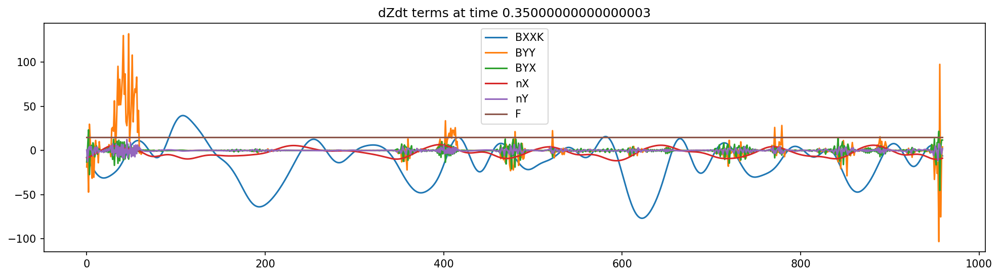

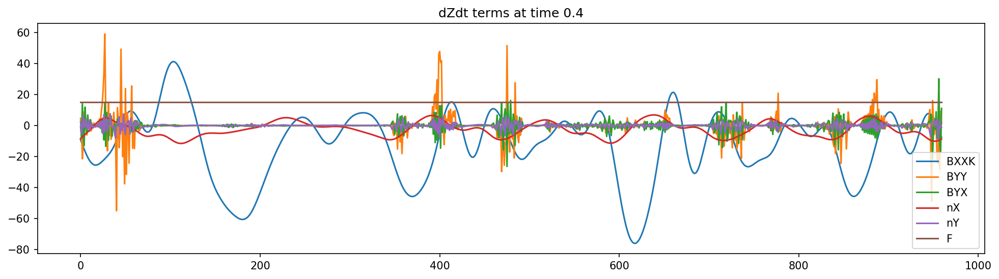

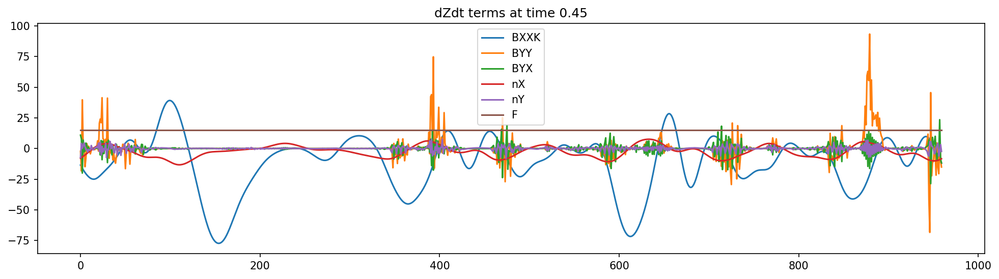

In [321]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F * np.ones(N_Z))
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['BXXK', 'BYY', 'BYX', 'nX', 'nY', 'F'])

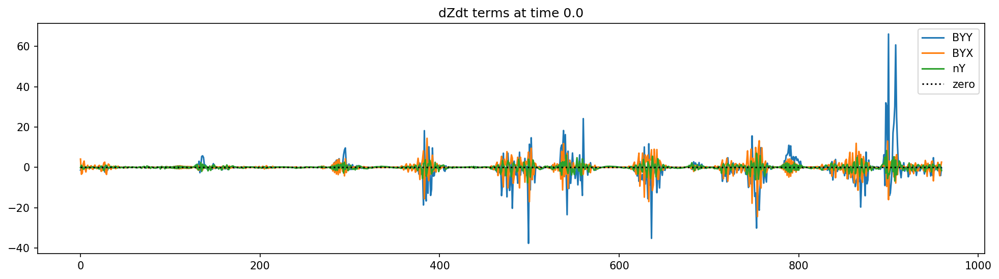

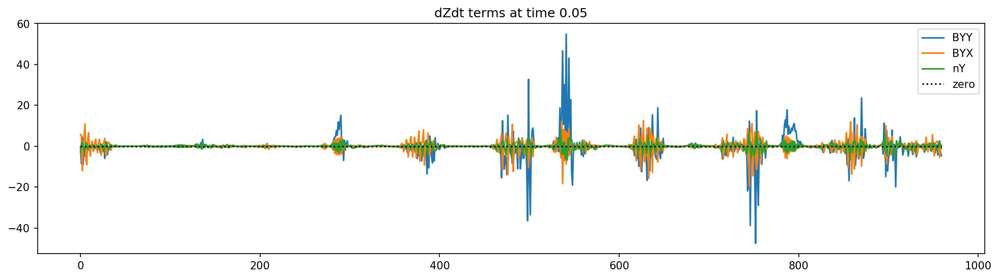

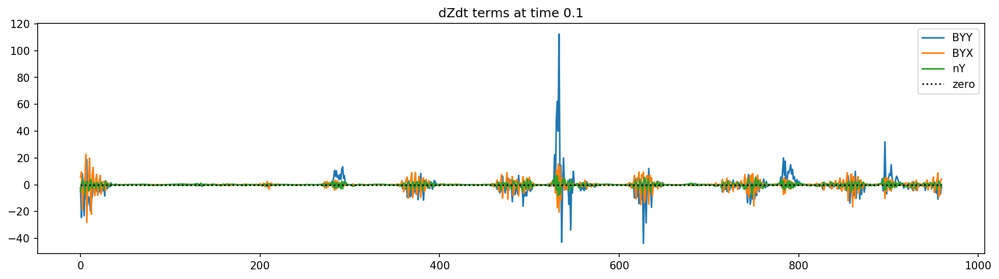

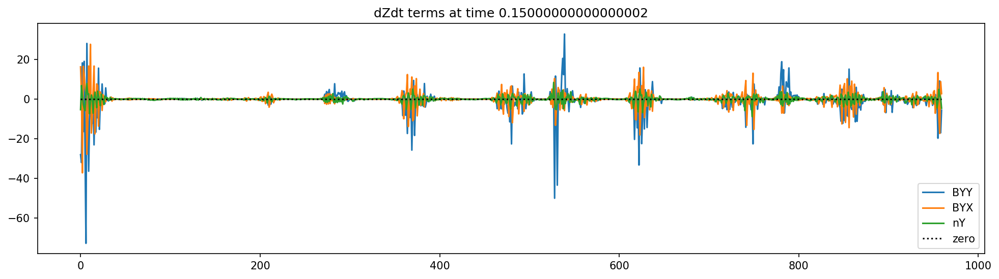

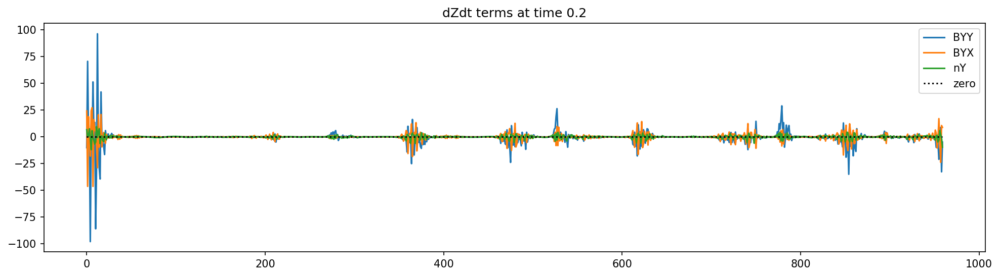

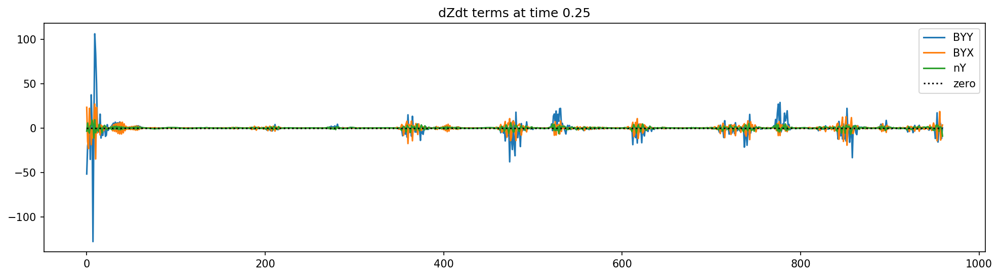

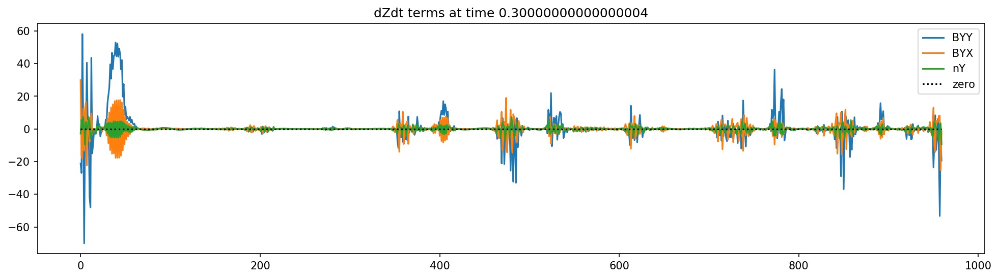

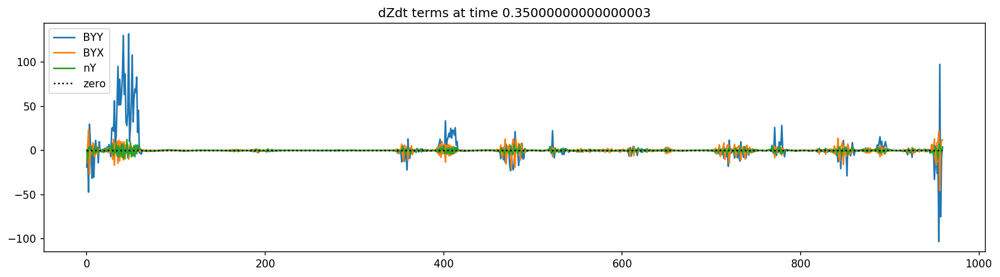

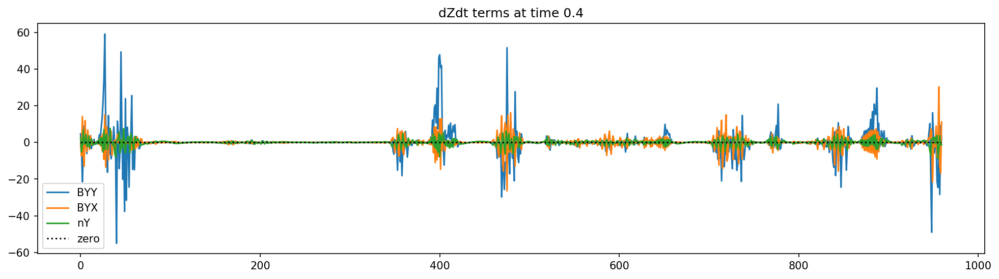

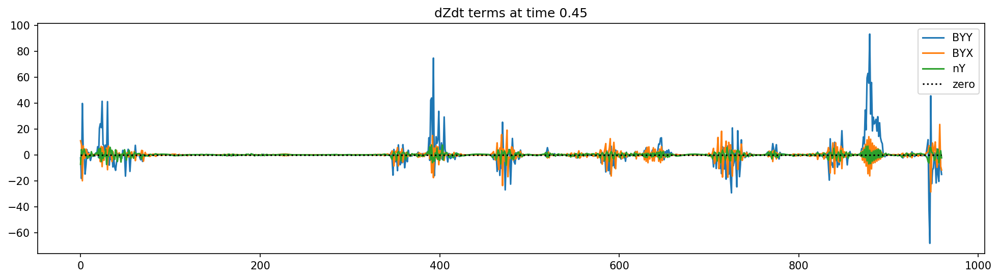

In [322]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(np.zeros(N_Z), 'k:')
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['BYY', 'BYX', 'nY', 'zero'])

In [323]:
wBYY = window_sum_Z(BYY, I=I, alpha=alpha, beta=beta)
wBYX = window_sum_Z(BYX, I=I, alpha=alpha, beta=beta)
wnY = window_sum_Z(nY, I=I, alpha=alpha, beta=beta)

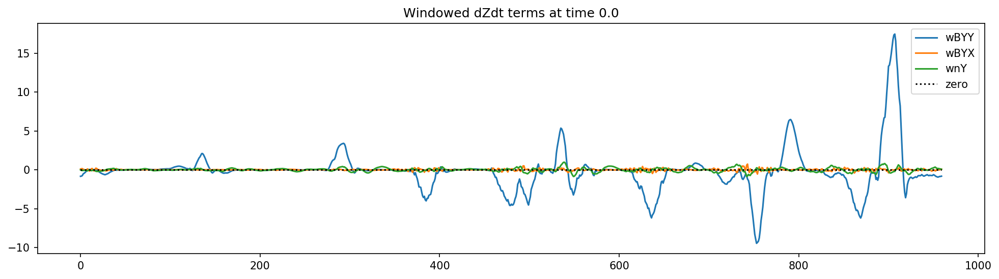

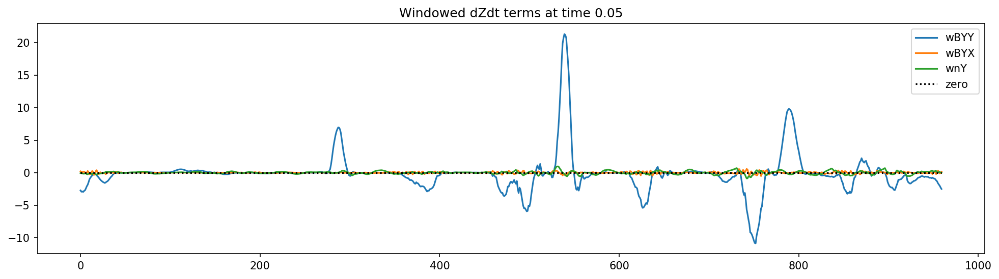

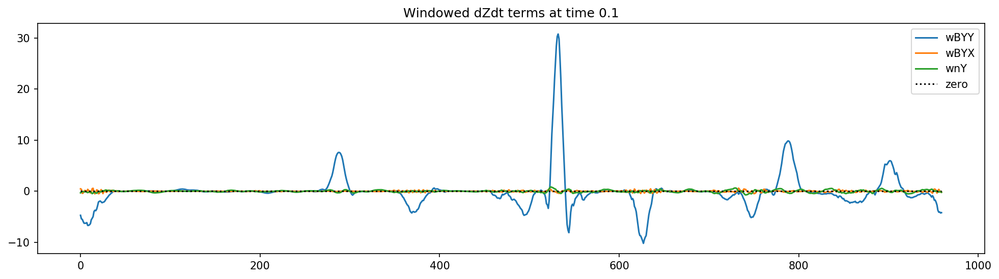

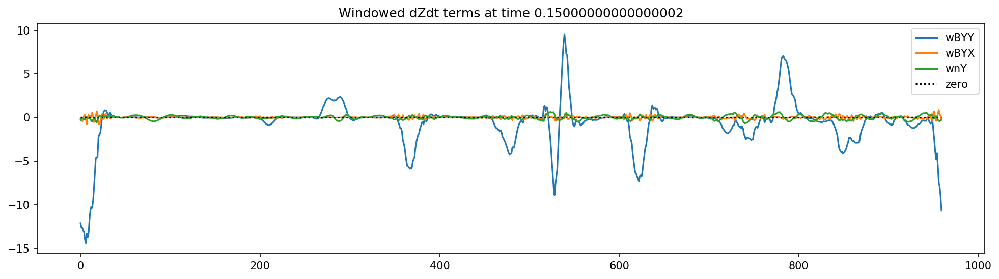

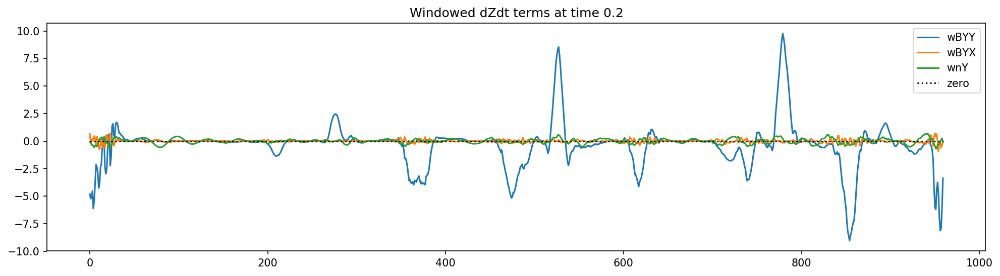

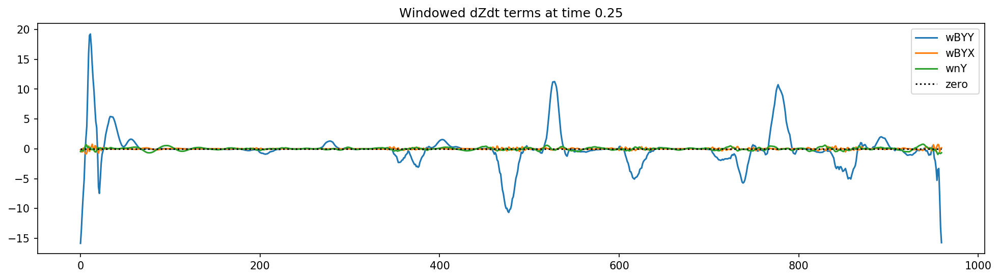

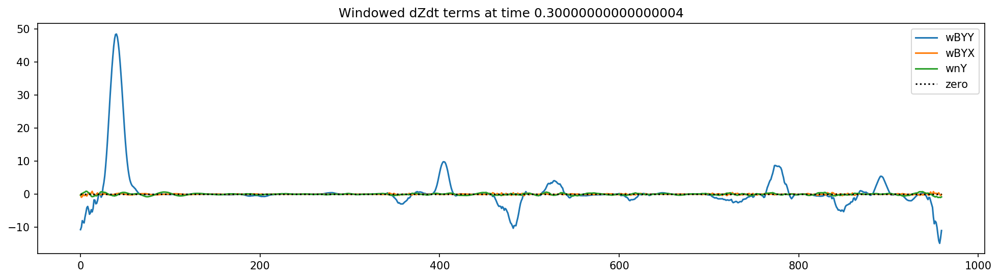

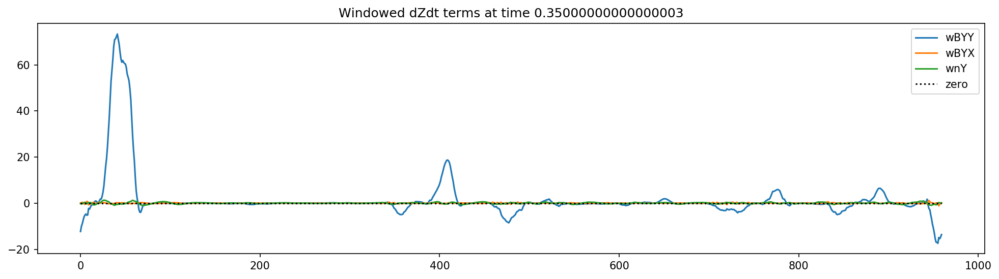

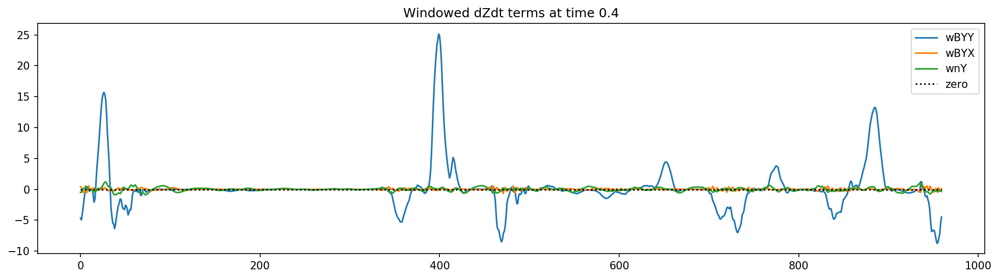

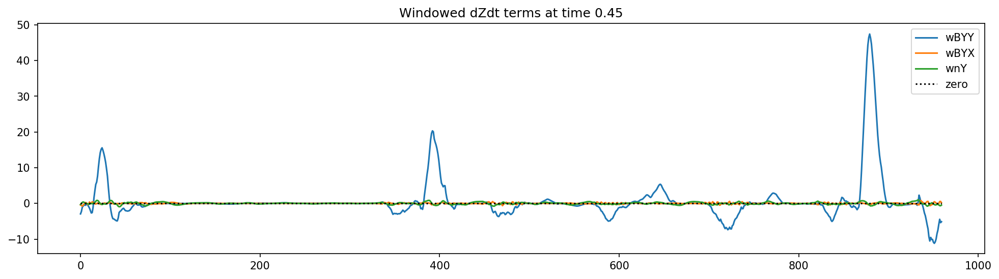

In [324]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(wBYY[:, ii])
    plt.plot(wBYX[:, ii])
    plt.plot(wnY[:, ii])
    plt.plot(np.zeros(N_Z), 'k:')
    plt.title(f'Windowed dZdt terms at time {t[ii]}')
    plt.legend(['wBYY', 'wBYX', 'wnY', 'zero'])

Text(0,0.5,'Windowed BYY')

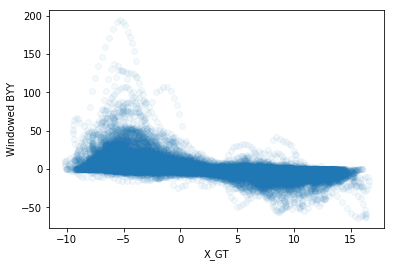

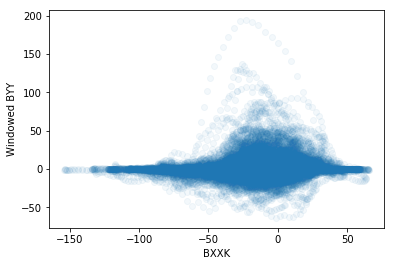

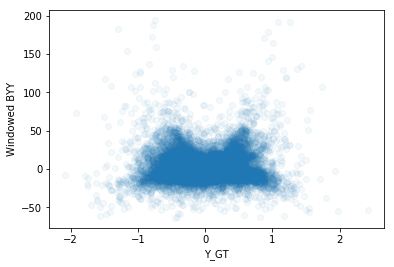

In [325]:
plt.figure()
plt.scatter(X_GT[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('X_GT')
plt.ylabel('Windowed BYY')

plt.figure()
plt.scatter(BXXK[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('BXXK')
plt.ylabel('Windowed BYY')

plt.figure()
plt.scatter(Y_GT[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('Y_GT')
plt.ylabel('Windowed BYY')

Text(0,0.5,'BYY')

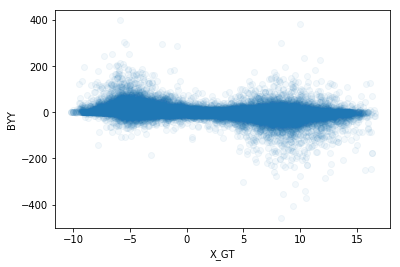

In [326]:
plt.figure()
plt.scatter(X_GT[:, ::100], BYY[:, ::100], alpha=.05)
plt.xlabel('X_GT')
plt.ylabel('BYY')